# Building Neuron Tensors
Resources that have been useful:
* [key resource] Stanford tutorial: https://cs231n.github.io/convolutional-networks/
* [key resource] Stackexchange that makes all this clear with a simple example: https://stackoverflow.com/questions/52272592/how-many-neurons-does-the-cnn-input-layer-have
----
* https://adeshpande3.github.io/A-Beginner%27s-Guide-To-Understanding-Convolutional-Neural-Networks/
* https://adeshpande3.github.io/A-Beginner%27s-Guide-To-Understanding-Convolutional-Neural-Networks-Part-2/
* https://stanford.edu/~shervine/teaching/cs-230/cheatsheet-convolutional-neural-networks
* https://hackernoon.com/learning-keras-by-implementing-vgg16-from-scratch-d036733f2d5

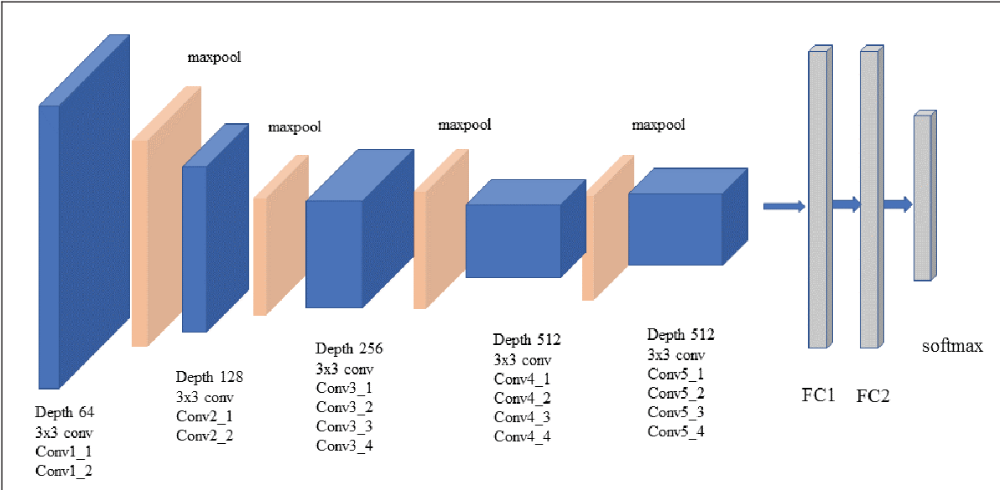

In [1]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.python.keras.layers import InputLayer, Input
from keras.models import Model
from keras.layers import Dense
from keras.layers import Flatten
from tensorflow.python.keras import backend as K
import math
import pathlib
import datetime
from scipy.io import savemat
from scipy.io import loadmat 
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
import time

In [ ]:
!pip install git+https://github.com/ahwillia/tensortools
import tensortools as tt
from scipy.ndimage import gaussian_filter

  Cloning https://github.com/ahwillia/tensortools to /tmp/pip-req-build-l1cxn0sb
  Running command git clone -q https://github.com/ahwillia/tensortools /tmp/pip-req-build-l1cxn0sb
  Created wheel for tensortools: filename=tensortools-0.3-py3-none-any.whl size=47993 sha256=ae10b4b201c9e5acda1c46432dc63f3fa419ea374515cd1c1c45aae8242054d4
  Stored in directory: /tmp/pip-ephem-wheel-cache-hlu5vrmv/wheels/1c/a5/81/96b292bf9d9e3e00a29f59864a212f082de8221f254a82e159
Successfully built tensortools


In [ ]:
import numpy as np
import torch
import random
import os

default_seed = 4142 
def seed_everything(seed = 1234):
  random.seed(seed)
  tseed = random.randint(1,1E6)
  tcseed = random.randint(1,1E6)
  npseed = random.randint(1,1E6)
  ospyseed = random.randint(1,1E6)
  torch.manual_seed(tseed)
  torch.cuda.manual_seed_all(tcseed)
  np.random.seed(npseed)
  os.environ['PYTHONHASHSEED'] = str(ospyseed)

seed_everything(default_seed)

* load a pre-trained network (VGG16)
* input images from CIFAR-10 to VGG16
* choose some random unit in one of the layers and plot its activity for different images

## Load VGG16 model

In [ ]:
from keras.applications.vgg16 import VGG16
MAX_SIZE = 64
VGG16_Model = VGG16(include_top=False, weights='imagenet',input_shape=(MAX_SIZE, MAX_SIZE, 3))
VGG16_Model.summary()

58900480/58889256 [==============================] - 0s 0us/step
Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 64, 64, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 64, 64, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 32, 32, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 32, 32, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 32, 32, 128)       147584    
                                                              

In [ ]:
# add new classifier layers
flat1 = Flatten()(VGG16_Model.layers[-1].output)
class1 = Dense(1024, activation='relu')(flat1)
output = Dense(10, activation='softmax')(class1)
VGG16_Model = Model(inputs=VGG16_Model.inputs, outputs=output)

In [ ]:
VGG16_Model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 64, 64, 3)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 64, 64, 64)        1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 64, 64, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 32, 32, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 32, 32, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 32, 32, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 16, 16, 128)       0     

In [ ]:
from google.colab import drive 
drive.mount('/content/drive/')
%cd '/content/drive/My Drive/Embeddings/code'

Mounted at /content/drive/
/content/drive/My Drive/Embeddings/code


# Get images:

     |████████████████████████████████| 2.1 MB 23.7 MB/s 
  Attempting uninstall: pip
    Found existing installation: pip 21.1.3
    Uninstalling pip-21.1.3:
      Successfully uninstalled pip-21.1.3
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 53.8 MB/s eta 0:00:00
  Attempting uninstall: Pillow
    Found existing installation: Pillow 7.1.2
    Uninstalling Pillow-7.1.2:
      Successfully uninstalled Pillow-7.1.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
albumentations 0.1.12 requires imgaug<0.2.7,>=0.2.5, but you have imgaug 0.2.9 which is incompatible.
(20, 64, 64, 3)


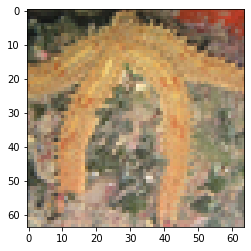

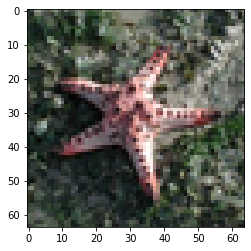

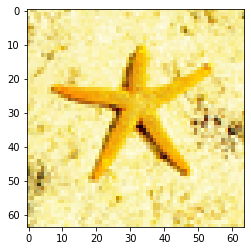

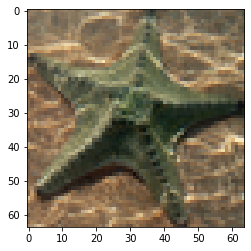

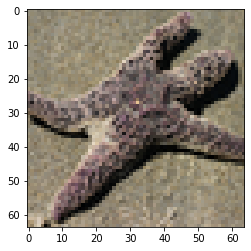

...

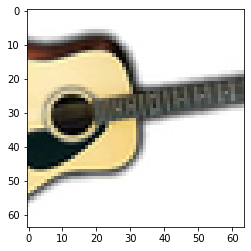

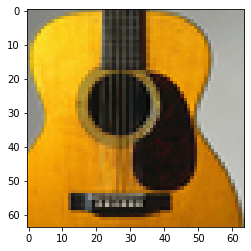

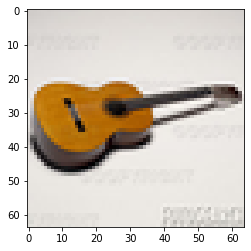

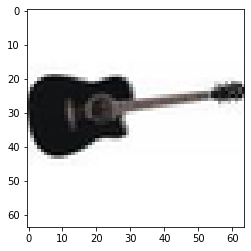

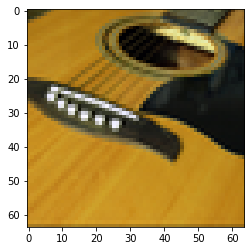

In [ ]:
!python3 -m pip install --upgrade pip
!python3 -m pip install --upgrade Pillow
from PIL import Image, ImageTk
img_array_starfish = np.load('imgnet_starfish.npy')
img_array_strawberry = np.load('imgnet_strawberry.npy')
img_array_husky = np.load('imgnet_husky.npy')
img_array_guitar = np.load('imgnet_guitar.npy')

def get_images_selected_classes(num_images, n_classes):
  images_selected_classes = []
  MAX_SIZE = 64
  for i in range(int(num_images/n_classes)):
    im = Image.fromarray(img_array_starfish[i,:,:,:].astype(np.uint8))
    im.thumbnail((MAX_SIZE, MAX_SIZE), Image.ANTIALIAS)
    images_selected_classes.append(np.array(im))
  for i in range(int(num_images/n_classes)):
    im = Image.fromarray(img_array_strawberry[i,:,:,:].astype(np.uint8))
    im.thumbnail((MAX_SIZE, MAX_SIZE), Image.ANTIALIAS)
    images_selected_classes.append(np.array(im))
  for i in range(int(num_images/n_classes)):
    im = Image.fromarray(img_array_husky[i,:,:,:].astype(np.uint8))
    im.thumbnail((MAX_SIZE, MAX_SIZE), Image.ANTIALIAS)
    images_selected_classes.append(np.array(im))
  for i in range(int(num_images/n_classes)):
    im = Image.fromarray(img_array_guitar[i,:,:,:].astype(np.uint8))
    im.thumbnail((MAX_SIZE, MAX_SIZE), Image.ANTIALIAS)
    images_selected_classes.append(np.array(im))
  ##  (#images, #nrow, #ncol, #channels) 
  images_selected_classes = np.array(images_selected_classes)
  
  return images_selected_classes

num_images = 20
n_classes = 4
images_selected_classes = get_images_selected_classes(num_images, n_classes)
print(images_selected_classes.shape)
for i in range(20):
  plt.imshow(images_selected_classes[i])
  plt.show()

In [ ]:
images_selected_classes.shape

(20, 64, 64, 3)

# Create 3D neuron tensor: 

In [ ]:
def apply_all_shifts(im, shift_step):
    '''
    arg(s): 
        DEBUG NOTE: PYTORCH IS (#channels, rows, cols)!!
        im, an image of shape (3, im_size, im_size)
    return: 
        im_all_shifts, a list of all shifted images from the input image
        n_shifts, number of shifted images
    '''
    
    ## vertical size might not be the same as the horizontal, note that the channel for tf and pytorch are in different dimension
    im_size_vertical = im.shape[0]
    im_size_horizontal = im.shape[1]
    
    n_shifts_vertical = int(math.ceil(im_size_vertical/ shift_step))
    n_shifts_horizontal = int(math.ceil(im_size_horizontal/ shift_step))
    n_shifts = n_shifts_vertical * n_shifts_horizontal + 1

    im_all_shifts = []
    # start with the unshifted im
    im_shift = im
    im_all_shifts.append(im)
    for i in range(n_shifts_vertical):
        ## for pytorch axis = 1, for tensorflow axis = 0
        im_shift = np.roll(im_shift, shift = shift_step, axis=0)
        im_all_shifts.append(im_shift)
        for j in range(n_shifts_horizontal):
            ## for pytorch axis = 2, for tensorflow axis = 1
            im_shift = np.roll(im_shift, shift = shift_step, axis=1)
            im_all_shifts.append(im_shift)
            
    im_all_shifts =  np.array(im_all_shifts)
    return im_all_shifts, n_shifts

Note: 
output size = [(W−K+2P)/S]+1 = (128-3)/3+1 = ~43

e.g. conv_layer
W is the input volume - 128
K is the Kernel size - 3
P is the padding - 0
S is the stride - 3

edge_neuron = floor(filter_size /stride) = floor(3/3) = 1

In [ ]:
def compute_neuron_output(model, layer_indices, im_all_shifts,  max_indices = None, n_max_feature_maps = 5, plot_activity = False):

    '''
    arg(s):
        layer_names: list of strings indicating the names of the layers we want to take neuron outputs from
        im_all_shifts: all shifts of one particular image in the for loop
    return:
        
    '''
    print(im_all_shifts.shape)
    n_shifts = im_all_shifts.shape[0]
    n_layers = len(layer_indices)
    neuron_output_highest = []
    all_fm_avg = []
    im_all_shifts = np.array(im_all_shifts)
    
    is_first_layer = True
    for layer_index in layer_indices:
        layer = model.layers[layer_index] 
        
        # check for convolutional layer
        if 'conv' not in layer.name:
            continue
        
        ## note: always take the images as inputs
        output_layer = K.function(inputs=[model.layers[1].input], 
                              outputs=[layer.output])
        
        ## output is n feature maps
        neuron_output = output_layer(im_all_shifts)[0]

        ## number of neurons is nrow * ncol * n_feature_maps
        n_shifts, n_row, n_col, n_feature_maps = neuron_output.shape[:]
        
        ## remove the neurons at the edges
 
        # filter_size = 3
        # shift_step = 3
        # edge_neuron = math.floor(filter_size / shift_step)
        edge_neuron = int(0.1 * n_row)
        neuron_output = neuron_output[:, edge_neuron:(n_row - edge_neuron), edge_neuron:(n_col - edge_neuron),:]
        n_shifts, n_row, n_col, n_feature_maps = neuron_output.shape[:]
        neuron_output = neuron_output.reshape((n_shifts, n_row * n_col, n_feature_maps))
        
        ## number of neurons for each feature map is nrow * ncol
        n_neurons = n_row * n_col
        
        # neuron_index = np.empty((n_row,n_col),dtype=int)
        # index = 0
        # for i in range(n_row):
        #     for j in range(n_col):
        #         neuron_index[i, j] = index
        #         index += 1
                
        # ## obtain the index of the neurons at the edges
        # neuron_edge_index = np.hstack((neuron_index[[0,1,n_row-2,n_row-1],:].reshape((4*32,1)), neuron_index[:,[0,1,n_col-2,n_col-1]].reshape((4*32,1))))
        # neuron_edge_index = neuron_edge_index.reshape((256,1))
        

        # ## re-label the neurons at the edge with a different color
        # neuron_labels = []
        # for i in range(10):    
        #     neuron_labels = np.hstack((neuron_labels, [i] * n_neurons))
        #     neuron_labels = np.array(neuron_labels)
        #     neuron_labels[n_neurons * i + neuron_edge_index-1] = 15
        
        # neuron_output = neuron_output.reshape((n_shifts, n_neurons, n_feature_maps))
        
        ## transpose to organize by feature maps
        ## the shape of neuron_output_by_fm is (n_shifts, n_feature_maps, #neurons)
        neuron_output_by_fm = neuron_output.transpose(0, 2, 1)
        
        ## compute avg neuron firing rate in each feature map
        ## fm_avg is of shape (n_shifts, n_feature_maps)
        fm_avg = neuron_output_by_fm.sum(axis=2) / neuron_output_by_fm.shape[2]

        if is_first_layer is True: 
            fm_avg_all_layers = fm_avg
            neuron_output_by_fm_all_layers = neuron_output_by_fm
        else:
            fm_avg_all_layers = np.hstack((fm_avg_all_layers, fm_avg))
            neuron_output_by_fm_all_layers = np.concatenate((neuron_output_by_fm_all_layers,neuron_output_by_fm), axis = 1)
            is_first_layer = False

        if plot_activity == True:
            print("Current layer: " + layer.name)
            print("Indices of FM with highest average firing rate in response to each image: " )
            max_fm_ind = np.argmax(fm_avg,axis = 1)
            print(max_fm_ind)
            print("#neurons in the FM with highest average firing rate: " + str(n_row * n_col))
            print("Average activity for all feature maps in " + layer.name)
            plt.matshow(fm_avg)
            plt.show()
            print('----------------------------------------------------\n')

    neuron_output_highest = np.empty((n_shifts, n_max_feature_maps * n_neurons))
    feature_map_side = int(np.sqrt(n_neurons))
    for i in range(n_shifts):
        if max_indices is None:
            max_indices = np.argsort(-1*fm_avg_all_layers[i], axis = 0)[:n_max_feature_maps]
        temp = neuron_output_by_fm_all_layers[i, max_indices, :]
        neuron_output_highest[i] = neuron_output_by_fm_all_layers[i, max_indices, :].reshape((1, n_max_feature_maps * n_neurons))
        
        for f_i in range(n_max_feature_maps):
          normalizing_constant = temp[f_i, :].max()
          if normalizing_constant == 0:
            neuron_output_highest[i, (f_i*feature_map_side**2):((f_i+1)*feature_map_side**2)] = 0
          else:
            neuron_output_highest[i, (f_i*feature_map_side**2):((f_i+1)*feature_map_side**2)] /= normalizing_constant

    neuron_labels = []
    for i in range(n_max_feature_maps):
      neuron_labels += [i] * n_neurons
    neuron_labels = np.array(neuron_labels) 

    return neuron_output_highest, fm_avg_all_layers, neuron_labels, max_indices, n_neurons

In [ ]:
def show_stimuli_3D(model, layer_indices, images_selected_classes, shifts, max_indices, n_images_selected_classes, shift_step = 3, n_max_feature_maps = 5, plot_activity = False):
    '''
    arg(s): 
        layer_indices, interested layers
        images_selected_classes, all the selected images
        shifts = True/False
    return:
        neuron_output_shifts_avg, (n_images, n_neurons)
    '''

    if shifts is False:
        neuron_output_highest_final, fm_avg_all_layers, neuron_labels, max_indices, n_neurons = compute_neuron_output(
            model, layer_indices, images_selected_classes, max_indices, n_max_feature_maps, plot_activity)
  
    else: 
        # generate shifts for each selected image and then stack: 
        neuron_output_highest_with_shifts = []
        for i in range(n_images_selected_classes):
            im = images_selected_classes[i]
            im_all_shifts, n_shifts =  apply_all_shifts(im, shift_step)
            im_all_shifts = torch.Tensor(im_all_shifts)
            
            ## neuron_output_highest is of shape (n_shifts, n_neurons * n_max_feature_maps)
            neuron_output_highest, fm_avg_all_layers, neuron_labels, max_indices, n_neurons = compute_neuron_output(
                model, layer_indices, im_all_shifts, max_indices, n_max_feature_maps, plot_activity)
        
            ## instead of taking average, we create a dimension for all shifts (analogous to the time dimension)

            neuron_output_highest_with_shifts.append(neuron_output_highest)

            fm_shifts_avg = fm_avg_all_layers.sum(axis=0) / fm_avg_all_layers.shape[0]
            fm_shifts_avg = fm_shifts_avg.reshape((1,fm_shifts_avg.shape[0]))
            
            if i == 0:
                fm_avg_all_layers_with_shifts = fm_shifts_avg
            else:
                fm_avg_all_layers_with_shifts = np.vstack((fm_avg_all_layers_with_shifts, fm_shifts_avg))
        
        ## out of for loop!      
        ## neuron_output_highest_with_shifts is of shape (n_images_selected_classes, n_shifts, n_neurons * n_max_feature_maps)
        neuron_output_highest_with_shifts = np.array(neuron_output_highest_with_shifts)
        neuron_output_highest_final = neuron_output_highest_with_shifts
        fm_avg_all_layers = fm_avg_all_layers_with_shifts
 
    return neuron_output_highest_final, fm_avg_all_layers, neuron_labels, max_indices

In [ ]:
neuron_output_highest_with_shifts, fm_avg_all_layers_with_shifts, neuron_labels, max_indices = show_stimuli_3D(
    VGG16_Model, range(2), images_selected_classes, shifts = True,  max_indices = None, n_images_selected_classes = num_images, n_max_feature_maps=5, plot_activity = False)

torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])


In [ ]:
neuron_output_highest_with_shifts.shape

(20, 507, 13520)

In [ ]:
data = np.transpose(neuron_output_highest_with_shifts, (2, 0, 1))
from scipy.io import savemat
mdic = {"neuron_output_3D": data}
mdic
savemat("neuron_output_3D_vgg_block1.mat", mdic)

In [ ]:
data.shape

(13520, 20, 507)

In [ ]:
neuron_output_highest_with_shifts, fm_avg_all_layers_with_shifts, neuron_labels, max_indices = show_stimuli_3D(
    VGG16_Model, range(7,11), images_selected_classes, shifts = True,  max_indices = None, n_images_selected_classes = num_images, n_max_feature_maps=5, plot_activity = False)

torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])
torch.Size([507, 64, 64, 3])


In [ ]:
data = np.transpose(neuron_output_highest_with_shifts, (2, 0, 1))
from scipy.io import savemat
mdic = {"neuron_output_3D": data}
mdic
savemat("neuron_output_3D_vgg_block3.mat", mdic)

In [ ]:
data.shape

(980, 20, 507)


484 is the number of shifts = 22 * 22
5 is the number of selected images
19220 = 5 * 62 * 62 , where 5 is the number of feature maps and 62 is the number of neurons

# Create 2D neuron tensor:

In [ ]:
def show_stimuli_2D(model, layer_indices, images_selected_classes, shifts, max_indices, n_images_selected_classes, shift_step = 3, n_max_feature_maps = 5, plot_activity = False):
    '''
    arg(s): 
        layer_indices, interested layers
        images_selected_classes, all the selected images
        shifts = True/False
    return:
        neuron_output_shifts_avg, (n_images, n_neurons)
    '''

    if shifts is False:
        neuron_output_highest_final, fm_avg_all_layers, neuron_labels, max_indices, n_neurons = compute_neuron_output(
            model, layer_indices, images_selected_classes, max_indices, n_max_feature_maps, plot_activity) 
  
  
    else: 
        # generate shifts for each selected image and then stack: 
        neuron_output_highest_with_shifts = []
        for i in range(n_images_selected_classes):
            im = images_selected_classes[i]
            im_all_shifts, n_shifts =  apply_all_shifts(im, shift_step)
            im_all_shifts = torch.Tensor(im_all_shifts)
            
            ## neuron_output_highest is of shape (n_shifts, n_neurons * n_max_feature_maps)
            neuron_output_highest, fm_avg_all_layers, neuron_labels, max_indices, n_neurons = compute_neuron_output(
                model, layer_indices, im_all_shifts, max_indices, n_max_feature_maps, plot_activity) 
  

            ## take the average over all shifts of im
            neuron_output_highest_shifts_avg = neuron_output_highest.sum(axis=0) / neuron_output_highest.shape[0] 
            neuron_output_highest_shifts_avg = neuron_output_highest_shifts_avg.reshape((1, neuron_output_highest_shifts_avg.shape[0]))


            fm_shifts_avg = fm_avg_all_layers.sum(axis=0) / fm_avg_all_layers.shape[0]
            fm_shifts_avg = fm_shifts_avg.reshape((1,fm_shifts_avg.shape[0]))
            
            if i == 0:
              neuron_output_highest_with_shifts = neuron_output_highest_shifts_avg 
              fm_avg_all_layers_with_shifts = fm_shifts_avg
            else:
              neuron_output_highest_with_shifts = np.vstack((neuron_output_highest_with_shifts, neuron_output_highest_shifts_avg))
              fm_avg_all_layers_with_shifts = np.vstack((fm_avg_all_layers_with_shifts, fm_shifts_avg))
        
        ## out of for loop!      
        ## neuron_output_highest_with_shifts is of shape (n_images_selected_classes, n_neurons * n_max_feature_maps)
        neuron_output_highest_with_shifts = np.array(neuron_output_highest_with_shifts)
        neuron_output_highest_final = neuron_output_highest_with_shifts
        fm_avg_all_layers = fm_avg_all_layers_with_shifts
 
    return neuron_output_highest_final, fm_avg_all_layers, neuron_labels, max_indices

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 3

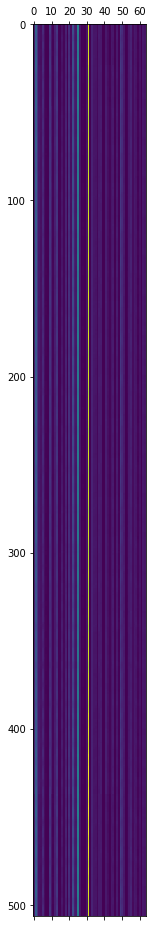

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 3

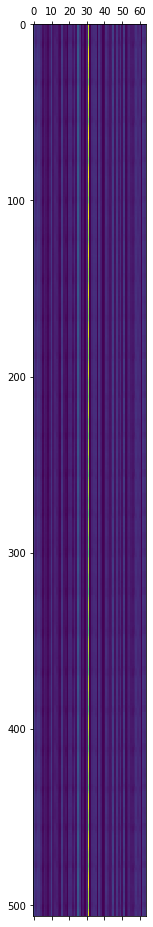

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 3

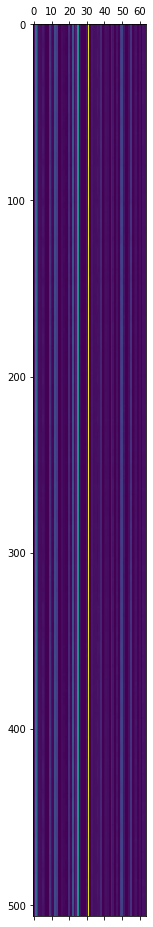

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 3

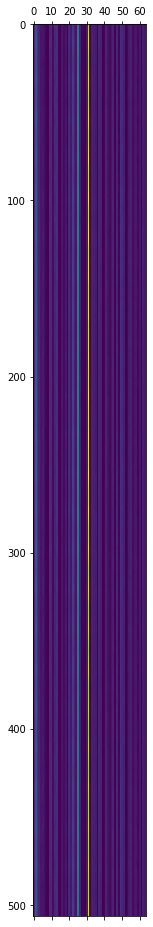

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 3

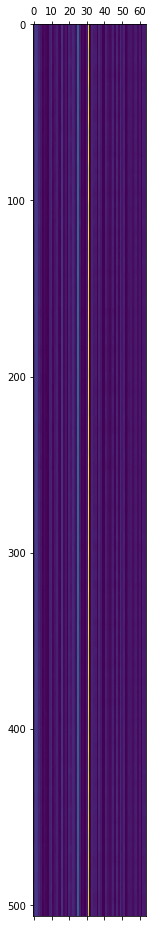

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 3

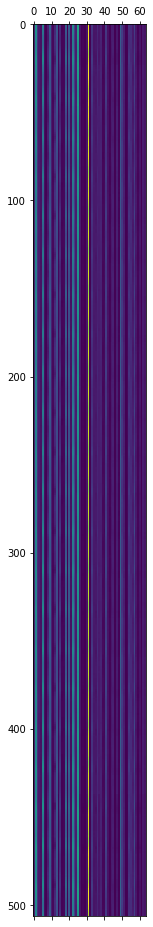

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 3

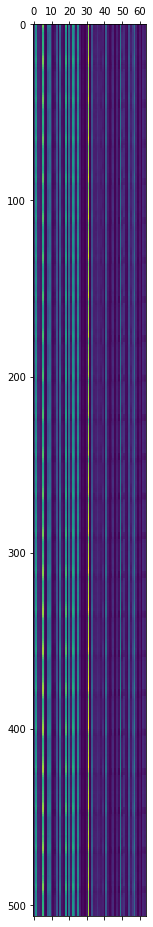

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 3

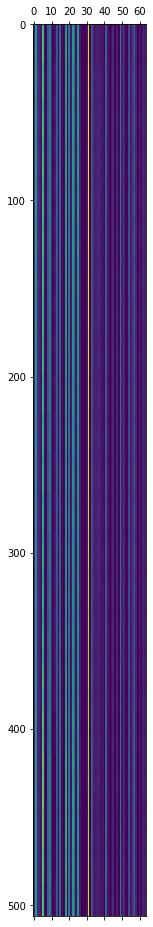

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 3

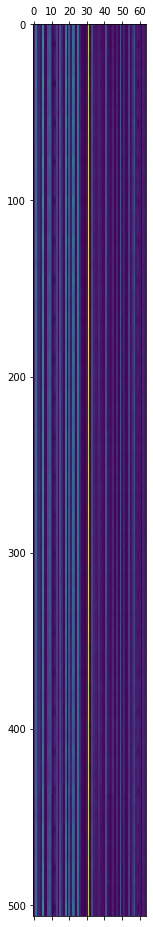

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 3

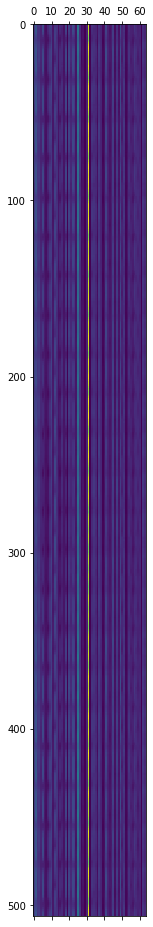

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 3

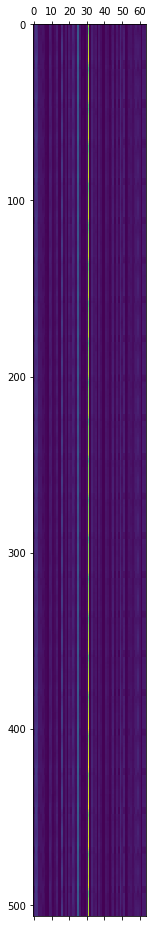

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 3

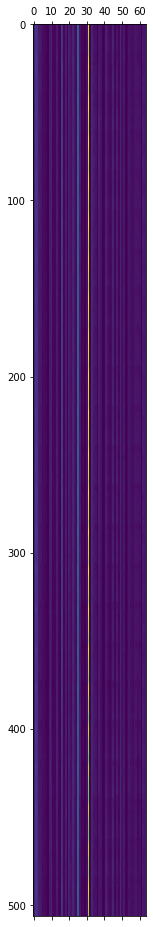

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 3

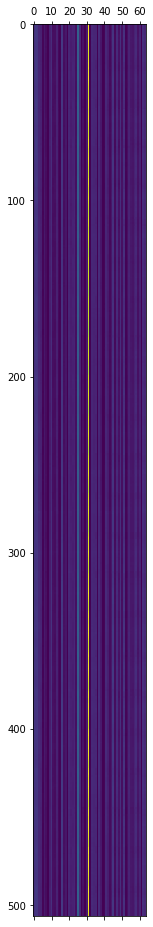

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 3

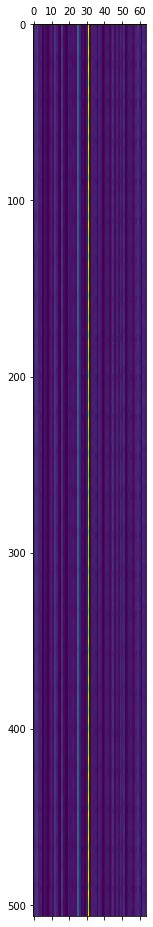

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 3

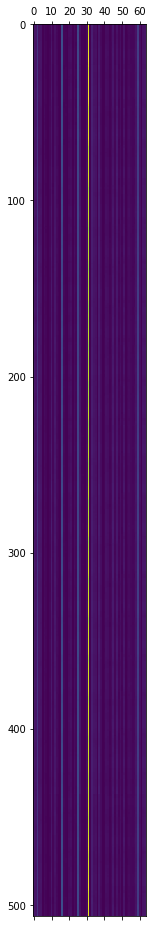

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 3

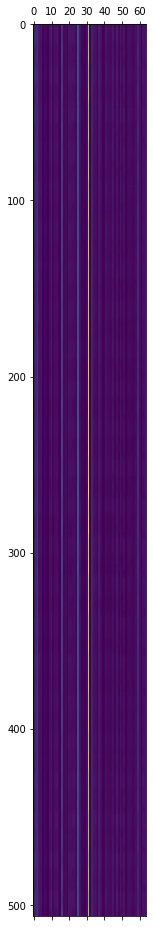

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 3

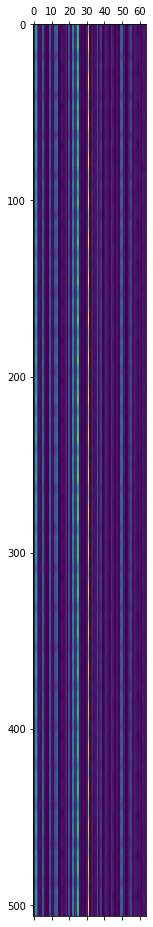

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 3

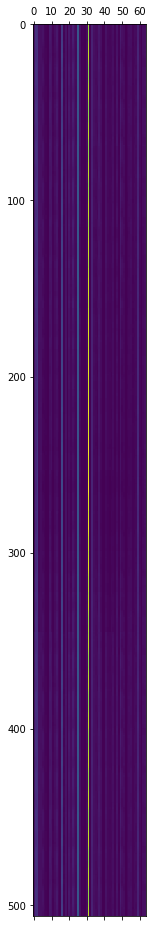

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 3

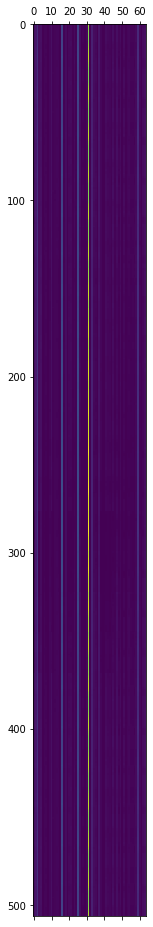

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block1_conv1
Indices of FM with highest average firing rate in response to each image: 
[31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31 31
 31 31 31 3

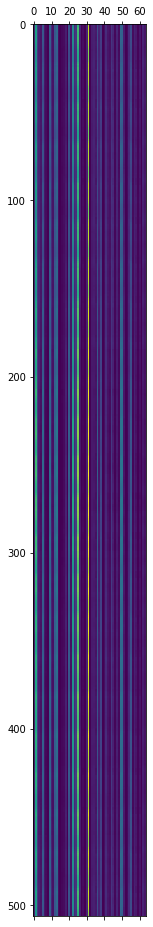

----------------------------------------------------



In [ ]:
neuron_output_highest_with_shifts, fm_avg_all_layers_with_shifts, neuron_labels, max_indices = show_stimuli_2D(
    VGG16_Model, range(2), images_selected_classes, shifts = True,  max_indices = None, n_images_selected_classes = num_images, n_max_feature_maps=5, plot_activity = True)

In [ ]:
neuron_output_highest_with_shifts.shape

(20, 13520)

In [ ]:
data = np.transpose(neuron_output_highest_with_shifts, (1,0))
from scipy.io import savemat
mdic = {"neuron_output_2D": data}
mdic
savemat("neuron_output_2D_vgg_block1.mat", mdic)

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[201 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201
 201 201 201 218 201 201 201 201 201 218 201 201 201 201 201 218 201 201
 218 218 218 218 201 218 218 218 218 201 201 201 201 201 201 201 201 201
 201 201 201 201 201 218 218 201 201 201 218 218 201 201 201 201 201 201
 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201
 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201
 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201
 201 201 201 201 201 218 218 201 201 201 201 201 201 201 201 201 201 201
 201 201 201 201 218 201 201 201 201 218 218 218 218 201 201 201 201 201
 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201 218 201 201
 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201
 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201 201 

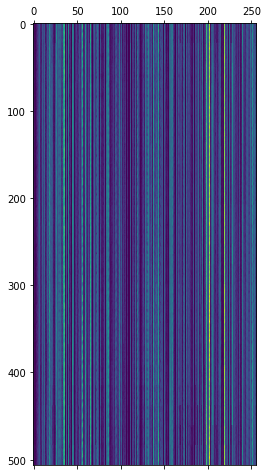

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 

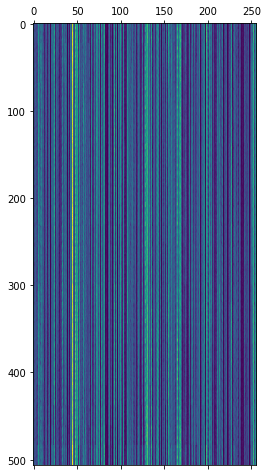

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246

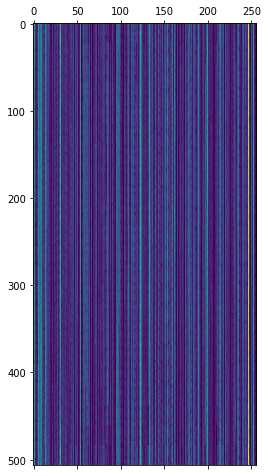

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 21

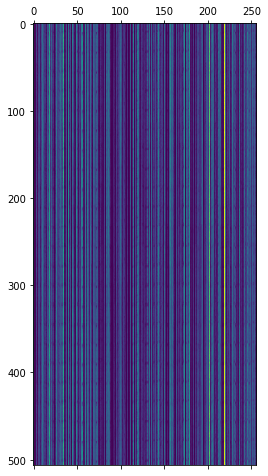

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[  8   8   8   8   8   8 241   8   8   8   8   8   8   8 241 130 130 130
 241 130 130 130   8   8   8   8   8   8   8   8   8   8   8   8   8   8
   8   8 130 130 198 130 130 130   8   8   8  49   8   8   8 241   8   8
   8   8   8   8   8  49 130 130 198 198 198 130 198 130  49 130   8   8
 241 241   8   8   8   8   8   8 241  49 198 130 198 198 198 198 198 198
 198   8 241   8   8   8   8   8   8   8   8   8   8   8   8 130 198 198
 198 198 198 198   8   8   8   8   8   8   8   8   8   8   8   8   8   8
   8   8   8   8   8 130   8   8   8   8   8   8   8   8   8   8   8   8
   8   8   8   8   8 130 130 130 130 130 130 130 130   8   8   8   8   8
   8   8   8   8   8   8   8   8   8   8   8  49   8   8  49  49   8   8
   8   8   8   8   8 241 241   8   8   8   8   8   8 241 241  49   8 241
 241 130   8   8 241   8   8   8 241   8

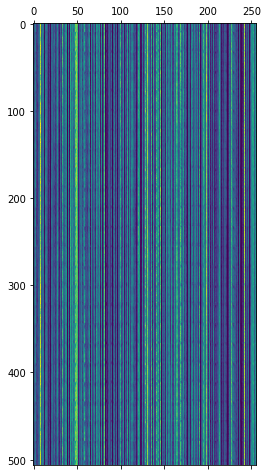

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 178
 252 178 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 252 178 178 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 178 252 178 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 252 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 252 252
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 252 252 252 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 252 252 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 178 252 252 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246

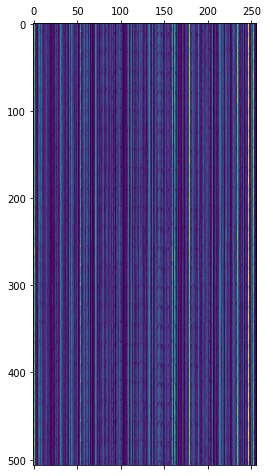

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 21

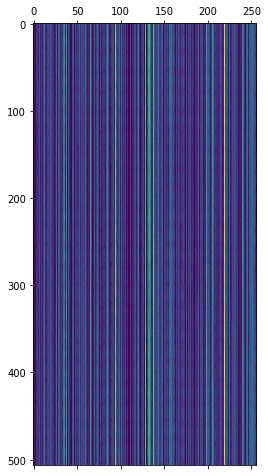

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[109 109 109 109 109 109 109 109 109 109  45 109 109 109 109 109 109 109
 109 109 109 109 109 109 109 109 109 109 109 109 109 109  45 109 109 109
 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109
  45 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109
 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109
 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109
 109 109 109 109 109 109 109 109 109 109 109 109  45  45  45 109 109 109
 109 109 109 109 109 109 109 109 109 109 109 109 109  45  45  45  45  45
  45  45 109 109 109 109 109 109 109 109 109 109 109 109 109 109 109  45
  45  45  45  45  45  45  45 227 109 109 109 109  45  45  45  45 109 109
  45  45  45  45  45  45  45  45  45  45 109 109 109 227 227 109 109 109
  45  45 109 109 109 109 109 109  45  45

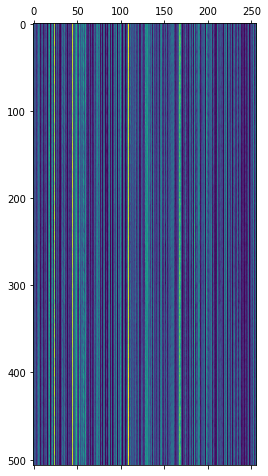

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[122 122 122 124 124 199 199 199 199 199 122 122 122 199 199 199 122 124
 124 124 122 122 122 122 122 122 124 124 124 199 199 199 122 122 122 199
 199 199 122 124 124 122 122 122 122 122 122 124 124 124 124 199 199 199
 122 122 122 122 199   3 124 124 124 124 124 124 124 124 124 124 124 124
 199 199 199 199 199 124 199 199 199 199 124 124 124 124 124 124 124 124
 124 124 124 124 124 124 199 199 199 124 199 199 199 124 124 124 124 124
 124 124 124 124 124 124 124 124 199 199 199 199 199 199 199 199 199 199
 199 199 199 124 124 199 199 124 124 124 124 199 199 199 199 199 199 199
 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199
 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 199 122 122
 122 199 199 199 199 199 199 199 122 122 122 122 199 199 199 122 122 122
 122 122 122 122 122 122 199 199 199 199

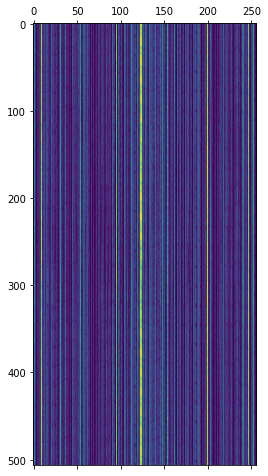

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 21

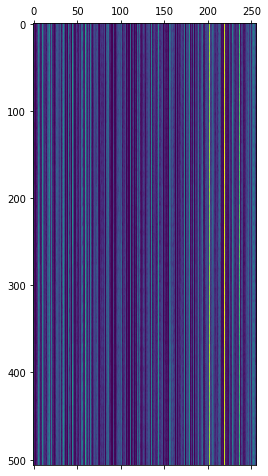

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241
 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241
 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241
 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241
 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241
 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241
 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241
 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241
 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241
 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241
 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241 241
 241 241 241 241 241 241 241 241 241 241

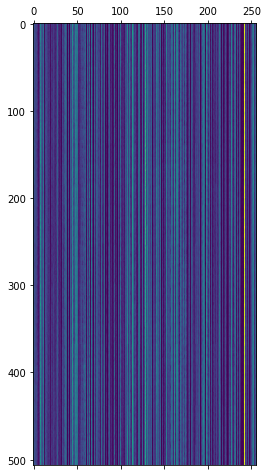

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246

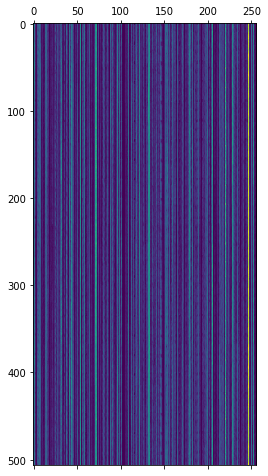

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[143 218 143 143 143 143 143 143   3   3   3 201   3   3   3 201 201 201
 201 201 143 143 218 143   3   3 143 218 218   3   3   3   3   3   3   3
   3   3 201   3   3   3   3   3   3   3 218 218 218 218 218 218   3 218
   3 218   3   3   3 201   3   3   3   3   3   3   3 218   3 218 218 218
 218 218 218 218 218 218 218 201 201 201 201 201 201 218 218 201 218 218
 218 218 218 218 218 218 218 218 218 218 201 201 201 201 201 218 218 218
 201 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 143 218 218
 143 143 143 143 143 143 218   3 218 218 143 218 218 143 143 143 143 143
 143 143 143 143 143 143 143 143 143 143 143 143 218 143 218 143 143 143
 143 143 14

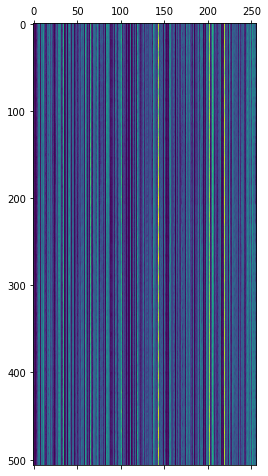

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 

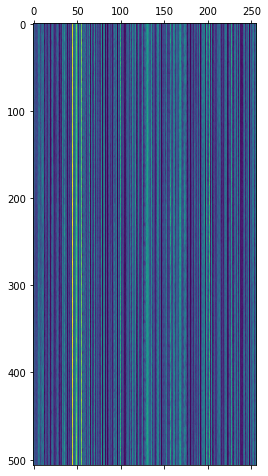

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[161 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161
 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161
 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161
 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161
 246 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161
 161 161 161 161 246 246 161 161 161 161 161 161 161 161 161 161 161 161
 161 161 161 161 161 161 161 161 161 246 161 161 161 161 161 161 161 161
 161 161 161 161 161 161 161 161 161 161 161 161 246 246 161 161 161 161
 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161 246 246
 246 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161 161
 161 161 246 246 161 161 161 161 161 161 161 161 161 161 161 161 161 161
 161 161 161 161 161 161 246 246 161 161

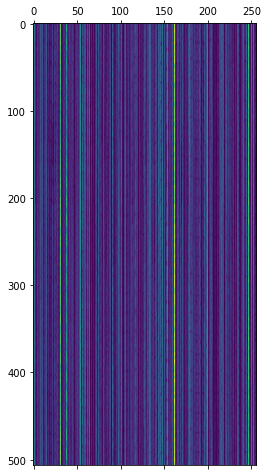

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 21

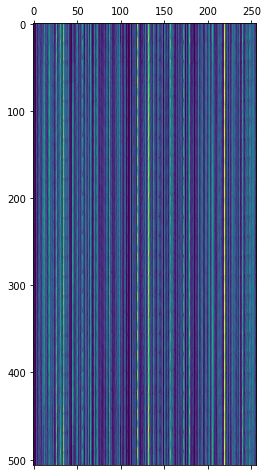

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 

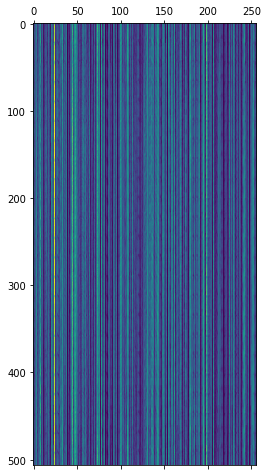

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[  9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9

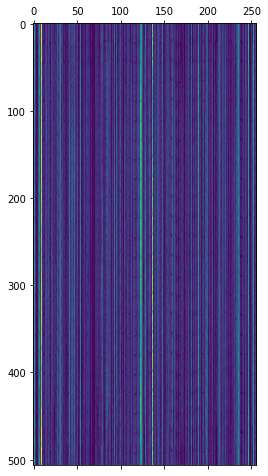

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[ 56 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132
 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132
 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132
 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132
 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132
 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132
 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132
 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132
 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132
 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132
 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132
 132 132 13

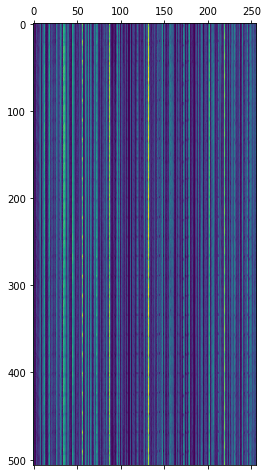

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[24 24 24  8  8 24 24 24 24 24 24 24 24 24 24  8 24 24 24 24 24 24 24 24
 24  8  8  8 24 24 24 24 24 24 24 24 24  8 24 24 24 24 24 24 24 24 24 24
  8  8 24 24 24 24 24 24 24 24 24 24  8 24 24 24 24 24 24 24 24  8  8  8
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24  8 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 

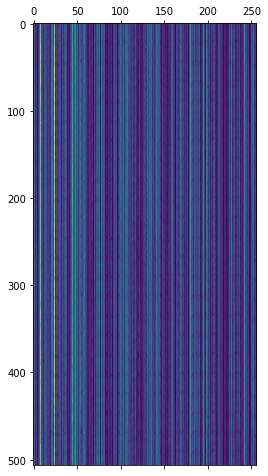

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9
 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9
 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9
 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9
 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9
 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9
 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9
 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9
 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9
 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9
 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9 9
 9 9 9 9 9 9 9 9 9

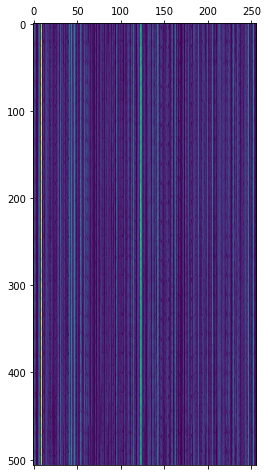

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 132 218 132 132 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 132 132 132 218 218 218 218 132 132 132 218 218 218
 218 218 218 218 218 218 218 218 218 218 132 218 218 218 218 132 218 132
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 21

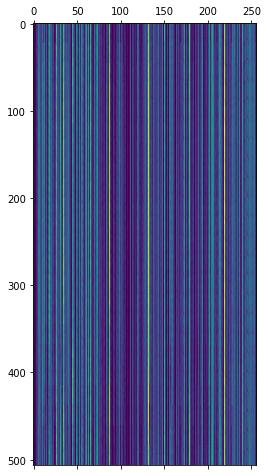

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[ 45  24  24  24  24 130 130  24  24  24  24  24 130 130 130  24 130 130
 130 130 130  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24
  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24
  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24
  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24
  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24
  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24
  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24
  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24
  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24
  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24  24
  24  24  24  24  24  24  24  24  24  24

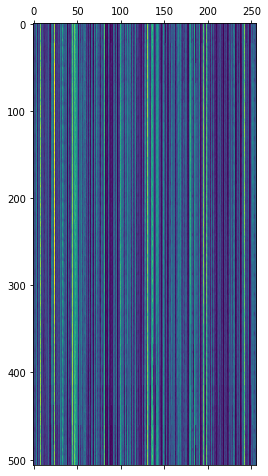

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[  9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9

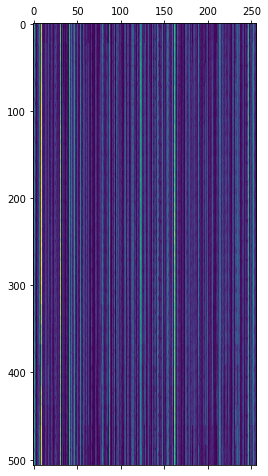

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[218 218 218 218 218 218 218 218 218 218 132 132 132 132 218 132 218 132
 132 132 218 218 218 218 218 218 218 218 218 218 218 218 218 132 132 132
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 132 132 132 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 132 132 132 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 132 132 132 132 132 218 218 132 132
 132 218 218 218 218 218 218 218 132 132 132 218 132 132 132 132 132 132
 132 132 132 132 132 132 218 218 218 132 132 132 132 132 132 132 132 132
 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132
 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132
 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132 132
 132 218 21

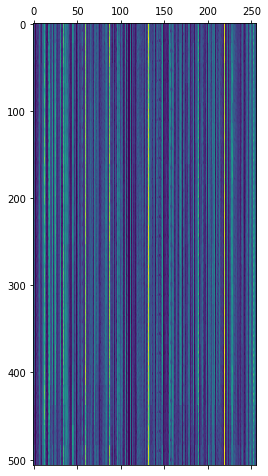

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24 24
 24 24 24 24 24 24 24 24 24 24 24 24 24 

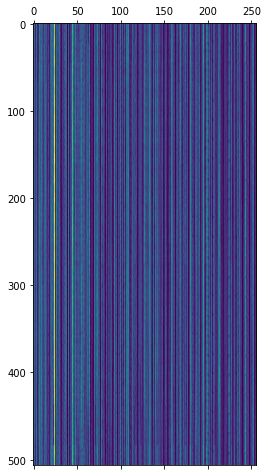

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[  9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9   9
   9   9   9   9   9   9   9   9   9   9

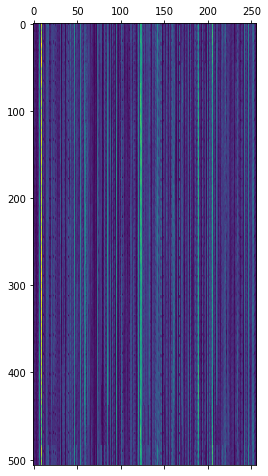

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 21

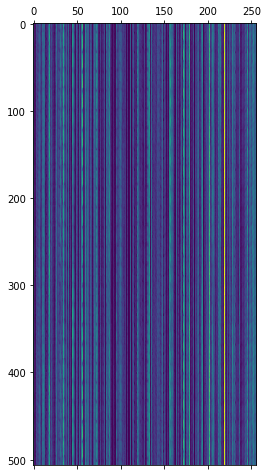

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[45 45 45  8  8  8  8  8 45 45 45 45  8  8  8  8  8  8  8  8  8 45 45 45
 45  8  8  8  8  8 45 45 45 45  8  8  8  8  8  8  8  8  8 45 45 45 45 45
 45  8  8  8 45 45 45 45 45  8  8  8  8  8  8  8 45 45 45 45 45  8 45  8
  8  8 45 45 45 45 45  8  8  8  8  8  8  8 45 45 45 45 45 45 45 45  8  8
  8 45 45 45 45 45  8  8  8  8  8  8  8 45 45 45 45 45 45  8  8  8  8  8
 45 45 45 45  8  8  8  8  8  8  8  8  8  8 45 45  8  8  8  8  8 45 45 45
 45 45  8  8  8  8  8  8  8  8  8 45 45 45  8 45  8  8  8  8 45 45 45 45
  8  8  8  8  8  8  8  8  8  8 45 45  8  8  8  8  8  8 45 45 45 45 45  8
  8  8  8  8  8  8  8 45 45 45 45  8  8  8  8 45  8 45 45 45  8  8  8  8
  8  8  8  8  8  8 45 45 45  8  8  8  8  8 45 45 45 45 45  8  8  8  8  8
  8  8  8 45 45 45 45 45 45  8  8  8 45 45 45 45 45  8  8  8  8  8  8  8
  8 45 45 45 45 45  8  8  8  8  8 45 45 

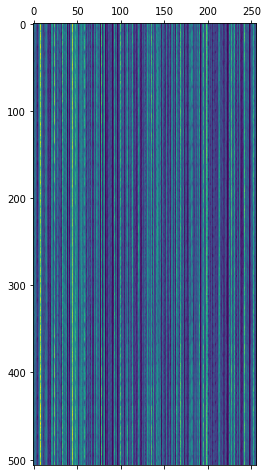

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[246 246 246 246 246 246 246 246 246 246 246 252 252 252 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 252 252 252
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 252 252 252 252 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 252 252 252 252 252 246 246 246 246 246 246 246 246
 246 246 246 246   9 246 246 246 246 246 252 252 252 252 252 246 246 246
 246 246 246   9 246 246 246   9 246   9 246 246 246 246 252 252 252 252
 252 246 246 246   9 246 252 246 246 246 246 246   9 246 246 246 246 246
 252 252 252 252 252 246 246 246 246 246 246 252 246 246 246 246 246 246
 246 246 246 246 246 252 252 252 252 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 252 252 252 252 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246

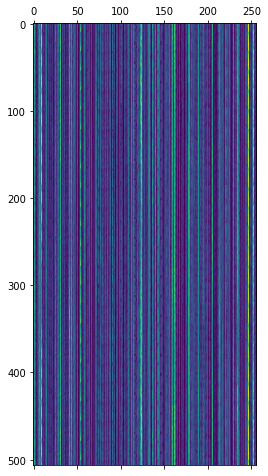

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 21

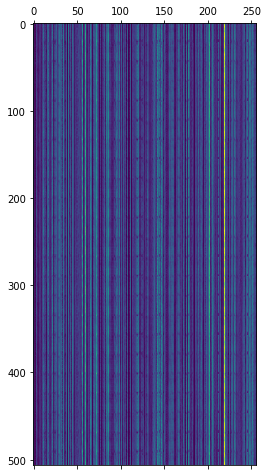

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 

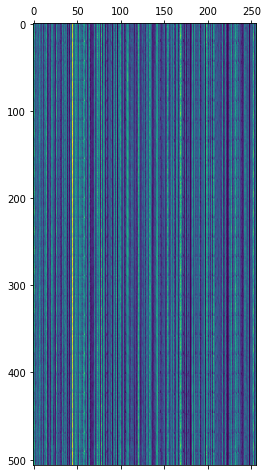

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246

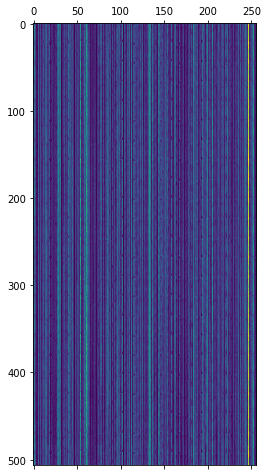

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[218 218 218 218 218 218 218 218 218 218 192 192 192 192 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 192 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 21

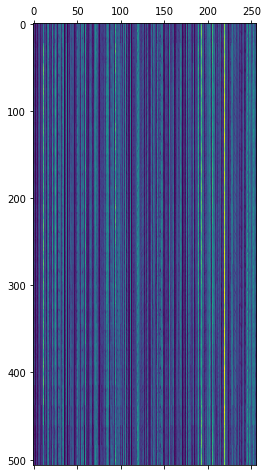

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231
 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231
 231 231 231 231 231 231 231 109 109 231 231 231 231 231 231 231 231 231
 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231
 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231
 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231
 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231
 231  45  45  45 231  45  45 231 231 231 231 231 231 231 231 231 231 231
 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231
 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231
 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231 231  45 231
 231 231 109 231 231 231 231 231 231 231

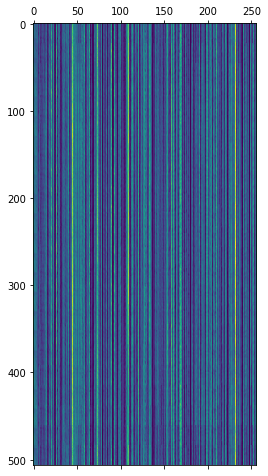

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220
 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220
 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220
 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220
 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220
 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220
 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220
 246 246 220 220 220 246 220 220 220 220 220 220 220 220 220 220 220 220
 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220
 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220
 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220 220
 220 220 220 220 220 220 220 220 220 220

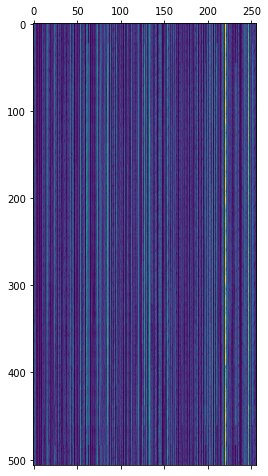

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[222 222 222 222 222 222 222 222 222 222 222 222 222 222 222 218 218 218
 218 218 218 222 222 222 222 222 222 222 222 222 222 222 222 222 222 222
 222 218 218 218 218 218 222 222 222 222 222 218 218 218 218 222 222 218
 218 222 222 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 222 222 222 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 21

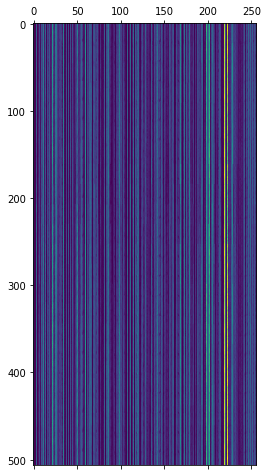

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8
 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8
 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8
 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8
 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8
 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8
 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8
 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8
 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8
 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8
 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8 8
 8 8 8 8 8 8 8 8 8

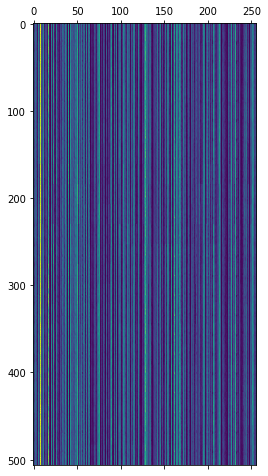

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[ 32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32
  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32
  32  32  32  32  32  32  32  32  32  32  32  32  32  32 246  32  32  32
  32  32  32  32  32  32  32  32 246 246  32  32  32  32  32  32  32  32
  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32
  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32 246 246
 246  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32
  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32
 230  32 246  32  32  32 246 246 246  32 246  32  32  32 246  32  32  32
  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32
  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  32  85  32
  32  32  32  32  32  32  32  32  32  32

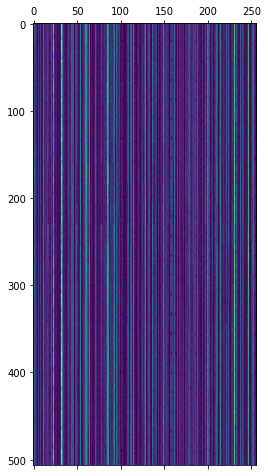

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 21

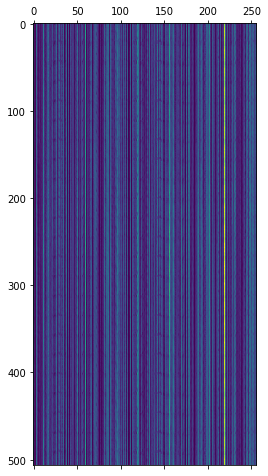

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[ 76 120   0   0   0 231 231 231 231   1   1   1   0   0   0 134   0   0
   0 231   1   1 120   0 120   0   0   0 231 231 231   1 231 231   1   1
 231   0   0   0 134 231   1   1   1 120   0   0   0 231 231 231   0 231
 231   1   1 231   0   0   0   0   0   0   1   1   1 120   0   0 231   0
 231 231 231 231 231   1 231 231 231   0   0   0   0   0 231 231   1 224
 231   0   0 231 231 231 231 231   1 231 231 231   1 231   0   0   0   0
 231   1   1   1 231   0   0 231 231 231 231   0  76   0  76  76 231   0
   0   0   0   0   0   1   1   1 120   0   0   0 231   0   0   0   0   0
   0   0   0   0   0   0   0   0   0   0   1   1   0   0   0   0   0   0
   0   0   0   0  76   0  76   0   0   0   0   0   0   0   1   1   0   0
   0   0   0   0   0   0   0   0   0   1   1  76   0   0   0   0   0   0
   1   1   1 120   0   0   0   0   0   0

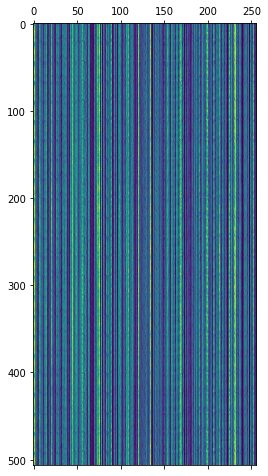

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[136 136 136 136 136 246 136 136 136 246 246 246 246 246 246 136 136 136
 246 246 246 246 246 136 136 136 136 246 246 136 136 246 246 246 246 246
 246 136 136 136 246 246 246 246 246 136 136 136 136 136 136 136 136 203
 136 246 246 246 246 246 136 136 136 246 246 246 246 136 136 136 136 136
 136 136 136 136 136 136 246 246 246 246 136 136 136 246 246 246 246 136
 136 136 136 177 246 136 136 136 136 246 136 246 246 246 136 136 136 246
 246 246 246 246 136 177 136 246 246 136 136 136 136 136 246 246 246 246
 246 136 136 136 246 246 246 136 136 136 177 246 246 246 136 136 136 136
 246 246 246 246 246 246 136 246 246 246 246 246 136 136 136 246 246 246
 136 136 136 136 136 136 246 246 246 136 136 136 136 136 246 246 246 136
 136 136 136 136 136 136 136 136 136 246 246 246 246 246 136 136 136 246
 246 246 246 136 246 136 136 246 136 136

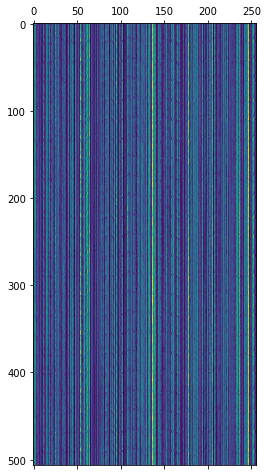

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 21

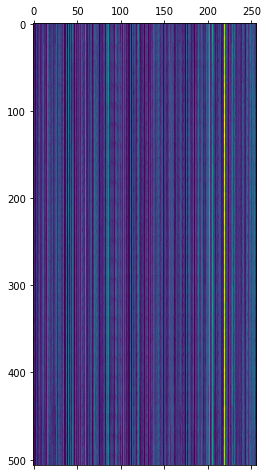

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 

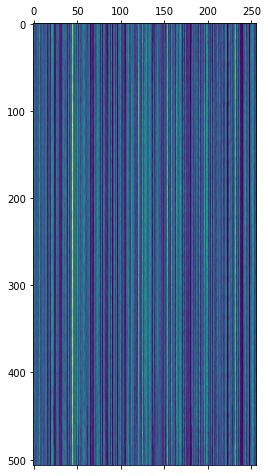

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246 246 246 246 246

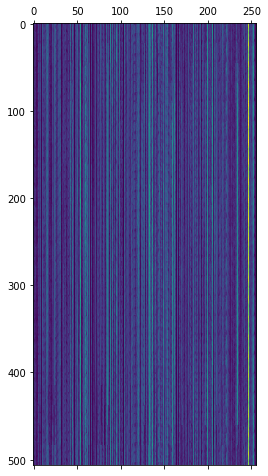

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[ 60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60
  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60
  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60
  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60
  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60
  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60
  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60
  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60
  60  60  60  60  60  94  60  60  60  94  60  60  60  60  60  60  60  60
  60  60  60  60  60  60  60  94  94  60  60  60  94  94  60  60  60  60
  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  60  94  60
  60  60  6

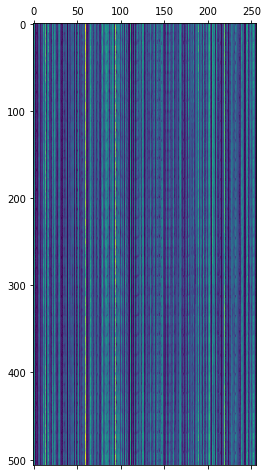

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[ 64  64  64  64 134 134  45  45  45  45  45  64  45  45  45  45  45  45
  45  45  45  45  64  64  64  45  45  45  45  45  45  45  45  45  45  45
  45  45  45  45  45  45  45  45  64  64  64  45  45  45  45  45  45  45
  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45
  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45
  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45
  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45
  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45
  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45
  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45
  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45  45
  45  45  45  45  45  45  45  45  45  45

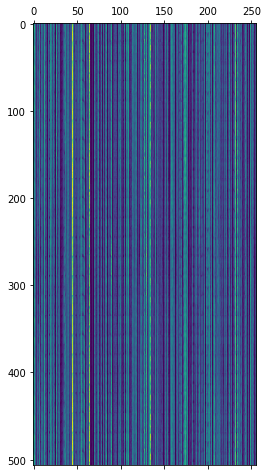

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[ 95  95  95  21  21  95  21  95  21  95  73  95  95  95  95  95  95  95
  95  95  95  95  95  95  95  95  95  21  95  95  95  21  95  73  95  95
  95  95  95  95  95  95  95  95  95  95  95  95  21  95  21  95  21  95
  21  73  73  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95
  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95
  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95
  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95
  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95
  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95
  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95
  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95  95
  95  95  95  95  95  95  95  95  95  95

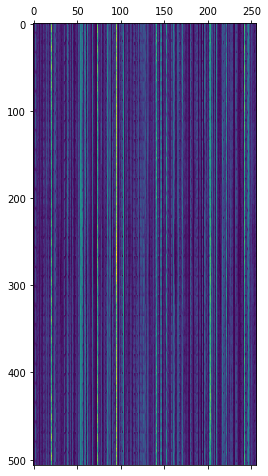

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 3

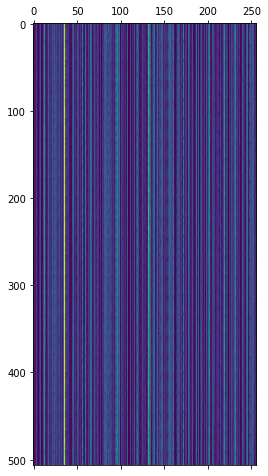

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[24 24 24 24 45 45 45 24 24 24 24 24 24 24 24 45 45 45 45 45 45 45 24 24
 24 24 45 45 45 24 24 24 24 24 24 24 24 24 45 45 45 45 45 45 24 24 24 24
 45 45 45 45 24 24 24 24 24 24 24 24 45 45 45 45 45 45 24 24 24 24 45 45
 45 45 45 24 45 45 24 24 24 45 45 45 45 45 45 45 45 24 24 24 45 45 45 45
 45 45 45 45 24 24 24 24 45 45 45 45 45 45 45 24 24 24 45 45 45 45 45 45
 45 45 45 24 24 24 45 45 45 45 45 45 45 45 24 24 45 45 45 45 45 45 45 45
 45 45 24 24 45 45 45 45 45 45 45 45 24 24 45 45 45 45 45 45 45 45 45 45
 24 24 24 45 45 45 45 45 45 45 24 24 24 45 45 45 45 45 45 45 45 24 24 24
 24 45 45 45 45 45 45 45 24 24 24 45 45 45 45 45 45 24 24 24 24 24 24 45
 45 45 45 45 45 45 45 24 24 24 45 45 45 45 24 24 24 24 24 24 24 24 45 45
 45 45 24 45 45 24 24 24 45 45 45 45 45 24 24 24 24 24 24 24 45 45 45 45
 45 45 45 45 24 24 45 45 45 45 24 24 45 

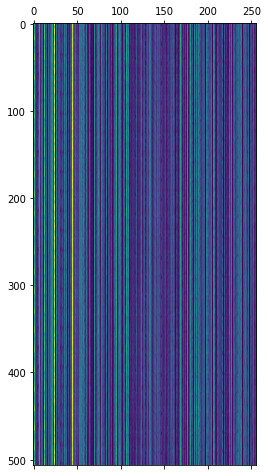

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[122 122 124 124 124 124 122 122 122 122 122 122 124 124 124 124 124 124
 122 122 122 122 122 124 124 124 124 124 122 122 122 122 122 122 122 122
 124 124 124 122 122 122 122 122 122 122 124 124 124 124 124 122 122 122
 122 122 122 124 124 124 124 124 124 122 122 122 122 122 124 124 124 124
 124 124 122 122 122 122 122 124 124 124 124 124 124 124 124 122 122 122
 124 124 124 124 124 122 122 122 122 122 122 122 124 124 124 124 124 122
 122 122 122 122 122 124 124 124 124 122 122 122 122 122 122 122 122 122
 122 124 122 122 122 122 122 122 122 122 124 124 124 124 122 122 122 122
 122 122 122 122 122 122 122 122 122 122 122 122 122 122 124 124 124 122
 122 122 122 122 122 122 122 122 122 122 122 122 122 122 122 122 122 122
 122 122 122 122 122 122 122 122 122 122 122 122 122 122 122 122 122 122
 122 122 122 122 122 124 124 122 122 122

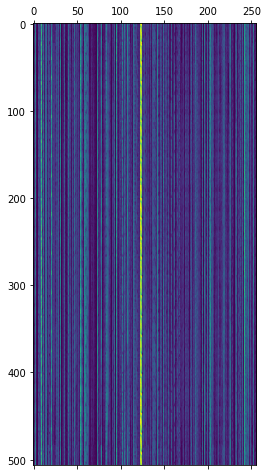

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[218 218 218 218 218 218  94 218 218  94  94  94  94  94  94 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 21

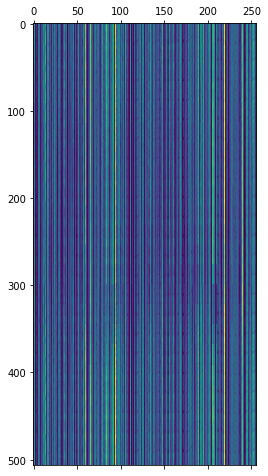

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 

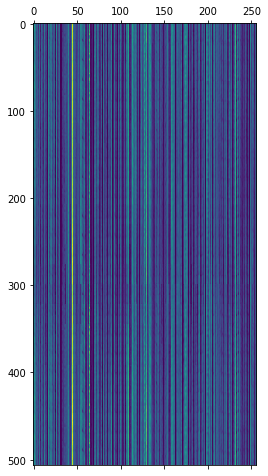

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[ 95 202 202 202 202 202 202 202 202 246 246  95  95  95 202  95  95  95
  95  95  95  95 202 202 202 202 202 202 202 202 202 246 202 202 202 202
 202 202 202 202 202 202 202 202 202 202 202 246 202 202 241 241 241 246
 246 246 246 246 246 202 246 246  95  95  95  95  95 246 246 246 241 241
 241 241 241 241 246 246 246 246 246 246 246 246 246 246  95  95  95 246
 246 246  95  95 246 246 246 246 246 246 246 246 246 246 246 246 246 246
  95  95  95 246 246 246 246 246 246 246 246 246 246 246 246 246 246 246
 246 246 246 246 246 246  95  95 246 246 246 246 246 246 246 241 241 246
 246 246  95  95 246 246 246 246 246 246 246  95 246 246 246  95 246 246
  95  95  95 246 246  95  95 246 246 246 246 246  95  95  95  95  95 246
  95  95  95  95  95  95  95  95  95  95  95  95 246  95 246  95  95  95
  95  95  95  95 246  95  95  95  95  95

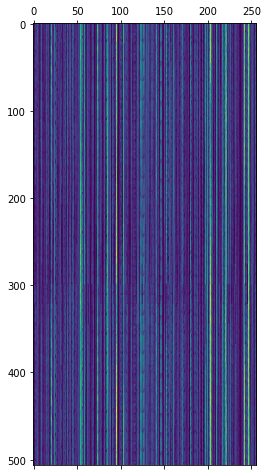

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218  60  60 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218 218
 218 218 218 218 218 218 218 218 218 239 239 239 239 239 239 239 239 239
 239 239 23

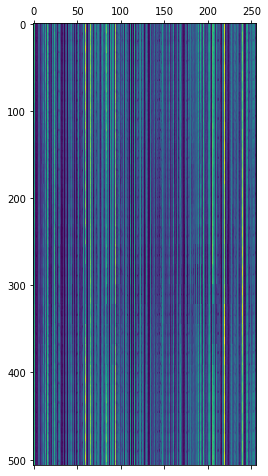

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[ 45  45 231 115 115 115 115 115 115 115 115  45  45  45 115 115 115 115
 115 115  45  45  45 231 231 115 115 115 231 115 115 115 115  45  45  45
 115 115 115 115 115 115  45  45  45 231 115  45 231 231 231 231 231 231
 115  45  45  45  45 115 115 115 115 115  45  45  45  45 231 231 115 115
 115 231 115 115 115 115  45  45  45 115 115 115 115 115 115  45  45  45
 231 115 115 115 115 115 115 115 115 115 115  45  45 115 115 115 115 115
 115 115  45  45 231 115 115 115 231 231 231 231 231 115  45  45  75  75
 115 115 115 115 115 115  75  75  75 231 115 115 115 231 231 231 231 231
  45  45  75  75  75  75  75  75  75  75  75  75  75  75  75  75 231 231
 231 231 231 231  45  45  45  75  75  75  75  75  75  75  75  75  75  75
  75  75 231 231 231 115 115 115 115 115 115  75  75  75 115 115  75  75
  75  75  75  75  75 115 115 115 115 115

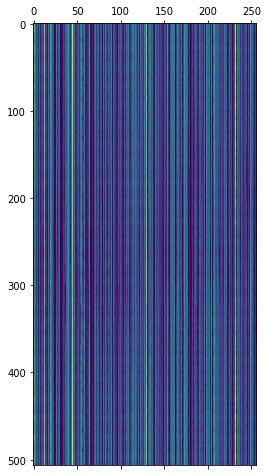

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103
 103 103 103 103 103 103 103 103 103 103 103  95 103 103 103 103 103 103
 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103
 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103
 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103
 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103
 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103
 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103
 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103
 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103
 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103 103
 103 103 103 103 103 103 103 103 103 103

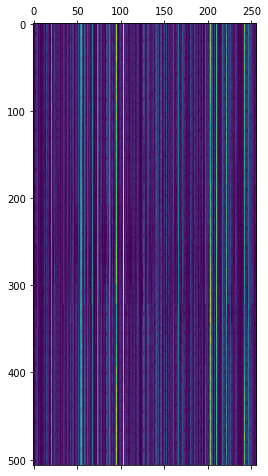

----------------------------------------------------

torch.Size([507, 64, 64, 3])
Current layer: block3_conv1
Indices of FM with highest average firing rate in response to each image: 
[36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36 36
 36 36 36 3

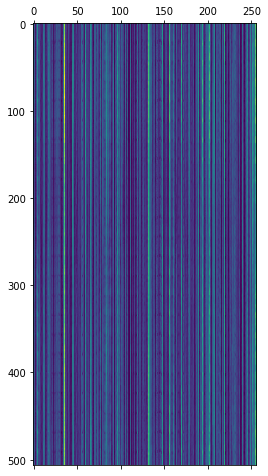

----------------------------------------------------

Current layer: block3_conv2
Indices of FM with highest average firing rate in response to each image: 
[45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45 45
 45 45 45 45 45 45 45 45 45 45 45 45 45 

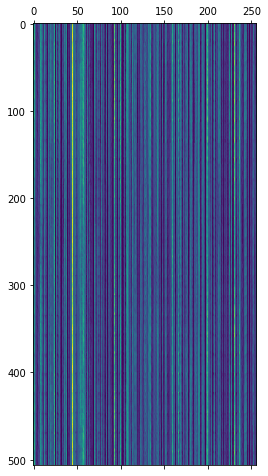

----------------------------------------------------

Current layer: block3_conv3
Indices of FM with highest average firing rate in response to each image: 
[177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177
 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177
 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177
 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177
 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177
 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177
 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177
 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177
 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177
 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177
 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177 177
 177 177 177 177 177 177 177 177 177 177

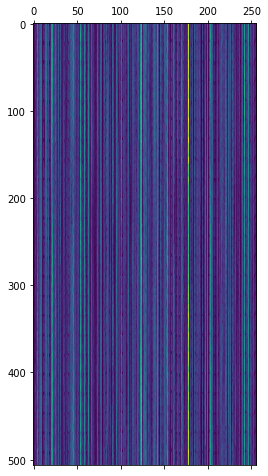

----------------------------------------------------



In [ ]:
neuron_output_highest_with_shifts, fm_avg_all_layers_with_shifts, neuron_labels, max_indices = show_stimuli_2D(
    VGG16_Model, range(7,11), images_selected_classes, shifts = True,  max_indices = None, n_images_selected_classes = num_images, n_max_feature_maps=5, plot_activity = True)

In [ ]:
data = np.transpose(neuron_output_highest_with_shifts, (1,0))
from scipy.io import savemat
mdic = {"neuron_output_2D": data}
mdic
savemat("neuron_output_2D_vgg_block3.mat", mdic)

# Streamline tensor factorization:

In [ ]:
from scipy.io import loadmat
N_vgg_3D_block1 = loadmat("neuron_output_3D_vgg_block1.mat")['neuron_output_3D']
N_vgg_3D_block3 = loadmat("neuron_output_3D_vgg_block3.mat")['neuron_output_3D']
N_vgg_2D_block1 = loadmat("neuron_output_2D_vgg_block1.mat")['neuron_output_2D']
N_vgg_2D_block3 = loadmat("neuron_output_2D_vgg_block3.mat")['neuron_output_2D']

In [ ]:
def get_tensor_factors(N, dim = 3, ranks = [10, 20, 30], reps = 1):
## note that for 2D tensor (ie a matrix), rank + nullity = num_columns => rank <= num_columns
  if dim == 3:
    N_filtered = N 
    # N_filtered = np.empty(N.shape)
    # for i in range(N.shape[0]):
    #   for j in range(N.shape[1]):
    #     filtered = gaussian_filter(N[i,j,:].reshape((n_vertical_shifts, n_vertical_shifts)), sigma=1).reshape((n_vertical_shifts * n_vertical_shifts,))
    #     N_filtered[i,j,:] = filtered[:]
  else:
    N_filtered = N.reshape((N.shape[0], N.shape[1],1))

  # Fit ensembles of tensor decompositions:
  methods = (
    'ncp_hals',  # fits nonnegative tensor decomposition.
  )

  ensembles = {}
  for m in methods:
      ensembles[m] = tt.Ensemble(fit_method=m,  fit_options=dict(tol=1e-5))
      ensembles[m].fit(N_filtered, ranks=ranks, replicates=reps)
      ## replicates: int, number of models to fit at each rank

  ## plot objective, similarity, factors:
  """
  Customized plotting routines for CP decompositions
  """

  # Plotting options for the unconstrained and nonnegative models.
  plot_options = {
    'ncp_hals': {
      'line_kw': {
        'color': 'blue',
        'alpha': 1,
        'label': 'ncp_hals',
      },
      'scatter_kw': {
        'color': 'blue',
        'alpha': 1,
        's': 1,
      },
    },
  }

  def plot_objective(ensemble, partition='train', ax=None, jitter=0.1,
                    scatter_kw=dict(), line_kw=dict()):
      """Plots objective function as a function of model rank.
      Parameters
      ----------
      ensemble : Ensemble object
          holds optimization results across a range of model ranks
      partition : string, one of: {'train', 'test'}
          specifies whether to plot the objective function on the training
          data or the held-out test set.
      ax : matplotlib axis (optional)
          axis to plot on (defaults to current axis object)
      jitter : float (optional)
          amount of horizontal jitter added to scatterpoints (default=0.1)
      scatter_kw : dict (optional)
          keyword arguments for styling the scatterpoints
      line_kw : dict (optional)
          keyword arguments for styling the line
      """

      if ax is None:
          ax = plt.gca()

      if partition == 'train':
          pass
      elif partition == 'test':
          raise NotImplementedError('Cross-validation is on the TODO list.')
      else:
          raise ValueError("partition must be 'train' or 'test'.")

      # compile statistics for plotting
      x, obj, min_obj = [], [], []
      for rank in sorted(ensemble.results):
          # reconstruction errors for rank-r models
          o = ensemble.objectives(rank)
          obj.extend(o)
          x.extend(np.full(len(o), rank))
          min_obj.append(min(o))

      print(o)
      print(obj)
      print(x)
      # add horizontal jitter
      ux = np.unique(x)
      x = np.array(x) + (np.random.rand(len(x))-0.5)*jitter

      # make plot
      # customized: plot objectives for all iterations
      ax.scatter(x, obj, **scatter_kw)
      ax.plot(ux, min_obj, **line_kw)
      ax.set_xlabel('model rank')
      ax.set_ylabel('objective')

      return ax


  def plot_similarity(ensemble, ax=None, jitter=0.1,
                      scatter_kw=dict(), line_kw=dict()):
      """Plots similarity across optimization runs as a function of model rank.
      Parameters
      ----------
      ensemble : Ensemble object
          holds optimization results across a range of model ranks
      ax : matplotlib axis (optional)
          axis to plot on (defaults to current axis object)
      jitter : float (optional)
          amount of horizontal jitter added to scatterpoints (default=0.1)
      scatter_kw : dict (optional)
          keyword arguments for styling the scatterpoints
      line_kw : dict (optional)
          keyword arguments for styling the line
      References
      ----------
      Ulrike von Luxburg (2010). Clustering Stability: An Overview.
      Foundations and Trends in Machine Learning.
      https://arxiv.org/abs/1007.1075
      """

      if ax is None:
          ax = plt.gca()

      # compile statistics for plotting
      x, sim, mean_sim = [], [], []
      for rank in sorted(ensemble.results):
          # reconstruction errors for rank-r models
          s = ensemble.similarities(rank)[1:]
          sim.extend(s)
          x.extend(np.full(len(s), rank))
          mean_sim.append(np.mean(s))

      # add horizontal jitter
      ux = np.unique(x)
      x = np.array(x) + (np.random.rand(len(x))-0.5)*jitter

      # make plot
      # customized: plot similarities for all iterations
      ax.scatter(x, sim, **scatter_kw)
      ax.plot(ux, mean_sim, **line_kw)

      ax.set_xlabel('model rank')
      ax.set_ylabel('model similarity')
      ax.set_ylim([0, 1.1])

      return ax

  # Plot similarity and error plots.
  plt.figure()
  for m in methods:
      plot_objective(ensembles[m], **plot_options[m])
  plt.legend()

  # plt.figure()
  # for m in methods:
  #     plot_similarity(ensembles[m], **plot_options[m])
  # plt.legend()

  plt.show()

  return ensembles ## A LIST!

In [ ]:
def get_embeddings(tensor_factors_best_rank,neuron_labels,n_dim_PCA = 10): 
  neuron_factor = tensor_factors_best_rank[0]
  # PCA on tensor factors 
  pca = PCA(n_dim_PCA)
  neuron_output_highest_with_shifts_PCA = pca.fit_transform(neuron_factor)
  neuron_output_highest_with_shifts_PCA.shape
  vectors, lambdas = pca.components_, pca.explained_variance_
  plt.plot(pca.explained_variance_ratio_)
  plt.show()

  # plot embeddings:

  import plotly.graph_objects as go
  import plotly.express as px

  fig = go.Figure()
  traces = []
  colors_palette = px.colors.qualitative.Dark24
  data = neuron_output_highest_with_shifts_PCA
  print(data.shape)
  for i, label in enumerate(set(neuron_labels)):
      mask = (neuron_labels == label)
      print(mask.shape)
      print(label, sum(mask))
      traces.append(go.Scatter3d(
          x=data[mask,0],
          y=data[mask,1],
          z=data[mask,2],
          mode='markers',
          marker=dict(
              size=4,
              color=colors_palette[int(label)],
              opacity=1,
              #showscale= True,
          )))

  for trace in traces:
      fig.add_trace(trace)
  fig.update_layout(
    
    width=700,
    margin=dict(r=20, l=10, b=10, t=10))

  fig.update_layout(margin=dict(l=0, r=0, b=0, t=0),showlegend=True,
                    # scene = dict(xaxis = dict(range=[-1.5,2.5],),
                    #              yaxis = dict(range=[-1.5,1.5],),
                    #              zaxis = dict(range=[-1.5,1.5],),),
                    )
  fig.show()
  return neuron_output_highest_with_shifts_PCA

In [ ]:
def colorFromUnivariateData(Z1, cmap1 = plt.cm.Reds):
    # Rescale values to fit into colormap range (0->255)
    Z1_plot = np.array(255*(Z1-Z1.min())/(Z1.max()-Z1.min()), dtype=np.int)

    Z1_color = cmap1(Z1_plot)

    # Color for each point
    Z_color = np.array(Z1_color[:,0:3])
    return Z_color

## ## https://stackoverflow.com/questions/49871436/scatterplot-with-continuous-bivariate-color-palette-in-python

def colorFromBivariateData(Z1,Z2,cmap1 = plt.cm.Blues, cmap2 = plt.cm.Reds):
    # Rescale values to fit into colormap range (0->255)
    Z1_plot = np.array(255*(Z1-Z1.min())/(Z1.max()-Z1.min()), dtype=np.int)
    Z2_plot = np.array(255*(Z2-Z2.min())/(Z2.max()-Z2.min()), dtype=np.int)

    Z1_color = cmap1(Z1_plot)
    Z2_color = cmap2(Z2_plot)

    # Color for each point
    Z_color = np.sum([Z1_color , Z2_color ], axis=0)/2.0
    Z_color = np.array(Z_color[:,0:3])
    return Z_color

def get_spatial_order_plot(cluster_index, neuron_output_highest_with_shifts_PCA, neuron_labels, n_max_feature_maps = 5):
  n_neurons = int(neuron_labels.shape[0]/n_max_feature_maps)
  feature_map_side = int(np.sqrt(n_neurons))
  neuron_cluster = neuron_output_highest_with_shifts_PCA[cluster_index * n_neurons : (cluster_index + 1) * n_neurons]
  neuron_labels_cluster = neuron_labels[cluster_index * n_neurons : (cluster_index + 1) * n_neurons]
  xs, ys = np.mgrid[0:feature_map_side,0:feature_map_side]
  xs = xs.reshape((n_neurons,))
  ys = ys.reshape((n_neurons,))

  import plotly.graph_objects as go
  import plotly.express as px

  fig = go.Figure()
  traces = []
  colors_palette = px.colors.qualitative.Dark24
  data = neuron_cluster

  for i, label in enumerate(set(neuron_labels)):
      mask = (neuron_labels_cluster == label)
      print(label, sum(mask))
      traces.append(go.Scatter3d(
          x=data[mask,0],
          y=data[mask,1],
          z=data[mask,2],
          mode='markers',
          marker=dict(
              size=4,
              color=colors_palette[int(label)],
              opacity=1,
              #showscale= True,
          )))
  for trace in traces:
      fig.add_trace(trace)
  fig.update_layout(margin=dict(l=0, r=0, b=0, t=0),showlegend=True,)
  fig.show()

  fig = plt.figure(figsize=(12, 12))
  ax = fig.add_subplot(projection='3d')
  data = neuron_cluster
  ax.scatter(
          data[:,0],
          data[:,1],
          data[:,2],
          c = colorFromUnivariateData(xs, cmap1 = plt.cm.Blues),
          s = 100,
          alpha= 1
          ) 
  plt.show()

  fig = plt.figure(figsize=(12, 12))
  ax = fig.add_subplot(projection='3d')
  data = neuron_cluster
  ax.scatter(
          data[:,0],
          data[:,1],
          data[:,2],
          c = colorFromUnivariateData(ys, cmap1 = plt.cm.Reds),
          s = 100,
          alpha= 1
          ) 
  plt.show()

In [ ]:
def get_tensor_factors_plot(tensor_factors_best_rank, best_rank, n_max_feature_maps):
  ## neuron_factor shape: (#neuron, #factors=best_rank)
  neuron_factor = tensor_factors_best_rank[0]
  ## neuron_factor shape: (#shifts, #factors=best_rank)
  time_factor = tensor_factors_best_rank[2]
  
  # neuron_factor_first = neuron_factor[:,0]
  plt.plot(neuron_factor)
  plt.show()
  
  # time_factor_first = time_factor[:,0]
  plt.plot(time_factor)
  plt.show()

  n_neurons = neuron_factor.shape[0]
  feature_map_side = int(np.sqrt(n_neurons/n_max_feature_maps))
  for i in range(best_rank):
    neuron_factor_i_th = neuron_factor[:,i]
    vmin = neuron_factor_i_th.min()
    vmax = neuron_factor_i_th.max()
    print(neuron_factor.shape)
    f_i, axes = plt.subplots(1,n_max_feature_maps,figsize=(10,1))
    for f_i, ax in enumerate(axes):
      feature_map_matrix = neuron_factor_i_th[(f_i * feature_map_side ** 2): ((f_i+1) * feature_map_side ** 2)].reshape((feature_map_side, feature_map_side))
      ax.imshow(feature_map_matrix, vmin = vmin, vmax = vmax)
      ax.set(xticks = [], yticks = [])
    plt.show()

##3D:

In [ ]:
N_vgg_3D_block1.shape

(13520, 20, 507)

Check shifts:

[[0.18272458 0.19928265 0.19947354 ... 0.49531998 0.4639046  0.46001048]
 [0.27016424 0.26352122 0.21973259 ... 0.48984124 0.45760368 0.45408491]
 [0.31127859 0.30765687 0.25550628 ... 0.46719223 0.44923928 0.43794052]
 ...
 [0.82252954 0.85501034 0.83207107 ... 0.77928711 0.76658838 0.74268282]
 [0.84550336 0.87598727 0.85099525 ... 0.76330838 0.78690054 0.78521746]
 [0.87943962 0.90384291 0.86112814 ... 0.77096615 0.78386715 0.78808545]]


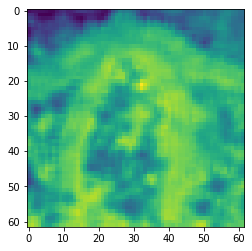

[[0.78808545 0.81342584 0.84563816 ... 0.75197991 0.78837487 0.77302552]
 [0.68480347 0.64290157 0.63114962 ... 0.6849806  0.70129818 0.68575666]
 [0.59660876 0.51131033 0.48804199 ... 0.63885808 0.65726728 0.62912416]
 ...
 [0.65854302 0.66500887 0.70872359 ... 0.73085777 0.75117608 0.78512027]
 [0.68620101 0.67427897 0.71407606 ... 0.7010085  0.74135244 0.79896368]
 [0.72021684 0.69717943 0.71266752 ... 0.69940763 0.72400804 0.76090968]]


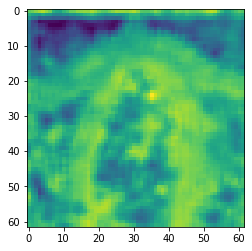

[[0.77302552 0.77096615 0.78386715 ... 0.64500675 0.66066676 0.71325861]
 [0.68575666 0.66843976 0.67829506 ... 0.55478223 0.58966741 0.65060877]
 [0.62912416 0.60075217 0.59366851 ... 0.50104586 0.54110464 0.59468465]
 ...
 [0.78512027 0.74787383 0.70201807 ... 0.67561925 0.70389468 0.69285831]
 [0.79896368 0.78549826 0.74431956 ... 0.68980546 0.69137419 0.65535847]
 [0.76090968 0.77347177 0.7567811  ... 0.67919671 0.66948651 0.6355562 ]]


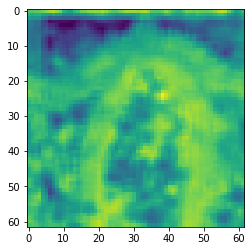

[[0.71325861 0.75197991 0.78837487 ... 0.89893012 0.79960631 0.71693526]
 [0.65060877 0.6849806  0.70129818 ... 0.70308502 0.63251282 0.59397723]
 [0.59468465 0.63885808 0.65726728 ... 0.58586632 0.5337101  0.50846201]
 ...
 [0.69285831 0.73085777 0.75117608 ... 0.4659613  0.53917812 0.61765879]
 [0.65535847 0.7010085  0.74135244 ... 0.49501084 0.5856681  0.64733798]
 [0.6355562  0.69940763 0.72400804 ... 0.59239829 0.63234221 0.66001298]]


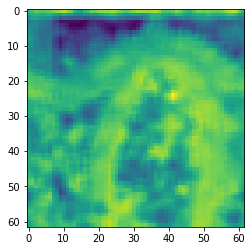

[[0.71693526 0.64500675 0.66066676 ... 0.85281864 0.89575288 0.91688938]
 [0.59397723 0.55478223 0.58966741 ... 0.70297478 0.73671218 0.74363696]
 [0.50846201 0.50104586 0.54110464 ... 0.58919392 0.61258133 0.60297816]
 ...
 [0.61765879 0.67561925 0.70389468 ... 0.64937705 0.52476271 0.47225223]
 [0.64733798 0.68980546 0.69137419 ... 0.68853929 0.56301762 0.5156678 ]
 [0.66001298 0.67919671 0.66948651 ... 0.73175595 0.66095134 0.61905676]]


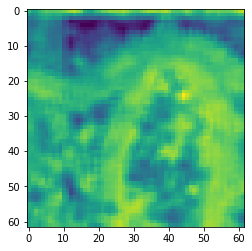

[[0.91688938 0.89893012 0.79960631 ... 0.79202202 0.8008637  0.81725228]
 [0.74363696 0.70308502 0.63251282 ... 0.68673388 0.67227246 0.68030111]
 [0.60297816 0.58586632 0.5337101  ... 0.59117729 0.55531525 0.57484688]
 ...
 [0.47225223 0.4659613  0.53917812 ... 0.79232758 0.77670459 0.69886124]
 [0.5156678  0.49501084 0.5856681  ... 0.79484693 0.79618605 0.74585238]
 [0.61905676 0.59239829 0.63234221 ... 0.7801318  0.78703028 0.76614155]]


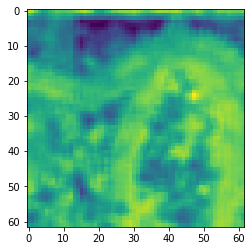

[[0.81725228 0.85281864 0.89575288 ... 0.79864244 0.82145944 0.79795706]
 [0.68030111 0.70297478 0.73671218 ... 0.67450134 0.71823593 0.69420053]
 [0.57484688 0.58919392 0.61258133 ... 0.62005612 0.62336642 0.601411  ]
 ...
 [0.69886124 0.64937705 0.52476271 ... 0.85409297 0.8617694  0.84070123]
 [0.74585238 0.68853929 0.56301762 ... 0.86545526 0.86418199 0.83523132]
 [0.76614155 0.73175595 0.66095134 ... 0.86617815 0.84779146 0.81771678]]


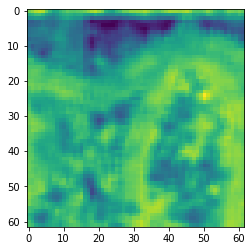

[[0.79795706 0.79202202 0.8008637  ... 0.76319846 0.82403879 0.81322457]
 [0.69420053 0.68673388 0.67227246 ... 0.6494816  0.69256163 0.67230359]
 [0.601411   0.59117729 0.55531525 ... 0.58082852 0.61114024 0.60783331]
 ...
 [0.84070123 0.79232758 0.77670459 ... 0.82256756 0.8510377  0.86619492]
 [0.83523132 0.79484693 0.79618605 ... 0.84249706 0.87604996 0.88011601]
 [0.81771678 0.7801318  0.78703028 ... 0.84652677 0.88070331 0.87604949]]


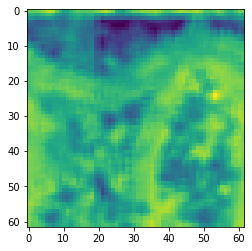

[[0.81322457 0.79864244 0.82145944 ... 0.74651373 0.71481146 0.70665428]
 [0.67230359 0.67450134 0.71823593 ... 0.6471244  0.61849386 0.61732882]
 [0.60783331 0.62005612 0.62336642 ... 0.55744694 0.53099742 0.54350903]
 ...
 [0.86619492 0.85409297 0.8617694  ... 0.70144828 0.73725746 0.75552955]
 [0.88011601 0.86545526 0.86418199 ... 0.68675671 0.71232588 0.76407082]
 [0.87604949 0.86617815 0.84779146 ... 0.67767883 0.70926708 0.77722868]]


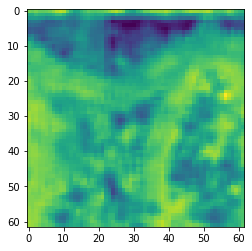

[[0.70665428 0.76319846 0.82403879 ... 0.79652617 0.84572125 0.81013249]
 [0.61732882 0.6494816  0.69256163 ... 0.65139098 0.70808185 0.70072481]
 [0.54350903 0.58082852 0.61114024 ... 0.48973279 0.51023891 0.54555546]
 ...
 [0.75552955 0.82256756 0.8510377  ... 0.54600271 0.63105448 0.66834362]
 [0.76407082 0.84249706 0.87604996 ... 0.58275583 0.6538599  0.65841616]
 [0.77722868 0.84652677 0.88070331 ... 0.63574885 0.68692563 0.68357143]]


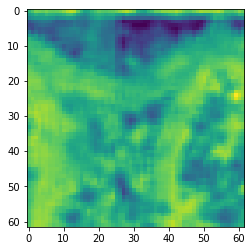

[[0.88356622 0.8141808  0.77960491 ... 0.84529371 0.83910589 0.8396227 ]
 [0.76424139 0.70578241 0.67455668 ... 0.70509662 0.71935986 0.69459659]
 [0.59500685 0.60797622 0.57912921 ... 0.66292684 0.61677863 0.56503943]
 ...
 [0.72892503 0.76503043 0.80408551 ... 0.48240868 0.51586663 0.56466292]
 [0.71809771 0.74900716 0.77689402 ... 0.52043122 0.52236436 0.58252532]
 [0.74553315 0.73910643 0.77355796 ... 0.6115743  0.59551638 0.64228264]]


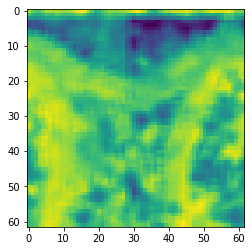

[[0.76984114 0.79652617 0.84572125 ... 0.87442069 0.8970534  0.85214015]
 [0.63686823 0.65139098 0.70808185 ... 0.70466958 0.70849113 0.70498419]
 [0.51807865 0.48973279 0.51023891 ... 0.68602961 0.66248952 0.67539967]
 ...
 [0.51773343 0.54600271 0.63105448 ... 0.55706796 0.50011602 0.44570741]
 [0.53411128 0.58275583 0.6538599  ... 0.60825942 0.57835529 0.48905214]
 [0.58890213 0.63574885 0.68692563 ... 0.73477419 0.69965103 0.5884654 ]]


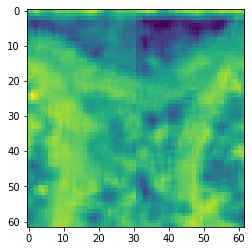

[[0.85214015 0.77504082 0.76936728 ... 0.86958079 0.86858763 0.85953311]
 [0.70498419 0.6464956  0.65957341 ... 0.60415329 0.61689888 0.6462614 ]
 [0.67539967 0.60783057 0.56551777 ... 0.45482158 0.53190943 0.60224828]
 ...
 [0.44570741 0.44231539 0.47299263 ... 0.64652205 0.62577048 0.58746051]
 [0.48905214 0.47717785 0.47895034 ... 0.7325299  0.73317264 0.67204368]
 [0.5884654  0.56074598 0.54602264 ... 0.81696249 0.81404738 0.77811792]]


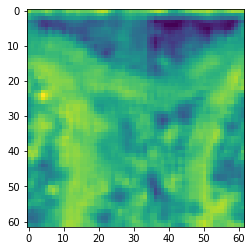

[[0.85953311 0.87442069 0.8970534  ... 0.81364552 0.84514479 0.88076937]
 [0.6462614  0.70466958 0.70849113 ... 0.59853439 0.60809522 0.62247497]
 [0.60224828 0.68602961 0.66248952 ... 0.45382005 0.44967364 0.44361391]
 ...
 [0.58746051 0.55706796 0.50011602 ... 0.7845508  0.76689731 0.71400337]
 [0.67204368 0.60825942 0.57835529 ... 0.79655257 0.81851198 0.79422597]
 [0.77811792 0.73477419 0.69965103 ... 0.79347258 0.82803305 0.8388619 ]]


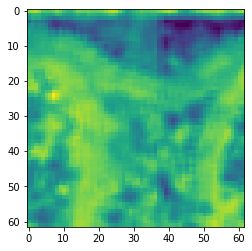

[[0.88076937 0.86958079 0.86858763 ... 0.81134917 0.78444272 0.77560335]
 [0.62247497 0.60415329 0.61689888 ... 0.64155867 0.61887842 0.58320802]
 [0.44361391 0.45482158 0.53190943 ... 0.50291958 0.48636191 0.44597138]
 ...
 [0.71400337 0.64652205 0.62577048 ... 0.82226647 0.81181587 0.80305477]
 [0.79422597 0.7325299  0.73317264 ... 0.78676921 0.78793293 0.79569715]
 [0.8388619  0.81696249 0.81404738 ... 0.78832144 0.79550618 0.78098911]]


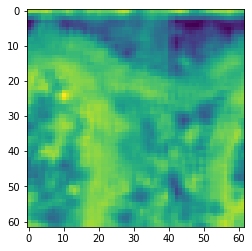

[[0.77560335 0.81364552 0.84514479 ... 0.86046584 0.88783705 0.85908055]
 [0.58320802 0.59853439 0.60809522 ... 0.70326099 0.7258349  0.68419307]
 [0.44597138 0.45382005 0.44967364 ... 0.52762959 0.54851817 0.53301793]
 ...
 [0.80305477 0.7845508  0.76689731 ... 0.86951153 0.85121004 0.87572047]
 [0.79569715 0.79655257 0.81851198 ... 0.91091158 0.87151279 0.86601164]
 [0.78098911 0.79347258 0.82803305 ... 0.9126381  0.87656022 0.85231659]]


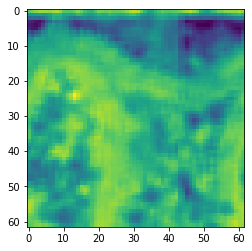

[[0.85908055 0.81134917 0.78444272 ... 0.8482313  0.85362579 0.86265606]
 [0.68419307 0.64155867 0.61887842 ... 0.62792547 0.65208226 0.68455186]
 [0.53301793 0.50291958 0.48636191 ... 0.4573312  0.46947276 0.49345799]
 ...
 [0.87572047 0.82226647 0.81181587 ... 0.78665188 0.83162593 0.8410465 ]
 [0.86601164 0.78676921 0.78793293 ... 0.80917882 0.86053794 0.88967211]
 [0.85231659 0.78832144 0.79550618 ... 0.800883   0.8533908  0.8783521 ]]


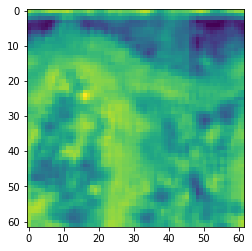

[[0.86265606 0.86046584 0.88783705 ... 0.74776812 0.80737773 0.81184643]
 [0.68455186 0.70326099 0.7258349  ... 0.56235342 0.59748322 0.59180031]
 [0.49345799 0.52762959 0.54851817 ... 0.39098546 0.42123969 0.43537189]
 ...
 [0.8410465  0.86951153 0.85121004 ... 0.72741536 0.75454859 0.78901666]
 [0.88967211 0.91091158 0.87151279 ... 0.72250078 0.7791277  0.79870776]
 [0.8783521  0.9126381  0.87656022 ... 0.6179582  0.70785144 0.77053862]]


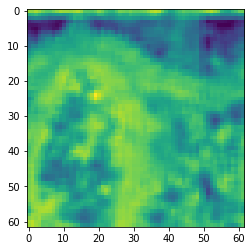

[[0.81184643 0.8482313  0.85362579 ... 0.66007136 0.6456062  0.71260204]
 [0.59180031 0.62792547 0.65208226 ... 0.53052788 0.5333378  0.56850546]
 [0.43537189 0.4573312  0.46947276 ... 0.40524832 0.40531075 0.40271464]
 ...
 [0.78901666 0.78665188 0.83162593 ... 0.67446757 0.6577019  0.68798464]
 [0.79870776 0.80917882 0.86053794 ... 0.68485764 0.65318461 0.67523127]
 [0.77053862 0.800883   0.8533908  ... 0.64938804 0.61554509 0.58438116]]


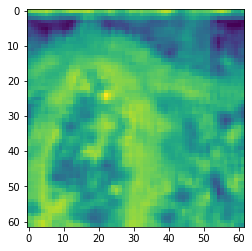

[[0.71260204 0.74776812 0.80737773 ... 0.86112814 0.81797696 0.69802318]
 [0.56850546 0.56235342 0.59748322 ... 0.62172694 0.60350735 0.54138417]
 [0.40271464 0.39098546 0.42123969 ... 0.42925022 0.42335242 0.39758424]
 ...
 [0.68798464 0.72741536 0.75454859 ... 0.56613279 0.57161127 0.6384253 ]
 [0.67523127 0.72250078 0.7791277  ... 0.67156619 0.65951888 0.70750165]
 [0.58438116 0.6179582  0.70785144 ... 0.73330044 0.71311109 0.74413807]]


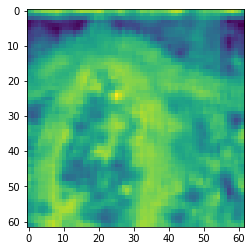

[[0.69802318 0.66007136 0.6456062  ... 0.84563816 0.87943962 0.90384291]
 [0.54138417 0.53052788 0.5333378  ... 0.63114962 0.60803847 0.65980319]
 [0.39758424 0.40524832 0.40531075 ... 0.48804199 0.41073072 0.44308798]
 ...
 [0.6384253  0.67446757 0.6577019  ... 0.70872359 0.71006192 0.62479305]
 [0.70750165 0.68485764 0.65318461 ... 0.71407606 0.74767424 0.69578567]
 [0.74413807 0.64938804 0.61554509 ... 0.71266752 0.7413262  0.74863117]]


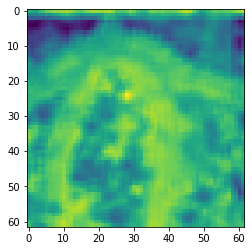

[[0.90384291 0.86112814 0.81797696 ... 0.78386715 0.78808545 0.81342584]
 [0.65980319 0.62172694 0.60350735 ... 0.67829506 0.68480347 0.64290157]
 [0.44308798 0.42925022 0.42335242 ... 0.59366851 0.59660876 0.51131033]
 ...
 [0.62479305 0.56613279 0.57161127 ... 0.70201807 0.65854302 0.66500887]
 [0.69578567 0.67156619 0.65951888 ... 0.74431956 0.68620101 0.67427897]
 [0.74863117 0.73330044 0.71311109 ... 0.7567811  0.72021684 0.69717943]]


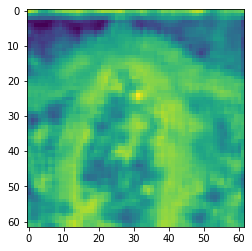

[[0.81342584 0.84563816 0.87943962 ... 0.78837487 0.77302552 0.77096615]
 [0.64290157 0.63114962 0.60803847 ... 0.70129818 0.68575666 0.66843976]
 [0.51131033 0.48804199 0.41073072 ... 0.65726728 0.62912416 0.60075217]
 ...
 [0.66500887 0.70872359 0.71006192 ... 0.75117608 0.78512027 0.74787383]
 [0.67427897 0.71407606 0.74767424 ... 0.74135244 0.79896368 0.78549826]
 [0.69717943 0.71266752 0.7413262  ... 0.72400804 0.76090968 0.77347177]]


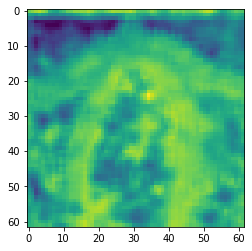

[[0.77347177 0.7567811  0.72021684 ... 0.66948651 0.6355562  0.69940763]
 [0.77928711 0.76658838 0.74268282 ... 0.6775119  0.67475652 0.70557255]
 [0.76330838 0.78690054 0.78521746 ... 0.68190713 0.70581695 0.72809965]
 ...
 [0.74196814 0.73466711 0.6745259  ... 0.69245387 0.67568799 0.70362641]
 [0.73612751 0.71825986 0.6544096  ... 0.7758     0.73340967 0.73323096]
 [0.75162501 0.71491717 0.65874355 ... 0.75365435 0.70943017 0.71986983]]


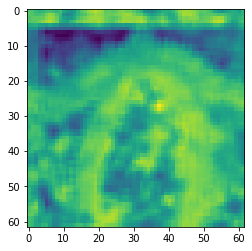

[[0.69940763 0.72400804 0.76090968 ... 0.63234221 0.66001298 0.67919671]
 [0.70557255 0.70811257 0.73747835 ... 0.74886268 0.71525787 0.69110486]
 [0.72809965 0.73853031 0.73466832 ... 0.79168926 0.73519898 0.68607968]
 ...
 [0.70362641 0.71521011 0.73169983 ... 0.70916994 0.69021052 0.66703206]
 [0.73323096 0.70818136 0.7299264  ... 0.59937035 0.66565629 0.69092941]
 [0.71986983 0.71447739 0.75415341 ... 0.52077434 0.63311916 0.68955375]]


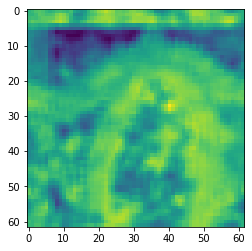

[[0.67919671 0.66948651 0.6355562  ... 0.66095134 0.61905676 0.59239829]
 [0.69110486 0.6775119  0.67475652 ... 0.77068425 0.75449631 0.75797096]
 [0.68607968 0.68190713 0.70581695 ... 0.86159727 0.87097886 0.86694316]
 ...
 [0.66703206 0.69245387 0.67568799 ... 0.74103715 0.7250935  0.68908588]
 [0.69092941 0.7758     0.73340967 ... 0.66699882 0.63014599 0.59406968]
 [0.68955375 0.75365435 0.70943017 ... 0.56605348 0.52408148 0.49581856]]


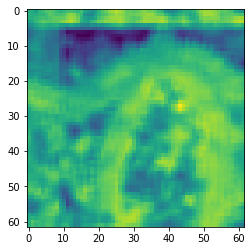

[[0.59239829 0.63234221 0.66001298 ... 0.78703028 0.76614155 0.73175595]
 [0.75797096 0.74886268 0.71525787 ... 0.77673967 0.77933823 0.78213732]
 [0.86694316 0.79168926 0.73519898 ... 0.79169452 0.8007887  0.82668342]
 ...
 [0.68908588 0.70916994 0.69021052 ... 0.77756822 0.74933386 0.735536  ]
 [0.59406968 0.59937035 0.66565629 ... 0.76434236 0.74264848 0.71660787]
 [0.49581856 0.52077434 0.63311916 ... 0.74662707 0.68205339 0.64984954]]


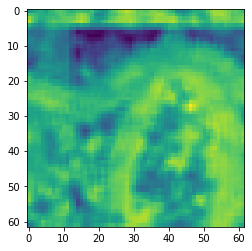

[[0.73175595 0.66095134 0.61905676 ... 0.84779146 0.81771678 0.7801318 ]
 [0.78213732 0.77068425 0.75449631 ... 0.85367212 0.82037992 0.7560104 ]
 [0.82668342 0.86159727 0.87097886 ... 0.83939219 0.82884835 0.77492007]
 ...
 [0.735536   0.74103715 0.7250935  ... 0.85147548 0.84530646 0.82756224]
 [0.71660787 0.66699882 0.63014599 ... 0.8624397  0.84103088 0.81002883]
 [0.64984954 0.56605348 0.52408148 ... 0.86040804 0.82619683 0.77763801]]


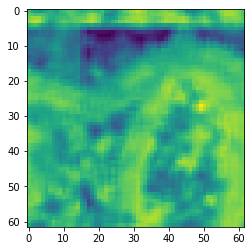

[[0.7801318  0.78703028 0.76614155 ... 0.88070331 0.87604949 0.86617815]
 [0.7560104  0.77673967 0.77933823 ... 0.88206473 0.88026317 0.88251087]
 [0.77492007 0.79169452 0.8007887  ... 0.83687637 0.82927109 0.84238304]
 ...
 [0.82756224 0.77756822 0.74933386 ... 0.83490388 0.85479434 0.83562077]
 [0.81002883 0.76434236 0.74264848 ... 0.85568758 0.86098456 0.84665099]
 [0.77763801 0.74662707 0.68205339 ... 0.85537797 0.8579457  0.85346122]]


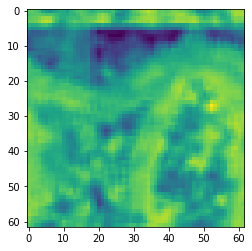

[[0.86617815 0.84779146 0.81771678 ... 0.70926708 0.77722868 0.84652677]
 [0.88251087 0.85367212 0.82037992 ... 0.67741108 0.7412117  0.83076898]
 [0.84238304 0.83939219 0.82884835 ... 0.67749875 0.7086407  0.80324999]
 ...
 [0.83562077 0.85147548 0.84530646 ... 0.70794106 0.75395056 0.80255119]
 [0.84665099 0.8624397  0.84103088 ... 0.75661401 0.76715607 0.82143072]
 [0.85346122 0.86040804 0.82619683 ... 0.75225554 0.75623703 0.82140369]]


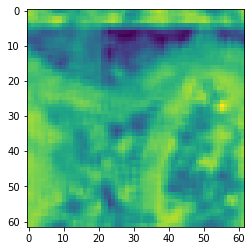

[[0.84652677 0.88070331 0.87604949 ... 0.68692563 0.68357143 0.67767883]
 [0.83076898 0.88206473 0.88026317 ... 0.73228345 0.69441863 0.65048365]
 [0.80324999 0.83687637 0.82927109 ... 0.80022017 0.75439049 0.68755564]
 ...
 [0.80255119 0.83490388 0.85479434 ... 0.61551706 0.61758584 0.65310151]
 [0.82143072 0.85568758 0.86098456 ... 0.59968785 0.66336588 0.70958401]
 [0.82140369 0.85537797 0.8579457  ... 0.60711878 0.66801713 0.70189505]]


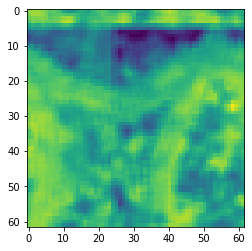

[[0.67767883 0.70926708 0.77722868 ... 0.54602264 0.58890213 0.63574885]
 [0.65048365 0.67741108 0.7412117  ... 0.62853676 0.65819759 0.69999477]
 [0.68755564 0.67749875 0.7086407  ... 0.70914018 0.72886471 0.76315518]
 ...
 [0.65310151 0.70794106 0.75395056 ... 0.5862056  0.59068171 0.62404402]
 [0.70958401 0.75661401 0.76715607 ... 0.52145663 0.55011951 0.56882138]
 [0.70189505 0.75225554 0.75623703 ... 0.48319241 0.52067505 0.5412347 ]]


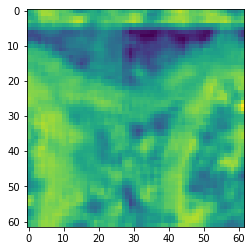

[[0.63574885 0.68692563 0.68357143 ... 0.69965103 0.5884654  0.56074598]
 [0.69999477 0.73228345 0.69441863 ... 0.78277664 0.71277218 0.67217022]
 [0.76315518 0.80022017 0.75439049 ... 0.86675183 0.81918596 0.75230041]
 ...
 [0.62404402 0.61551706 0.61758584 ... 0.66717917 0.62160146 0.56816108]
 [0.56882138 0.59968785 0.66336588 ... 0.5752824  0.51355609 0.48032637]
 [0.5412347  0.60711878 0.66801713 ... 0.50538818 0.46754965 0.47198948]]


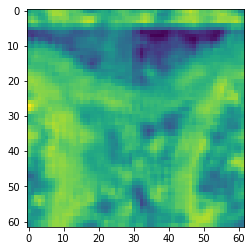

[[0.56074598 0.54602264 0.58890213 ... 0.81404738 0.77811792 0.73477419]
 [0.67217022 0.62853676 0.65819759 ... 0.86616684 0.82396474 0.78556479]
 [0.75230041 0.70914018 0.72886471 ... 0.85221672 0.85225559 0.86022139]
 ...
 [0.56816108 0.5862056  0.59068171 ... 0.65843289 0.67887653 0.67867452]
 [0.48032637 0.52145663 0.55011951 ... 0.64176467 0.62748832 0.61224805]
 [0.47198948 0.48319241 0.52067505 ... 0.59259888 0.58883271 0.5658205 ]]


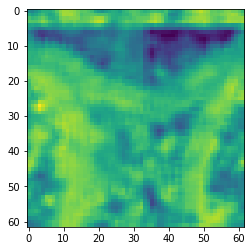

[[0.73477419 0.69965103 0.5884654  ... 0.82803305 0.8388619  0.81696249]
 [0.78556479 0.78277664 0.71277218 ... 0.83692601 0.8599711  0.87988981]
 [0.86022139 0.86675183 0.81918596 ... 0.81773945 0.8623839  0.85911   ]
 ...
 [0.67867452 0.66717917 0.62160146 ... 0.79661852 0.73006162 0.66897952]
 [0.61224805 0.5752824  0.51355609 ... 0.77399549 0.70219562 0.66811863]
 [0.5658205  0.50538818 0.46754965 ... 0.75231429 0.67674547 0.62566314]]


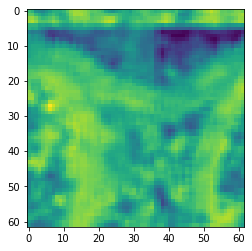

[[0.81696249 0.81404738 0.77811792 ... 0.79550618 0.78098911 0.79347258]
 [0.87988981 0.86616684 0.82396474 ... 0.80669297 0.79953978 0.82269431]
 [0.85911    0.85221672 0.85225559 ... 0.79057966 0.77121065 0.78374608]
 ...
 [0.66897952 0.65843289 0.67887653 ... 0.90250968 0.89869429 0.86081285]
 [0.66811863 0.64176467 0.62748832 ... 0.89058396 0.87967623 0.83787668]
 [0.62566314 0.59259888 0.58883271 ... 0.8320087  0.8243269  0.80158369]]


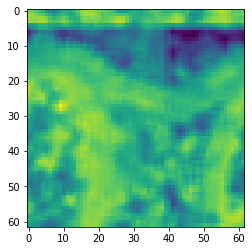

[[0.79347258 0.82803305 0.8388619  ... 0.87656022 0.85231659 0.78832144]
 [0.82269431 0.83692601 0.8599711  ... 0.86041014 0.83844005 0.80005577]
 [0.78374608 0.81773945 0.8623839  ... 0.87173131 0.85009681 0.80926365]
 ...
 [0.86081285 0.79661852 0.73006162 ... 0.87654859 0.88714219 0.89026304]
 [0.83787668 0.77399549 0.70219562 ... 0.84955311 0.88533142 0.89156314]
 [0.80158369 0.75231429 0.67674547 ... 0.8645219  0.87383602 0.84670726]]


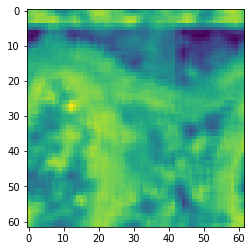

[[0.78832144 0.79550618 0.78098911 ... 0.8533908  0.8783521  0.9126381 ]
 [0.80005577 0.80669297 0.79953978 ... 0.82380686 0.84248365 0.87256906]
 [0.80926365 0.79057966 0.77121065 ... 0.85066098 0.86771044 0.87628321]
 ...
 [0.89026304 0.90250968 0.89869429 ... 0.64173711 0.73843728 0.84591332]
 [0.89156314 0.89058396 0.87967623 ... 0.65630946 0.70416059 0.80743805]
 [0.84670726 0.8320087  0.8243269  ... 0.73986212 0.78036273 0.86251995]]


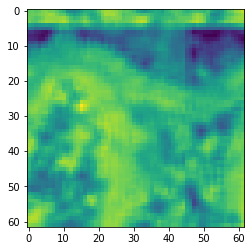

[[0.9126381  0.87656022 0.85231659 ... 0.70785144 0.77053862 0.800883  ]
 [0.87256906 0.86041014 0.83844005 ... 0.71144884 0.75157026 0.76942923]
 [0.87628321 0.87173131 0.85009681 ... 0.74276466 0.78615672 0.81805374]
 ...
 [0.84591332 0.87654859 0.88714219 ... 0.67147021 0.63260828 0.62186   ]
 [0.80743805 0.84955311 0.88533142 ... 0.66851229 0.62665525 0.61931473]
 [0.86251995 0.8645219  0.87383602 ... 0.74018015 0.74092197 0.70140321]]


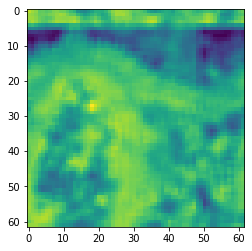

[[0.800883   0.8533908  0.8783521  ... 0.61554509 0.58438116 0.6179582 ]
 [0.76942923 0.82380686 0.84248365 ... 0.54772281 0.56009493 0.63852838]
 [0.81805374 0.85066098 0.86771044 ... 0.59762985 0.6155149  0.66600645]
 ...
 [0.62186    0.64173711 0.73843728 ... 0.62444152 0.62210151 0.61254499]
 [0.61931473 0.65630946 0.70416059 ... 0.59303561 0.59476012 0.61534424]
 [0.70140321 0.73986212 0.78036273 ... 0.65078653 0.66377968 0.70102112]]


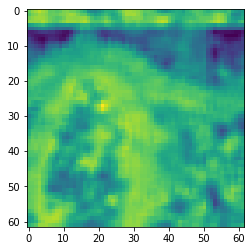

[[0.6179582  0.70785144 0.77053862 ... 0.71311109 0.74413807 0.64938804]
 [0.63852838 0.71144884 0.75157026 ... 0.77639319 0.72076969 0.57786386]
 [0.66600645 0.74276466 0.78615672 ... 0.80282031 0.70718136 0.63221409]
 ...
 [0.61254499 0.67147021 0.63260828 ... 0.55884202 0.59368781 0.64119667]
 [0.61534424 0.66851229 0.62665525 ... 0.55613444 0.58341313 0.62021054]
 [0.70102112 0.74018015 0.74092197 ... 0.54109907 0.60546232 0.65072547]]


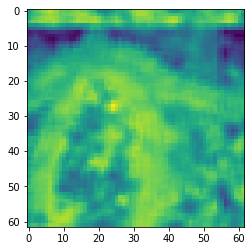

[[0.64938804 0.61554509 0.58438116 ... 0.7413262  0.74863117 0.73330044]
 [0.57786386 0.54772281 0.56009493 ... 0.82252954 0.85501034 0.83207107]
 [0.63221409 0.59762985 0.6155149  ... 0.84550336 0.87598727 0.85099525]
 ...
 [0.64119667 0.62444152 0.62210151 ... 0.65587904 0.64477071 0.56190639]
 [0.62021054 0.59303561 0.59476012 ... 0.66316655 0.63719747 0.54381159]
 [0.65072547 0.65078653 0.66377968 ... 0.70839089 0.62568323 0.5392406 ]]


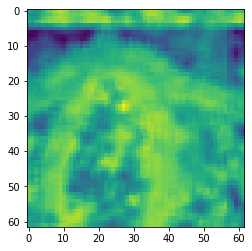

[[0.73330044 0.71311109 0.74413807 ... 0.72021684 0.69717943 0.71266752]
 [0.83207107 0.77639319 0.72076969 ... 0.74268282 0.74993431 0.7665299 ]
 [0.85099525 0.80282031 0.70718136 ... 0.78521746 0.79017317 0.79595112]
 ...
 [0.56190639 0.55884202 0.59368781 ... 0.6745259  0.62496213 0.64761267]
 [0.54381159 0.55613444 0.58341313 ... 0.6544096  0.61167158 0.65965677]
 [0.5392406  0.54109907 0.60546232 ... 0.65874355 0.65408226 0.70339358]]


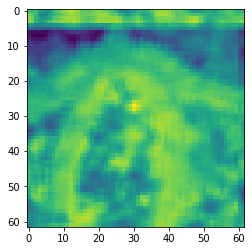

[[0.71266752 0.7413262  0.74863117 ... 0.76090968 0.77347177 0.7567811 ]
 [0.7665299  0.82252954 0.85501034 ... 0.73747835 0.77928711 0.76658838]
 [0.79595112 0.84550336 0.87598727 ... 0.73466832 0.76330838 0.78690054]
 ...
 [0.64761267 0.65587904 0.64477071 ... 0.73169983 0.74196814 0.73466711]
 [0.65965677 0.66316655 0.63719747 ... 0.7299264  0.73612751 0.71825986]
 [0.70339358 0.70839089 0.62568323 ... 0.75415341 0.75162501 0.71491717]]


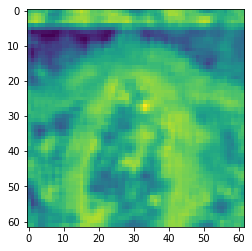

[[0.7567811  0.72021684 0.69717943 ... 0.6355562  0.69940763 0.72400804]
 [0.76658838 0.74268282 0.74993431 ... 0.67475652 0.70557255 0.70811257]
 [0.78690054 0.78521746 0.79017317 ... 0.70581695 0.72809965 0.73853031]
 ...
 [0.73466711 0.6745259  0.62496213 ... 0.67568799 0.70362641 0.71521011]
 [0.71825986 0.6544096  0.61167158 ... 0.73340967 0.73323096 0.70818136]
 [0.71491717 0.65874355 0.65408226 ... 0.70943017 0.71986983 0.71447739]]


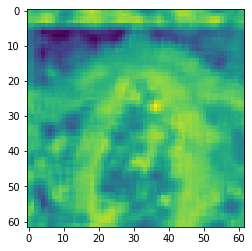

[[0.71447739 0.75415341 0.75162501 ... 0.63311916 0.68955375 0.75365435]
 [0.75117608 0.78512027 0.74787383 ... 0.61765879 0.67561925 0.70389468]
 [0.74135244 0.79896368 0.78549826 ... 0.64733798 0.68980546 0.69137419]
 ...
 [0.66424528 0.73489663 0.76881947 ... 0.5302465  0.47545018 0.46287295]
 [0.69490422 0.74437899 0.76806676 ... 0.56994839 0.51884661 0.48701606]
 [0.72492357 0.75912931 0.7883299  ... 0.68015406 0.65056544 0.62192816]]


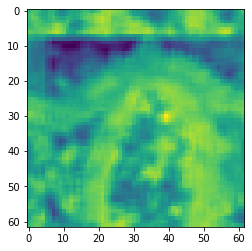

[[0.75365435 0.70943017 0.71986983 ... 0.52408148 0.49581856 0.52077434]
 [0.70389468 0.69285831 0.73085777 ... 0.47225223 0.4659613  0.53917812]
 [0.69137419 0.65535847 0.7010085  ... 0.5156678  0.49501084 0.5856681 ]
 ...
 [0.46287295 0.50153324 0.58978985 ... 0.71387042 0.65998416 0.6118352 ]
 [0.48701606 0.55148061 0.63422187 ... 0.73989594 0.69324786 0.64742391]
 [0.62192816 0.63257877 0.67788079 ... 0.73473533 0.70385319 0.72629777]]


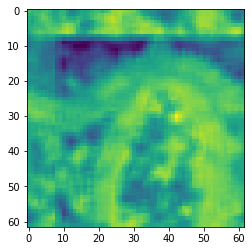

[[0.52077434 0.63311916 0.68955375 ... 0.68205339 0.64984954 0.56605348]
 [0.53917812 0.61765879 0.67561925 ... 0.69886124 0.64937705 0.52476271]
 [0.5856681  0.64733798 0.68980546 ... 0.74585238 0.68853929 0.56301762]
 ...
 [0.6118352  0.5302465  0.47545018 ... 0.83884181 0.79564361 0.77137332]
 [0.64742391 0.56994839 0.51884661 ... 0.82084668 0.77324962 0.7655725 ]
 [0.72629777 0.68015406 0.65056544 ... 0.8190824  0.77683234 0.76272849]]


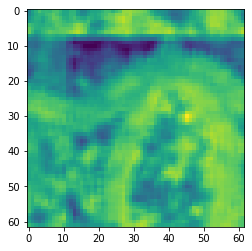

[[0.56605348 0.52408148 0.49581856 ... 0.82619683 0.77763801 0.74662707]
 [0.52476271 0.47225223 0.4659613  ... 0.84070123 0.79232758 0.77670459]
 [0.56301762 0.5156678  0.49501084 ... 0.83523132 0.79484693 0.79618605]
 ...
 [0.77137332 0.71387042 0.65998416 ... 0.83031169 0.84620474 0.84596365]
 [0.7655725  0.73989594 0.69324786 ... 0.84499563 0.8524395  0.82390048]
 [0.76272849 0.73473533 0.70385319 ... 0.87074714 0.86572748 0.8341245 ]]


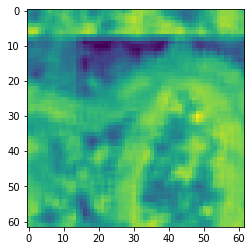

[[0.74662707 0.68205339 0.64984954 ... 0.8579457  0.85346122 0.86040804]
 [0.77670459 0.69886124 0.64937705 ... 0.86619492 0.85409297 0.8617694 ]
 [0.79618605 0.74585238 0.68853929 ... 0.88011601 0.86545526 0.86418199]
 ...
 [0.84596365 0.83884181 0.79564361 ... 0.83671238 0.83527008 0.82732652]
 [0.82390048 0.82084668 0.77324962 ... 0.83501921 0.8376022  0.83862339]
 [0.8341245  0.8190824  0.77683234 ... 0.84363637 0.83679111 0.85949261]]


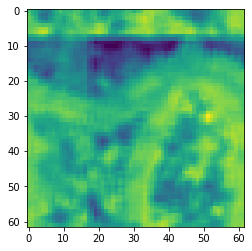

[[0.86040804 0.82619683 0.77763801 ... 0.75623703 0.82140369 0.85537797]
 [0.8617694  0.84070123 0.79232758 ... 0.75552955 0.82256756 0.8510377 ]
 [0.86418199 0.83523132 0.79484693 ... 0.76407082 0.84249706 0.87604996]
 ...
 [0.82732652 0.83031169 0.84620474 ... 0.74253273 0.77264159 0.82208692]
 [0.83862339 0.84499563 0.8524395  ... 0.72926431 0.76663398 0.83083388]
 [0.85949261 0.87074714 0.86572748 ... 0.74150664 0.78996328 0.83423763]]


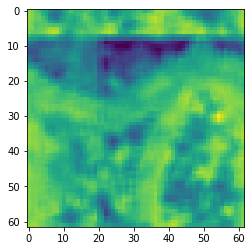

[[0.85537797 0.8579457  0.85346122 ... 0.66801713 0.70189505 0.75225554]
 [0.8510377  0.86619492 0.85409297 ... 0.66834362 0.70144828 0.73725746]
 [0.87604996 0.88011601 0.86545526 ... 0.65841616 0.68675671 0.71232588]
 ...
 [0.82208692 0.83671238 0.83527008 ... 0.64207376 0.70485602 0.71364648]
 [0.83083388 0.83501921 0.8376022  ... 0.58237679 0.59264242 0.65676722]
 [0.83423763 0.84363637 0.83679111 ... 0.58699565 0.60216365 0.65987803]]


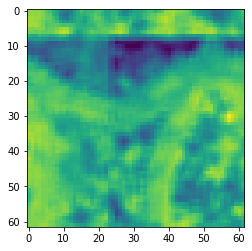

[[0.75225554 0.75623703 0.82140369 ... 0.52067505 0.5412347  0.60711878]
 [0.73725746 0.75552955 0.82256756 ... 0.51773343 0.54600271 0.63105448]
 [0.71232588 0.76407082 0.84249706 ... 0.53411128 0.58275583 0.6538599 ]
 ...
 [0.71364648 0.74253273 0.77264159 ... 0.653795   0.62936446 0.62418981]
 [0.65676722 0.72926431 0.76663398 ... 0.70728181 0.67258749 0.60201014]
 [0.65987803 0.74150664 0.78996328 ... 0.65374009 0.62354208 0.57760963]]


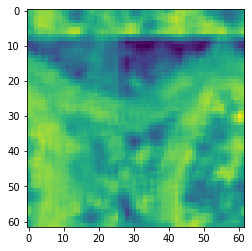

[[0.64796614 0.71296176 0.74911902 ... 0.4990067  0.50374524 0.51570192]
 [0.67351224 0.71331023 0.74864219 ... 0.4756949  0.47207467 0.50481589]
 [0.69785203 0.70271484 0.73296216 ... 0.52195589 0.5092827  0.51117443]
 ...
 [0.66618572 0.68527291 0.75227921 ... 0.59913833 0.65862984 0.70358937]
 [0.64251378 0.62155949 0.6325158  ... 0.68682915 0.71788795 0.73022351]
 [0.61647159 0.6264891  0.64267763 ... 0.72220528 0.6972466  0.70824321]]


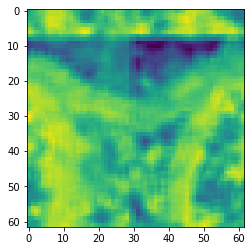

[[0.48319241 0.52067505 0.5412347  ... 0.58883271 0.5658205  0.50538818]
 [0.47299263 0.51773343 0.54600271 ... 0.58746051 0.55706796 0.50011602]
 [0.47895034 0.53411128 0.58275583 ... 0.67204368 0.60825942 0.57835529]
 ...
 [0.65923556 0.653795   0.62936446 ... 0.60920367 0.54110133 0.51935045]
 [0.68419071 0.70728181 0.67258749 ... 0.61930757 0.59556132 0.59385947]
 [0.66359602 0.65374009 0.62354208 ... 0.64147615 0.65164306 0.65564542]]


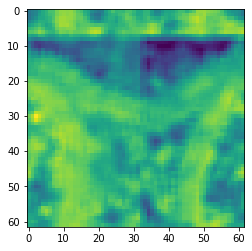

[[0.50538818 0.46754965 0.47198948 ... 0.67674547 0.62566314 0.59259888]
 [0.50011602 0.44570741 0.44231539 ... 0.71400337 0.64652205 0.62577048]
 [0.57835529 0.48905214 0.47717785 ... 0.79422597 0.7325299  0.73317264]
 ...
 [0.51935045 0.56136905 0.61711025 ... 0.80132536 0.75870063 0.71900116]
 [0.59385947 0.64353189 0.67263277 ... 0.81799173 0.77495925 0.71895382]
 [0.65564542 0.67667794 0.65329263 ... 0.76745274 0.69723939 0.65670227]]


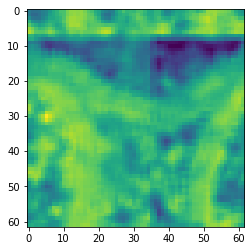

[[0.59259888 0.58883271 0.5658205  ... 0.8243269  0.80158369 0.75231429]
 [0.62577048 0.58746051 0.55706796 ... 0.80305477 0.7845508  0.76689731]
 [0.73317264 0.67204368 0.60825942 ... 0.79569715 0.79655257 0.81851198]
 ...
 [0.71900116 0.60920367 0.54110133 ... 0.80485864 0.82752396 0.8031387 ]
 [0.71895382 0.61930757 0.59556132 ... 0.87092475 0.87803981 0.83095195]
 [0.65670227 0.64147615 0.65164306 ... 0.89883787 0.87462833 0.81532176]]


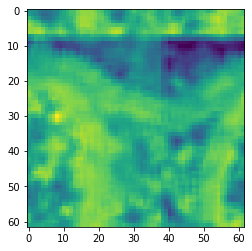

[[0.75231429 0.67674547 0.62566314 ... 0.87383602 0.84670726 0.8320087 ]
 [0.76689731 0.71400337 0.64652205 ... 0.87572047 0.82226647 0.81181587]
 [0.81851198 0.79422597 0.7325299  ... 0.86601164 0.78676921 0.78793293]
 ...
 [0.8031387  0.80132536 0.75870063 ... 0.7818297  0.71615547 0.75113884]
 [0.83095195 0.81799173 0.77495925 ... 0.82406041 0.7905257  0.82947099]
 [0.81532176 0.76745274 0.69723939 ... 0.86101691 0.84438393 0.87981476]]


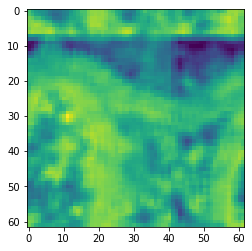

[[0.8320087  0.8243269  0.80158369 ... 0.78036273 0.86251995 0.8645219 ]
 [0.81181587 0.80305477 0.7845508  ... 0.8410465  0.86951153 0.85121004]
 [0.78793293 0.79569715 0.79655257 ... 0.88967211 0.91091158 0.87151279]
 ...
 [0.75113884 0.80485864 0.82752396 ... 0.83745999 0.87633927 0.83187133]
 [0.82947099 0.87092475 0.87803981 ... 0.82695175 0.86750911 0.83826387]
 [0.87981476 0.89883787 0.87462833 ... 0.77965636 0.84993214 0.8618616 ]]


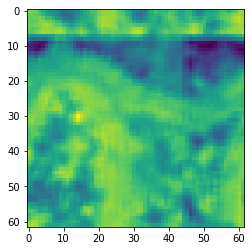

[[0.8645219  0.87383602 0.84670726 ... 0.74092197 0.70140321 0.73986212]
 [0.85121004 0.87572047 0.82226647 ... 0.78901666 0.78665188 0.83162593]
 [0.87151279 0.86601164 0.78676921 ... 0.79870776 0.80917882 0.86053794]
 ...
 [0.83187133 0.7818297  0.71615547 ... 0.78755995 0.79233163 0.79844585]
 [0.83826387 0.82406041 0.7905257  ... 0.74743458 0.74122064 0.7694063 ]
 [0.8618616  0.86101691 0.84438393 ... 0.67742076 0.66660049 0.70026778]]


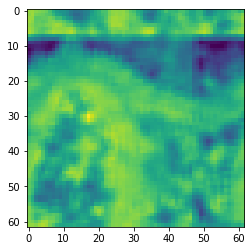

[[0.73986212 0.78036273 0.86251995 ... 0.66377968 0.70102112 0.74018015]
 [0.83162593 0.8410465  0.86951153 ... 0.68798464 0.72741536 0.75454859]
 [0.86053794 0.88967211 0.91091158 ... 0.67523127 0.72250078 0.7791277 ]
 ...
 [0.79844585 0.83745999 0.87633927 ... 0.69486556 0.71613738 0.73526304]
 [0.7694063  0.82695175 0.86750911 ... 0.65635363 0.67808574 0.71275167]
 [0.70026778 0.77965636 0.84993214 ... 0.6091384  0.6350207  0.67804777]]


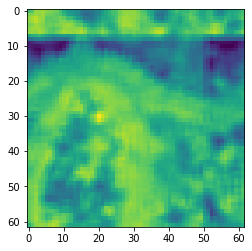

[[0.74018015 0.74092197 0.70140321 ... 0.60546232 0.65072547 0.65078653]
 [0.75454859 0.78901666 0.78665188 ... 0.6384253  0.67446757 0.6577019 ]
 [0.7791277  0.79870776 0.80917882 ... 0.70750165 0.68485764 0.65318461]
 ...
 [0.73526304 0.78755995 0.79233163 ... 0.58314638 0.64990051 0.6834857 ]
 [0.71275167 0.74743458 0.74122064 ... 0.55326319 0.60916938 0.65241407]
 [0.67804777 0.67742076 0.66660049 ... 0.58631736 0.60132911 0.6008623 ]]


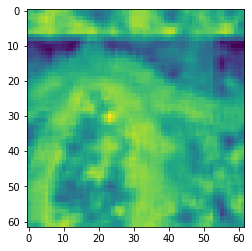

[[0.65078653 0.66377968 0.70102112 ... 0.62568323 0.5392406  0.54109907]
 [0.6577019  0.68798464 0.72741536 ... 0.62479305 0.56613279 0.57161127]
 [0.65318461 0.67523127 0.72250078 ... 0.69578567 0.67156619 0.65951888]
 ...
 [0.6834857  0.69486556 0.71613738 ... 0.4910169  0.47876116 0.51586944]
 [0.65241407 0.65635363 0.67808574 ... 0.54666296 0.51107682 0.51196453]
 [0.6008623  0.6091384  0.6350207  ... 0.625713   0.57189059 0.56279957]]


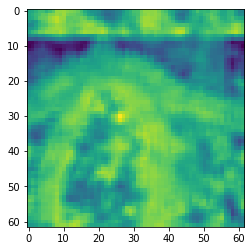

[[0.54109907 0.60546232 0.65072547 ... 0.65408226 0.70339358 0.70839089]
 [0.57161127 0.6384253  0.67446757 ... 0.66500887 0.70872359 0.71006192]
 [0.65951888 0.70750165 0.68485764 ... 0.67427897 0.71407606 0.74767424]
 ...
 [0.51586944 0.58314638 0.64990051 ... 0.65979925 0.61105651 0.43597192]
 [0.51196453 0.55326319 0.60916938 ... 0.68032798 0.62170943 0.51935991]
 [0.56279957 0.58631736 0.60132911 ... 0.65500884 0.62964047 0.61534008]]


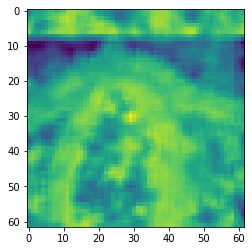

[[0.70839089 0.62568323 0.5392406  ... 0.75162501 0.71491717 0.65874355]
 [0.71006192 0.62479305 0.56613279 ... 0.74787383 0.70201807 0.65854302]
 [0.74767424 0.69578567 0.67156619 ... 0.78549826 0.74431956 0.68620101]
 ...
 [0.43597192 0.4910169  0.47876116 ... 0.76881947 0.80498965 0.83278907]
 [0.51935991 0.54666296 0.51107682 ... 0.76806676 0.79098563 0.78176712]
 [0.61534008 0.625713   0.57189059 ... 0.7883299  0.79256914 0.73605241]]


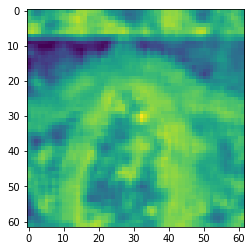

[[0.65874355 0.65408226 0.70339358 ... 0.71986983 0.71447739 0.75415341]
 [0.65854302 0.66500887 0.70872359 ... 0.73085777 0.75117608 0.78512027]
 [0.68620101 0.67427897 0.71407606 ... 0.7010085  0.74135244 0.79896368]
 ...
 [0.83278907 0.65979925 0.61105651 ... 0.58978985 0.66424528 0.73489663]
 [0.78176712 0.68032798 0.62170943 ... 0.63422187 0.69490422 0.74437899]
 [0.73605241 0.65500884 0.62964047 ... 0.67788079 0.72492357 0.75912931]]


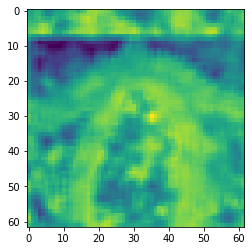

[[0.75415341 0.75162501 0.71491717 ... 0.68955375 0.75365435 0.70943017]
 [0.78512027 0.74787383 0.70201807 ... 0.67561925 0.70389468 0.69285831]
 [0.79896368 0.78549826 0.74431956 ... 0.68980546 0.69137419 0.65535847]
 ...
 [0.73489663 0.76881947 0.80498965 ... 0.47545018 0.46287295 0.50153324]
 [0.74437899 0.76806676 0.79098563 ... 0.51884661 0.48701606 0.55148061]
 [0.75912931 0.7883299  0.79256914 ... 0.65056544 0.62192816 0.63257877]]


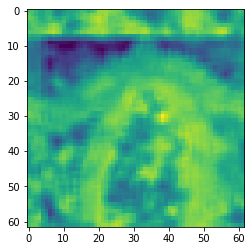

[[0.63257877 0.67788079 0.72492357 ... 0.70385319 0.72629777 0.68015406]
 [0.67568799 0.70362641 0.71521011 ... 0.68908588 0.70916994 0.69021052]
 [0.73340967 0.73323096 0.70818136 ... 0.59406968 0.59937035 0.66565629]
 ...
 [0.71464832 0.73053874 0.75696202 ... 0.82393045 0.74049954 0.67810152]
 [0.61706649 0.64144154 0.6804075  ... 0.82797962 0.74449691 0.66035657]
 [0.51795474 0.58909636 0.65497649 ... 0.7526735  0.66462006 0.55928343]]


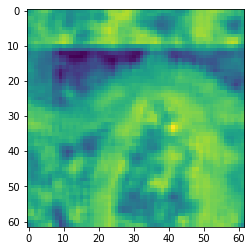

[[0.68015406 0.65056544 0.62192816 ... 0.77683234 0.76272849 0.73473533]
 [0.69021052 0.66703206 0.69245387 ... 0.735536   0.74103715 0.7250935 ]
 [0.66565629 0.69092941 0.7758     ... 0.71660787 0.66699882 0.63014599]
 ...
 [0.67810152 0.64934996 0.6487705  ... 0.81209851 0.81281487 0.83721659]
 [0.66035657 0.57150414 0.56350973 ... 0.80544074 0.81493436 0.83839877]
 [0.55928343 0.50228252 0.49766583 ... 0.82547247 0.82711431 0.79440841]]


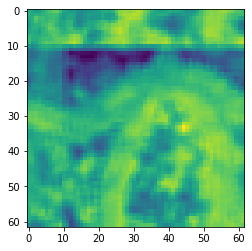

[[0.73473533 0.70385319 0.72629777 ... 0.86572748 0.8341245  0.8190824 ]
 [0.7250935  0.68908588 0.70916994 ... 0.82756224 0.77756822 0.74933386]
 [0.63014599 0.59406968 0.59937035 ... 0.81002883 0.76434236 0.74264848]
 ...
 [0.83721659 0.82393045 0.74049954 ... 0.84063733 0.79999897 0.82580296]
 [0.83839877 0.82797962 0.74449691 ... 0.84838502 0.83172517 0.82973701]
 [0.79440841 0.7526735  0.66462006 ... 0.83645594 0.84740427 0.85308718]]


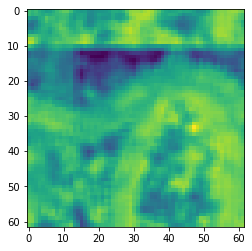

[[0.8190824  0.77683234 0.76272849 ... 0.83679111 0.85949261 0.87074714]
 [0.74933386 0.735536   0.74103715 ... 0.83562077 0.85147548 0.84530646]
 [0.74264848 0.71660787 0.66699882 ... 0.84665099 0.8624397  0.84103088]
 ...
 [0.82580296 0.81209851 0.81281487 ... 0.8521737  0.84983127 0.82685045]
 [0.82973701 0.80544074 0.81493436 ... 0.83691728 0.83901805 0.81688171]
 [0.85308718 0.82547247 0.82711431 ... 0.82072882 0.82143398 0.81321116]]


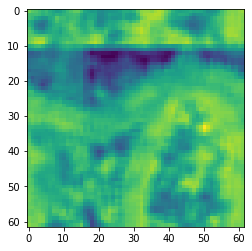

[[0.87074714 0.86572748 0.8341245  ... 0.78996328 0.83423763 0.84363637]
 [0.84530646 0.82756224 0.77756822 ... 0.80255119 0.83490388 0.85479434]
 [0.84103088 0.81002883 0.76434236 ... 0.82143072 0.85568758 0.86098456]
 ...
 [0.82685045 0.84063733 0.79999897 ... 0.76201523 0.80565116 0.8448651 ]
 [0.81688171 0.84838502 0.83172517 ... 0.77365984 0.81317171 0.85336976]
 [0.81321116 0.83645594 0.84740427 ... 0.76992029 0.81198291 0.84051221]]


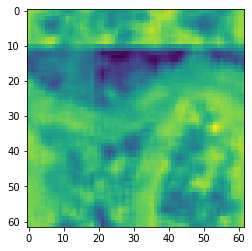

[[0.84363637 0.83679111 0.85949261 ... 0.60216365 0.65987803 0.74150664]
 [0.85479434 0.83562077 0.85147548 ... 0.65310151 0.70794106 0.75395056]
 [0.86098456 0.84665099 0.8624397  ... 0.70958401 0.75661401 0.76715607]
 ...
 [0.8448651  0.8521737  0.84983127 ... 0.81898284 0.79266528 0.72179167]
 [0.85336976 0.83691728 0.83901805 ... 0.86947124 0.81901966 0.75012848]
 [0.84051221 0.82072882 0.82143398 ... 0.83019693 0.77296888 0.74122658]]


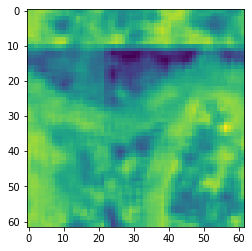

[[0.74150664 0.78996328 0.83423763 ... 0.62354208 0.57760963 0.58699565]
 [0.75395056 0.80255119 0.83490388 ... 0.62404402 0.61551706 0.61758584]
 [0.76715607 0.82143072 0.85568758 ... 0.56882138 0.59968785 0.66336588]
 ...
 [0.72179167 0.76201523 0.80565116 ... 0.62044615 0.7048465  0.8283636 ]
 [0.75012848 0.77365984 0.81317171 ... 0.63694776 0.74237773 0.82480475]
 [0.74122658 0.76992029 0.81198291 ... 0.64508369 0.72183527 0.76515097]]


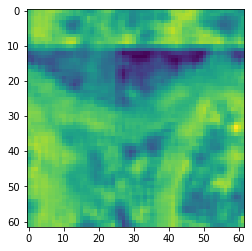

[[0.64020334 0.65674624 0.71969209 ... 0.71250976 0.72374709 0.71299778]
 [0.67356636 0.71230131 0.77211175 ... 0.61966154 0.63934168 0.64422353]
 [0.72349608 0.77390362 0.82519661 ... 0.52386513 0.5687236  0.5999846 ]
 ...
 [0.90344988 0.89321881 0.86451572 ... 0.7556585  0.67003127 0.62117303]
 [0.89956845 0.94828369 0.89325897 ... 0.68982349 0.65485382 0.65430529]
 [0.8345074  0.90544939 0.84303395 ... 0.6543447  0.70687913 0.6966635 ]]


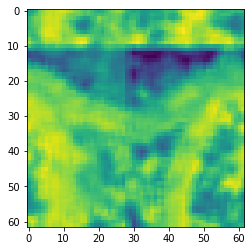

[[0.65374009 0.62354208 0.57760963 ... 0.65164306 0.65564542 0.67667794]
 [0.59068171 0.62404402 0.61551706 ... 0.67867452 0.66717917 0.62160146]
 [0.55011951 0.56882138 0.59968785 ... 0.61224805 0.5752824  0.51355609]
 ...
 [0.56954695 0.62044615 0.7048465  ... 0.5899269  0.65713332 0.68697391]
 [0.59992557 0.63694776 0.74237773 ... 0.59177754 0.61845305 0.64794437]
 [0.63876336 0.64508369 0.72183527 ... 0.56335626 0.54295664 0.57251992]]


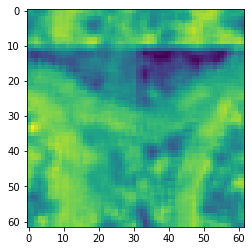

[[0.67667794 0.65329263 0.66359602 ... 0.69723939 0.65670227 0.64147615]
 [0.62160146 0.56816108 0.5862056  ... 0.66897952 0.65843289 0.67887653]
 [0.51355609 0.48032637 0.52145663 ... 0.66811863 0.64176467 0.62748832]
 ...
 [0.68697391 0.69285526 0.61434455 ... 0.66005264 0.60120652 0.55781767]
 [0.64794437 0.63249184 0.60042852 ... 0.66099615 0.62532918 0.58090793]
 [0.57251992 0.5999617  0.64812997 ... 0.76770971 0.72032118 0.61545358]]


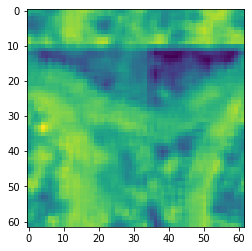

[[0.64147615 0.65164306 0.65564542 ... 0.87462833 0.81532176 0.76745274]
 [0.67887653 0.67867452 0.66717917 ... 0.86081285 0.79661852 0.73006162]
 [0.62748832 0.61224805 0.5752824  ... 0.83787668 0.77399549 0.70219562]
 ...
 [0.55781767 0.5899269  0.65713332 ... 0.6512798  0.60730617 0.65287331]
 [0.58090793 0.59177754 0.61845305 ... 0.73077136 0.6656919  0.66788975]
 [0.61545358 0.56335626 0.54295664 ... 0.77585906 0.76596558 0.78402924]]


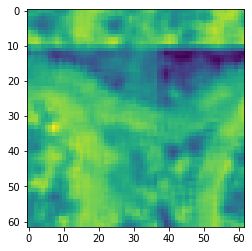

[[0.76745274 0.69723939 0.65670227 ... 0.84438393 0.87981476 0.89883787]
 [0.73006162 0.66897952 0.65843289 ... 0.89026304 0.90250968 0.89869429]
 [0.70219562 0.66811863 0.64176467 ... 0.89156314 0.89058396 0.87967623]
 ...
 [0.65287331 0.66005264 0.60120652 ... 0.72779566 0.69491826 0.65640512]
 [0.66788975 0.66099615 0.62532918 ... 0.75676017 0.76470961 0.76456698]
 [0.78402924 0.76770971 0.72032118 ... 0.70956991 0.72020211 0.76170052]]


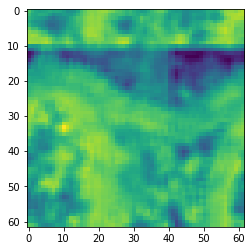

[[0.89883787 0.87462833 0.81532176 ... 0.84993214 0.8618616  0.86101691]
 [0.89869429 0.86081285 0.79661852 ... 0.84591332 0.87654859 0.88714219]
 [0.87967623 0.83787668 0.77399549 ... 0.80743805 0.84955311 0.88533142]
 ...
 [0.65640512 0.6512798  0.60730617 ... 0.86010668 0.83450296 0.76244686]
 [0.76456698 0.73077136 0.6656919  ... 0.85803558 0.83320397 0.79527104]
 [0.76170052 0.77585906 0.76596558 ... 0.86597751 0.82352549 0.7781327 ]]


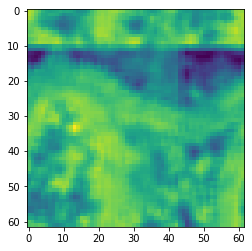

[[0.86101691 0.84438393 0.87981476 ... 0.66660049 0.70026778 0.77965636]
 [0.88714219 0.89026304 0.90250968 ... 0.62186    0.64173711 0.73843728]
 [0.88533142 0.89156314 0.89058396 ... 0.61931473 0.65630946 0.70416059]
 ...
 [0.76244686 0.72779566 0.69491826 ... 0.78993193 0.8084248  0.83090099]
 [0.79527104 0.75676017 0.76470961 ... 0.78613947 0.80037317 0.82865959]
 [0.7781327  0.70956991 0.72020211 ... 0.79380439 0.79874973 0.83651321]]


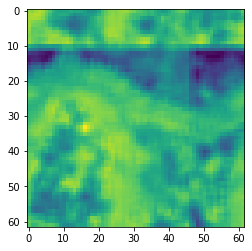

[[0.77965636 0.84993214 0.8618616  ... 0.6350207  0.67804777 0.67742076]
 [0.73843728 0.84591332 0.87654859 ... 0.61254499 0.67147021 0.63260828]
 [0.70416059 0.80743805 0.84955311 ... 0.61534424 0.66851229 0.62665525]
 ...
 [0.83090099 0.86010668 0.83450296 ... 0.71164911 0.73690125 0.78008583]
 [0.82865959 0.85803558 0.83320397 ... 0.7057643  0.73989036 0.77290445]
 [0.83651321 0.86597751 0.82352549 ... 0.71955938 0.73381201 0.78544004]]


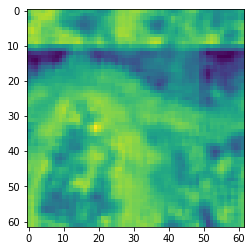

[[0.67742076 0.66660049 0.70026778 ... 0.60132911 0.6008623  0.6091384 ]
 [0.63260828 0.62186    0.64173711 ... 0.64119667 0.62444152 0.62210151]
 [0.62665525 0.61931473 0.65630946 ... 0.62021054 0.59303561 0.59476012]
 ...
 [0.78008583 0.78993193 0.8084248  ... 0.82302964 0.76345391 0.75315362]
 [0.77290445 0.78613947 0.80037317 ... 0.79642035 0.75872677 0.72139171]
 [0.78544004 0.79380439 0.79874973 ... 0.7100555  0.71631362 0.70996241]]


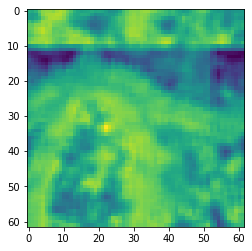

[[0.6091384  0.6350207  0.67804777 ... 0.57189059 0.56279957 0.58631736]
 [0.62210151 0.61254499 0.67147021 ... 0.56190639 0.55884202 0.59368781]
 [0.59476012 0.61534424 0.66851229 ... 0.54381159 0.55613444 0.58341313]
 ...
 [0.75315362 0.71164911 0.73690125 ... 0.64822501 0.78283528 0.81687167]
 [0.72139171 0.7057643  0.73989036 ... 0.5570729  0.67595921 0.76726535]
 [0.70996241 0.71955938 0.73381201 ... 0.49104372 0.58914322 0.67029634]]


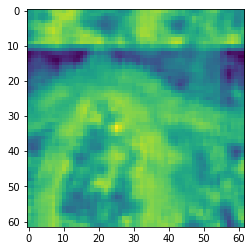

[[0.58631736 0.60132911 0.6008623  ... 0.62964047 0.61534008 0.625713  ]
 [0.59368781 0.64119667 0.62444152 ... 0.64761267 0.65587904 0.64477071]
 [0.58341313 0.62021054 0.59303561 ... 0.65965677 0.66316655 0.63719747]
 ...
 [0.81687167 0.82302964 0.76345391 ... 0.42774242 0.38126669 0.50548942]
 [0.76726535 0.79642035 0.75872677 ... 0.49334186 0.34362967 0.4373266 ]
 [0.67029634 0.7100555  0.71631362 ... 0.55832745 0.33785414 0.40912083]]


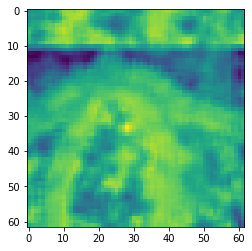

[[0.625713   0.57189059 0.56279957 ... 0.79256914 0.73605241 0.65500884]
 [0.64477071 0.56190639 0.55884202 ... 0.73466711 0.6745259  0.62496213]
 [0.63719747 0.54381159 0.55613444 ... 0.71825986 0.6544096  0.61167158]
 ...
 [0.50548942 0.64822501 0.78283528 ... 0.66423865 0.64401827 0.52817893]
 [0.4373266  0.5570729  0.67595921 ... 0.68226308 0.71698249 0.59035133]
 [0.40912083 0.49104372 0.58914322 ... 0.74434202 0.79693081 0.62469102]]


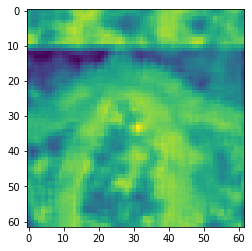

[[0.65500884 0.62964047 0.61534008 ... 0.72492357 0.75912931 0.7883299 ]
 [0.62496213 0.64761267 0.65587904 ... 0.71521011 0.73169983 0.74196814]
 [0.61167158 0.65965677 0.66316655 ... 0.70818136 0.7299264  0.73612751]
 ...
 [0.52817893 0.42774242 0.38126669 ... 0.75696202 0.73539668 0.70979816]
 [0.59035133 0.49334186 0.34362967 ... 0.6804075  0.66266124 0.68548664]
 [0.62469102 0.55832745 0.33785414 ... 0.65497649 0.69310076 0.72456652]]


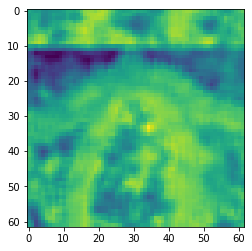

[[0.7883299  0.79256914 0.73605241 ... 0.62192816 0.63257877 0.67788079]
 [0.74196814 0.73466711 0.6745259  ... 0.69245387 0.67568799 0.70362641]
 [0.73612751 0.71825986 0.6544096  ... 0.7758     0.73340967 0.73323096]
 ...
 [0.70979816 0.66423865 0.64401827 ... 0.6487705  0.71464832 0.73053874]
 [0.68548664 0.68226308 0.71698249 ... 0.56350973 0.61706649 0.64144154]
 [0.72456652 0.74434202 0.79693081 ... 0.49766583 0.51795474 0.58909636]]


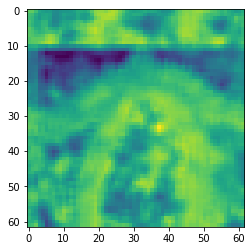

[[0.67788079 0.72492357 0.75912931 ... 0.72629777 0.68015406 0.65056544]
 [0.70362641 0.71521011 0.73169983 ... 0.70916994 0.69021052 0.66703206]
 [0.73323096 0.70818136 0.7299264  ... 0.59937035 0.66565629 0.69092941]
 ...
 [0.73053874 0.75696202 0.73539668 ... 0.74049954 0.67810152 0.64934996]
 [0.64144154 0.6804075  0.66266124 ... 0.74449691 0.66035657 0.57150414]
 [0.58909636 0.65497649 0.69310076 ... 0.66462006 0.55928343 0.50228252]]


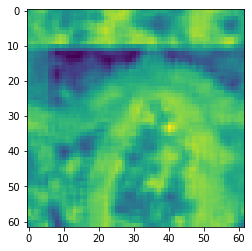

[[0.50228252 0.49766583 0.51795474 ... 0.82711431 0.79440841 0.7526735 ]
 [0.47545018 0.46287295 0.50153324 ... 0.77137332 0.71387042 0.65998416]
 [0.51884661 0.48701606 0.55148061 ... 0.7655725  0.73989594 0.69324786]
 ...
 [0.74857563 0.74378932 0.71492028 ... 0.78418812 0.7807587  0.7554079 ]
 [0.7743254  0.76787895 0.76084152 ... 0.79860032 0.7982846  0.77078733]
 [0.72716765 0.73158334 0.78353323 ... 0.8136349  0.82898462 0.80560867]]


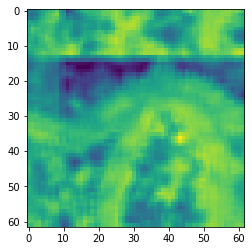

[[0.7526735  0.66462006 0.55928343 ... 0.84740427 0.85308718 0.82547247]
 [0.65998416 0.6118352  0.5302465  ... 0.84596365 0.83884181 0.79564361]
 [0.69324786 0.64742391 0.56994839 ... 0.82390048 0.82084668 0.77324962]
 ...
 [0.7554079  0.74554908 0.7015685  ... 0.80278134 0.80612997 0.80642722]
 [0.77078733 0.74327697 0.69839432 ... 0.79183568 0.79354731 0.78361281]
 [0.80560867 0.74783108 0.68925933 ... 0.77914537 0.79135988 0.78633769]]


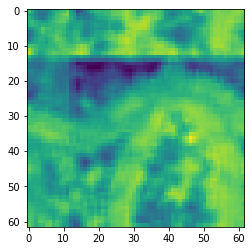

[[0.82547247 0.82711431 0.79440841 ... 0.82143398 0.81321116 0.83645594]
 [0.79564361 0.77137332 0.71387042 ... 0.82732652 0.83031169 0.84620474]
 [0.77324962 0.7655725  0.73989594 ... 0.83862339 0.84499563 0.8524395 ]
 ...
 [0.80642722 0.78418812 0.7807587  ... 0.8425294  0.82045812 0.82100272]
 [0.78361281 0.79860032 0.7982846  ... 0.84279878 0.82237208 0.82338317]
 [0.78633769 0.8136349  0.82898462 ... 0.85142946 0.82814786 0.82582064]]


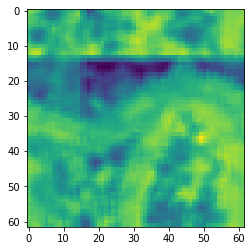

[[0.83645594 0.84740427 0.85308718 ... 0.81198291 0.84051221 0.82072882]
 [0.84620474 0.84596365 0.83884181 ... 0.82208692 0.83671238 0.83527008]
 [0.8524395  0.82390048 0.82084668 ... 0.83083388 0.83501921 0.8376022 ]
 ...
 [0.82100272 0.80278134 0.80612997 ... 0.7150628  0.78663552 0.83198151]
 [0.82338317 0.79183568 0.79354731 ... 0.73522397 0.80039541 0.84862553]
 [0.82582064 0.77914537 0.79135988 ... 0.78674591 0.84288288 0.86878775]]


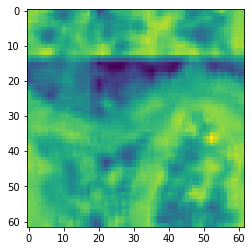

[[0.82072882 0.82143398 0.81321116 ... 0.77296888 0.74122658 0.76992029]
 [0.83527008 0.82732652 0.83031169 ... 0.71364648 0.74253273 0.77264159]
 [0.8376022  0.83862339 0.84499563 ... 0.65676722 0.72926431 0.76663398]
 ...
 [0.83198151 0.8425294  0.82045812 ... 0.57326831 0.60614976 0.65801451]
 [0.84862553 0.84279878 0.82237208 ... 0.62607852 0.64736106 0.68704686]
 [0.86878775 0.85142946 0.82814786 ... 0.71472721 0.71489735 0.75708866]]


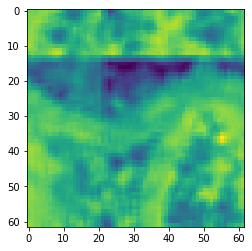

[[0.76992029 0.81198291 0.84051221 ... 0.72183527 0.76515097 0.83019693]
 [0.77264159 0.82208692 0.83671238 ... 0.62418981 0.64207376 0.70485602]
 [0.76663398 0.83083388 0.83501921 ... 0.60201014 0.58237679 0.59264242]
 ...
 [0.65801451 0.7150628  0.78663552 ... 0.53499268 0.52215238 0.5445562 ]
 [0.68704686 0.73522397 0.80039541 ... 0.5321785  0.58104041 0.58734818]
 [0.75708866 0.78674591 0.84288288 ... 0.56142879 0.67175347 0.67035682]]


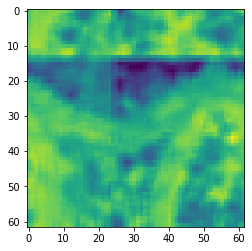

[[0.83019693 0.77296888 0.74122658 ... 0.64812997 0.63876336 0.64508369]
 [0.70485602 0.71364648 0.74253273 ... 0.65923556 0.653795   0.62936446]
 [0.59264242 0.65676722 0.72926431 ... 0.68419071 0.70728181 0.67258749]
 ...
 [0.5445562  0.57326831 0.60614976 ... 0.66112632 0.59892252 0.60217449]
 [0.58734818 0.62607852 0.64736106 ... 0.63237476 0.58211746 0.60974227]
 [0.67035682 0.71472721 0.71489735 ... 0.63200477 0.56447707 0.57858076]]


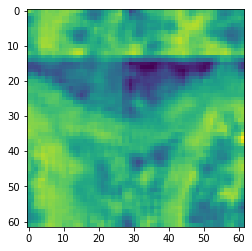

[[0.64508369 0.72183527 0.76515097 ... 0.54295664 0.57251992 0.5999617 ]
 [0.62936446 0.62418981 0.64207376 ... 0.51935045 0.56136905 0.61711025]
 [0.67258749 0.60201014 0.58237679 ... 0.59385947 0.64353189 0.67263277]
 ...
 [0.60217449 0.53499268 0.52215238 ... 0.63928976 0.60368416 0.66302529]
 [0.60974227 0.5321785  0.58104041 ... 0.64863965 0.65964105 0.68748696]
 [0.57858076 0.56142879 0.67175347 ... 0.66071983 0.69678861 0.72371021]]


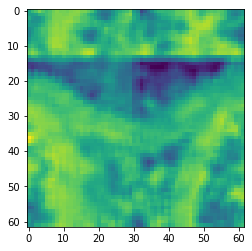

[[0.5999617  0.64812997 0.63876336 ... 0.72032118 0.61545358 0.56335626]
 [0.61711025 0.65923556 0.653795   ... 0.71900116 0.60920367 0.54110133]
 [0.67263277 0.68419071 0.70728181 ... 0.71895382 0.61930757 0.59556132]
 ...
 [0.66302529 0.66112632 0.59892252 ... 0.47251167 0.52691034 0.53294104]
 [0.68748696 0.63237476 0.58211746 ... 0.53708351 0.53112049 0.54459996]
 [0.72371021 0.63200477 0.56447707 ... 0.53483196 0.52044758 0.55227886]]


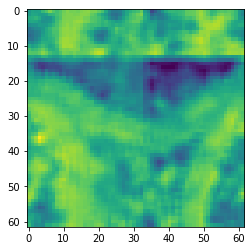

[[0.56335626 0.54295664 0.57251992 ... 0.76596558 0.78402924 0.76770971]
 [0.54110133 0.51935045 0.56136905 ... 0.8031387  0.80132536 0.75870063]
 [0.59556132 0.59385947 0.64353189 ... 0.83095195 0.81799173 0.77495925]
 ...
 [0.53294104 0.63928976 0.60368416 ... 0.49901946 0.47679787 0.49479232]
 [0.54459996 0.64863965 0.65964105 ... 0.52485407 0.55738288 0.59093063]
 [0.55227886 0.66071983 0.69678861 ... 0.53033281 0.55489583 0.56975201]]


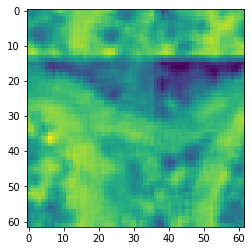

[[0.76770971 0.72032118 0.61545358 ... 0.72020211 0.76170052 0.77585906]
 [0.75870063 0.71900116 0.60920367 ... 0.75113884 0.80485864 0.82752396]
 [0.77495925 0.71895382 0.61930757 ... 0.82947099 0.87092475 0.87803981]
 ...
 [0.49479232 0.47251167 0.52691034 ... 0.45997051 0.46907132 0.47147864]
 [0.59093063 0.53708351 0.53112049 ... 0.46026356 0.47097191 0.48155262]
 [0.56975201 0.53483196 0.52044758 ... 0.63123145 0.60976998 0.58702357]]


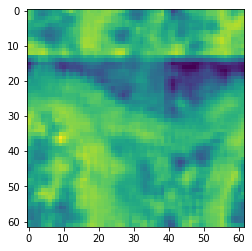

[[0.77585906 0.76596558 0.78402924 ... 0.82352549 0.7781327  0.70956991]
 [0.82752396 0.8031387  0.80132536 ... 0.83187133 0.7818297  0.71615547]
 [0.87803981 0.83095195 0.81799173 ... 0.83826387 0.82406041 0.7905257 ]
 ...
 [0.47147864 0.49901946 0.47679787 ... 0.75220816 0.66579403 0.49498733]
 [0.48155262 0.52485407 0.55738288 ... 0.75925422 0.66897941 0.5176223 ]
 [0.58702357 0.53033281 0.55489583 ... 0.79230938 0.71323305 0.6581582 ]]


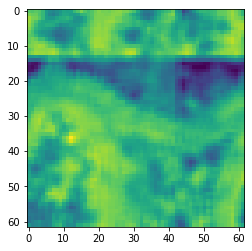

[[0.70956991 0.72020211 0.76170052 ... 0.79874973 0.83651321 0.86597751]
 [0.71615547 0.75113884 0.80485864 ... 0.79844585 0.83745999 0.87633927]
 [0.7905257  0.82947099 0.87092475 ... 0.7694063  0.82695175 0.86750911]
 ...
 [0.49498733 0.45997051 0.46907132 ... 0.79486208 0.80958668 0.84458609]
 [0.5176223  0.46026356 0.47097191 ... 0.79844107 0.8201514  0.85745117]
 [0.6581582  0.63123145 0.60976998 ... 0.79886176 0.81908282 0.84850793]]


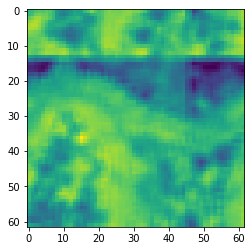

[[0.86597751 0.82352549 0.7781327  ... 0.73381201 0.78544004 0.79380439]
 [0.87633927 0.83187133 0.7818297  ... 0.73526304 0.78755995 0.79233163]
 [0.86750911 0.83826387 0.82406041 ... 0.71275167 0.74743458 0.74122064]
 ...
 [0.84458609 0.75220816 0.66579403 ... 0.76079703 0.77565163 0.79249525]
 [0.85745117 0.75925422 0.66897941 ... 0.74029701 0.78576843 0.79646989]
 [0.84850793 0.79230938 0.71323305 ... 0.71751236 0.76933167 0.78149016]]


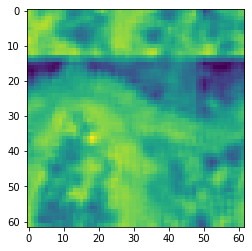

[[0.79380439 0.79874973 0.83651321 ... 0.71631362 0.70996241 0.71955938]
 [0.79233163 0.79844585 0.83745999 ... 0.6834857  0.69486556 0.71613738]
 [0.74122064 0.7694063  0.82695175 ... 0.65241407 0.65635363 0.67808574]
 ...
 [0.79249525 0.79486208 0.80958668 ... 0.76926435 0.77361161 0.73518405]
 [0.79646989 0.79844107 0.8201514  ... 0.80514827 0.78405869 0.72016882]
 [0.78149016 0.79886176 0.81908282 ... 0.74759514 0.73243076 0.6811894 ]]


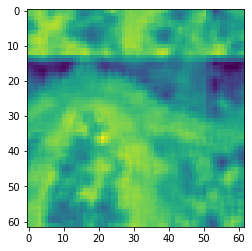

[[0.71955938 0.73381201 0.78544004 ... 0.58914322 0.67029634 0.7100555 ]
 [0.71613738 0.73526304 0.78755995 ... 0.51586944 0.58314638 0.64990051]
 [0.67808574 0.71275167 0.74743458 ... 0.51196453 0.55326319 0.60916938]
 ...
 [0.73518405 0.76079703 0.77565163 ... 0.73018442 0.73360711 0.79585797]
 [0.72016882 0.74029701 0.78576843 ... 0.77146594 0.76905892 0.84348054]
 [0.6811894  0.71751236 0.76933167 ... 0.79054479 0.78706473 0.82732379]]


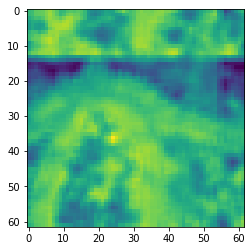

[[0.7100555  0.71631362 0.70996241 ... 0.33785414 0.40912083 0.49104372]
 [0.64990051 0.6834857  0.69486556 ... 0.43597192 0.4910169  0.47876116]
 [0.60916938 0.65241407 0.65635363 ... 0.51935991 0.54666296 0.51107682]
 ...
 [0.79585797 0.76926435 0.77361161 ... 0.52495199 0.6261704  0.69732569]
 [0.84348054 0.80514827 0.78405869 ... 0.4628628  0.60056578 0.69725995]
 [0.82732379 0.74759514 0.73243076 ... 0.41905641 0.55142402 0.68403845]]


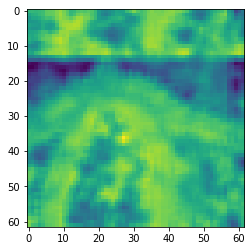

[[0.49104372 0.58914322 0.67029634 ... 0.79693081 0.62469102 0.55832745]
 [0.47876116 0.51586944 0.58314638 ... 0.83278907 0.65979925 0.61105651]
 [0.51107682 0.51196453 0.55326319 ... 0.78176712 0.68032798 0.62170943]
 ...
 [0.69732569 0.73018442 0.73360711 ... 0.62649568 0.51753621 0.49594226]
 [0.69725995 0.77146594 0.76905892 ... 0.59443936 0.47385205 0.42186889]
 [0.68403845 0.79054479 0.78706473 ... 0.59859534 0.49710225 0.40050677]]


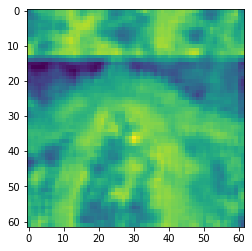

[[0.55832745 0.33785414 0.40912083 ... 0.69310076 0.72456652 0.74434202]
 [0.61105651 0.43597192 0.4910169  ... 0.73489663 0.76881947 0.80498965]
 [0.62170943 0.51935991 0.54666296 ... 0.74437899 0.76806676 0.79098563]
 ...
 [0.49594226 0.52495199 0.6261704  ... 0.68658541 0.67981657 0.65394241]
 [0.42186889 0.4628628  0.60056578 ... 0.74950705 0.70920166 0.64608027]
 [0.40050677 0.41905641 0.55142402 ... 0.74347019 0.69166182 0.62187767]]


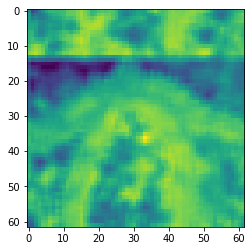

[[0.74434202 0.79693081 0.62469102 ... 0.51795474 0.58909636 0.65497649]
 [0.80498965 0.83278907 0.65979925 ... 0.50153324 0.58978985 0.66424528]
 [0.79098563 0.78176712 0.68032798 ... 0.55148061 0.63422187 0.69490422]
 ...
 [0.65394241 0.62649568 0.51753621 ... 0.71492028 0.70496742 0.65304792]
 [0.64608027 0.59443936 0.47385205 ... 0.76084152 0.78589875 0.69922439]
 [0.62187767 0.59859534 0.49710225 ... 0.78353323 0.79714965 0.72670157]]


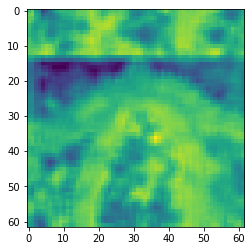

[[0.65497649 0.69310076 0.72456652 ... 0.55928343 0.50228252 0.49766583]
 [0.66424528 0.73489663 0.76881947 ... 0.5302465  0.47545018 0.46287295]
 [0.69490422 0.74437899 0.76806676 ... 0.56994839 0.51884661 0.48701606]
 ...
 [0.65304792 0.68658541 0.67981657 ... 0.7015685  0.74857563 0.74378932]
 [0.69922439 0.74950705 0.70920166 ... 0.69839432 0.7743254  0.76787895]
 [0.72670157 0.74347019 0.69166182 ... 0.68925933 0.72716765 0.73158334]]


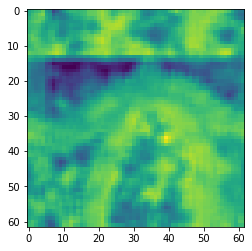

[[0.49766583 0.51795474 0.58909636 ... 0.79440841 0.7526735  0.66462006]
 [0.46287295 0.50153324 0.58978985 ... 0.71387042 0.65998416 0.6118352 ]
 [0.48701606 0.55148061 0.63422187 ... 0.73989594 0.69324786 0.64742391]
 ...
 [0.74378932 0.71492028 0.70496742 ... 0.7807587  0.7554079  0.74554908]
 [0.76787895 0.76084152 0.78589875 ... 0.7982846  0.77078733 0.74327697]
 [0.73158334 0.78353323 0.79714965 ... 0.82898462 0.80560867 0.74783108]]


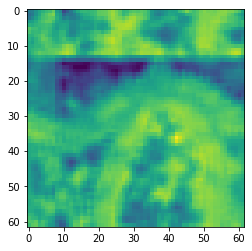

[[0.74783108 0.68925933 0.72716765 ... 0.79135988 0.78633769 0.8136349 ]
 [0.74049954 0.67810152 0.64934996 ... 0.82580296 0.81209851 0.81281487]
 [0.74449691 0.66035657 0.57150414 ... 0.82973701 0.80544074 0.81493436]
 ...
 [0.71576071 0.6897861  0.6888449  ... 0.81064868 0.78824807 0.76609196]
 [0.72920541 0.69781528 0.68740097 ... 0.81099543 0.77949417 0.75471557]
 [0.74866762 0.71150096 0.72283559 ... 0.79573596 0.78766487 0.76337097]]


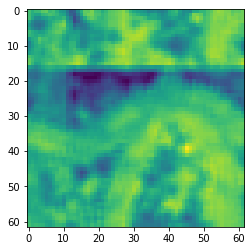

[[0.8136349  0.82898462 0.80560867 ... 0.82814786 0.82582064 0.77914537]
 [0.81281487 0.83721659 0.82393045 ... 0.82685045 0.84063733 0.79999897]
 [0.81493436 0.83839877 0.82797962 ... 0.81688171 0.84838502 0.83172517]
 ...
 [0.76609196 0.7411437  0.72327679 ... 0.81934063 0.8182335  0.80562971]
 [0.75471557 0.75637582 0.73930043 ... 0.82469115 0.8272976  0.82189364]
 [0.76337097 0.77481289 0.75172536 ... 0.82115792 0.82416865 0.81095788]]


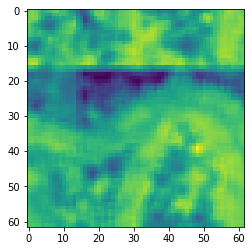

[[0.77914537 0.79135988 0.78633769 ... 0.84288288 0.86878775 0.85142946]
 [0.79999897 0.82580296 0.81209851 ... 0.8448651  0.8521737  0.84983127]
 [0.83172517 0.82973701 0.80544074 ... 0.85336976 0.83691728 0.83901805]
 ...
 [0.80562971 0.81064868 0.78824807 ... 0.82062842 0.83958021 0.83797997]
 [0.82189364 0.81099543 0.77949417 ... 0.79764076 0.82603274 0.8438985 ]
 [0.81095788 0.79573596 0.78766487 ... 0.7842334  0.81881344 0.84221032]]


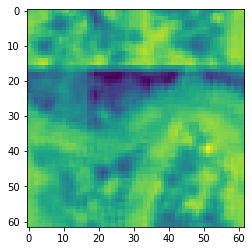

[[0.85142946 0.82814786 0.82582064 ... 0.71489735 0.75708866 0.78674591]
 [0.84983127 0.82685045 0.84063733 ... 0.72179167 0.76201523 0.80565116]
 [0.83901805 0.81688171 0.84838502 ... 0.75012848 0.77365984 0.81317171]
 ...
 [0.83797997 0.81934063 0.8182335  ... 0.77165396 0.81417155 0.82175196]
 [0.8438985  0.82469115 0.8272976  ... 0.68537015 0.73032237 0.75023062]
 [0.84221032 0.82115792 0.82416865 ... 0.62709482 0.68703987 0.72299316]]


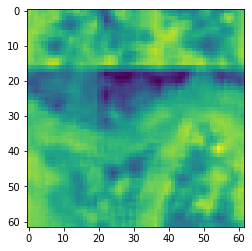

[[0.78674591 0.84288288 0.86878775 ... 0.67175347 0.67035682 0.71472721]
 [0.80565116 0.8448651  0.8521737  ... 0.8283636  0.81898284 0.79266528]
 [0.81317171 0.85336976 0.83691728 ... 0.82480475 0.86947124 0.81901966]
 ...
 [0.82175196 0.82062842 0.83958021 ... 0.52557443 0.60447668 0.69322472]
 [0.75023062 0.79764076 0.82603274 ... 0.52276619 0.58040614 0.65156338]
 [0.72299316 0.7842334  0.81881344 ... 0.51619693 0.54806335 0.58686906]]


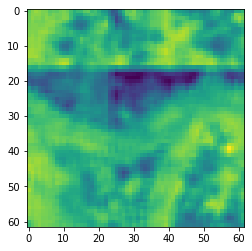

[[0.71472721 0.71489735 0.75708866 ... 0.56447707 0.57858076 0.56142879]
 [0.79266528 0.72179167 0.76201523 ... 0.56954695 0.62044615 0.7048465 ]
 [0.81901966 0.75012848 0.77365984 ... 0.59992557 0.63694776 0.74237773]
 ...
 [0.69322472 0.77165396 0.81417155 ... 0.5079505  0.43232543 0.45582047]
 [0.65156338 0.68537015 0.73032237 ... 0.53155401 0.50311349 0.49611655]
 [0.58686906 0.62709482 0.68703987 ... 0.59757389 0.57480949 0.53535221]]


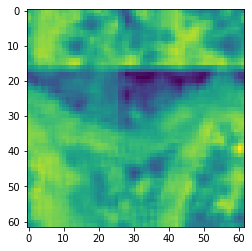

[[0.59920209 0.71694949 0.71545887 ... 0.74366902 0.77240191 0.67452648]
 [0.75226905 0.88409646 0.87408456 ... 0.73319398 0.73947102 0.65567807]
 [0.7923254  0.88029817 0.92796985 ... 0.6915385  0.67504631 0.64082575]
 ...
 [0.48648838 0.56093543 0.64514628 ... 0.70390376 0.71857129 0.64798635]
 [0.5294956  0.55793824 0.61945626 ... 0.63015054 0.63261358 0.60762363]
 [0.57137106 0.55092701 0.58493741 ... 0.63930824 0.67757788 0.69080778]]


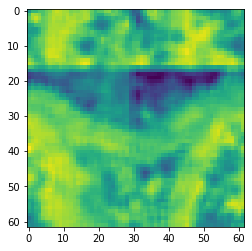

[[0.63200477 0.56447707 0.57858076 ... 0.52044758 0.55227886 0.66071983]
 [0.61434455 0.56954695 0.62044615 ... 0.55781767 0.5899269  0.65713332]
 [0.60042852 0.59992557 0.63694776 ... 0.58090793 0.59177754 0.61845305]
 ...
 [0.60713772 0.5079505  0.43232543 ... 0.57820503 0.54046617 0.57412294]
 [0.56931944 0.53155401 0.50311349 ... 0.54560921 0.51436671 0.56608009]
 [0.64725972 0.59757389 0.57480949 ... 0.53477642 0.52933034 0.62887861]]


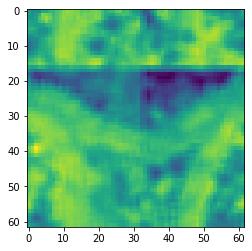

[[0.66071983 0.69678861 0.72371021 ... 0.55489583 0.56975201 0.53483196]
 [0.65713332 0.68697391 0.69285526 ... 0.65287331 0.66005264 0.60120652]
 [0.61845305 0.64794437 0.63249184 ... 0.66788975 0.66099615 0.62532918]
 ...
 [0.57412294 0.65953013 0.67327303 ... 0.48380028 0.56381114 0.53856857]
 [0.56608009 0.59042627 0.59273404 ... 0.47339102 0.5089059  0.50901808]
 [0.62887861 0.59900667 0.63486382 ... 0.48764402 0.5063481  0.48754725]]


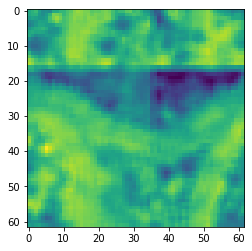

[[0.53483196 0.52044758 0.55227886 ... 0.60976998 0.58702357 0.53033281]
 [0.60120652 0.55781767 0.5899269  ... 0.65640512 0.6512798  0.60730617]
 [0.62532918 0.58090793 0.59177754 ... 0.76456698 0.73077136 0.6656919 ]
 ...
 [0.53856857 0.57820503 0.54046617 ... 0.53786319 0.46580741 0.45043545]
 [0.50901808 0.54560921 0.51436671 ... 0.5247524  0.48987301 0.47976153]
 [0.48754725 0.53477642 0.52933034 ... 0.50999109 0.49783229 0.50502219]]


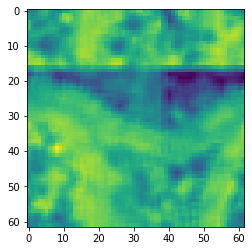

[[0.53033281 0.55489583 0.56975201 ... 0.71323305 0.6581582  0.63123145]
 [0.60730617 0.65287331 0.66005264 ... 0.76244686 0.72779566 0.69491826]
 [0.6656919  0.66788975 0.66099615 ... 0.79527104 0.75676017 0.76470961]
 ...
 [0.45043545 0.48380028 0.56381114 ... 0.75639191 0.66021841 0.585739  ]
 [0.47976153 0.47339102 0.5089059  ... 0.73431595 0.61153363 0.55304961]
 [0.50502219 0.48764402 0.5063481  ... 0.71618371 0.56694482 0.53145188]]


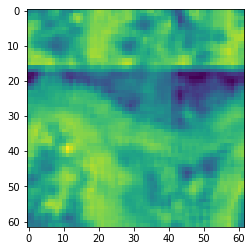

[[0.63123145 0.60976998 0.58702357 ... 0.81908282 0.84850793 0.79230938]
 [0.69491826 0.65640512 0.6512798  ... 0.83090099 0.86010668 0.83450296]
 [0.76470961 0.76456698 0.73077136 ... 0.82865959 0.85803558 0.83320397]
 ...
 [0.585739   0.53786319 0.46580741 ... 0.83659847 0.8518644  0.79097558]
 [0.55304961 0.5247524  0.48987301 ... 0.81588629 0.84069107 0.78110761]
 [0.53145188 0.50999109 0.49783229 ... 0.82122224 0.85747121 0.78175907]]


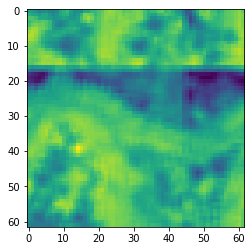

[[0.79230938 0.71323305 0.6581582  ... 0.76933167 0.78149016 0.79886176]
 [0.83450296 0.76244686 0.72779566 ... 0.78008583 0.78993193 0.8084248 ]
 [0.83320397 0.79527104 0.75676017 ... 0.77290445 0.78613947 0.80037317]
 ...
 [0.79097558 0.75639191 0.66021841 ... 0.77848055 0.80655413 0.82501744]
 [0.78110761 0.73431595 0.61153363 ... 0.78815035 0.81354665 0.81487961]
 [0.78175907 0.71618371 0.56694482 ... 0.78077638 0.80039909 0.80333508]]


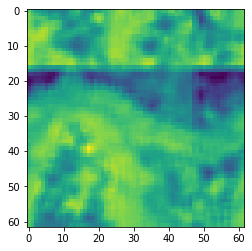

[[0.79886176 0.81908282 0.84850793 ... 0.73243076 0.6811894  0.71751236]
 [0.8084248  0.83090099 0.86010668 ... 0.75315362 0.71164911 0.73690125]
 [0.80037317 0.82865959 0.85803558 ... 0.72139171 0.7057643  0.73989036]
 ...
 [0.82501744 0.83659847 0.8518644  ... 0.6759813  0.66205942 0.74316857]
 [0.81487961 0.81588629 0.84069107 ... 0.73527961 0.70634156 0.77148198]
 [0.80333508 0.82122224 0.85747121 ... 0.72146707 0.68919832 0.76136476]]


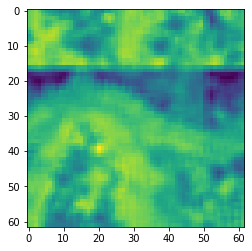

[[0.71751236 0.76933167 0.78149016 ... 0.78706473 0.82732379 0.74759514]
 [0.73690125 0.78008583 0.78993193 ... 0.81687167 0.82302964 0.76345391]
 [0.73989036 0.77290445 0.78613947 ... 0.76726535 0.79642035 0.75872677]
 ...
 [0.74316857 0.77848055 0.80655413 ... 0.63739379 0.67639178 0.60975436]
 [0.77148198 0.78815035 0.81354665 ... 0.65765283 0.6916776  0.65640959]
 [0.76136476 0.78077638 0.80039909 ... 0.67827029 0.7284872  0.6925671 ]]


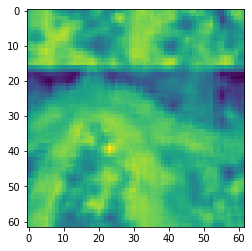

[[0.74759514 0.73243076 0.6811894  ... 0.55142402 0.68403845 0.79054479]
 [0.76345391 0.75315362 0.71164911 ... 0.50548942 0.64822501 0.78283528]
 [0.75872677 0.72139171 0.7057643  ... 0.4373266  0.5570729  0.67595921]
 ...
 [0.60975436 0.6759813  0.66205942 ... 0.71099617 0.71434207 0.65868128]
 [0.65640959 0.73527961 0.70634156 ... 0.69543787 0.71872668 0.68294252]
 [0.6925671  0.72146707 0.68919832 ... 0.66360843 0.7197425  0.70102996]]


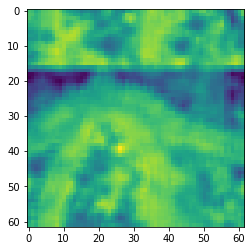

[[0.79054479 0.78706473 0.82732379 ... 0.49710225 0.40050677 0.41905641]
 [0.78283528 0.81687167 0.82302964 ... 0.52817893 0.42774242 0.38126669]
 [0.67595921 0.76726535 0.79642035 ... 0.59035133 0.49334186 0.34362967]
 ...
 [0.65868128 0.63739379 0.67639178 ... 0.71805212 0.72519195 0.73357608]
 [0.68294252 0.65765283 0.6916776  ... 0.66538176 0.6431009  0.67959394]
 [0.70102996 0.67827029 0.7284872  ... 0.59265273 0.582591   0.61095869]]


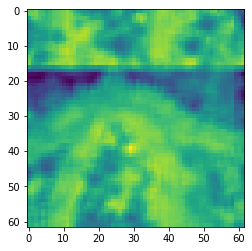

[[0.41905641 0.55142402 0.68403845 ... 0.69166182 0.62187767 0.59859534]
 [0.38126669 0.50548942 0.64822501 ... 0.70979816 0.66423865 0.64401827]
 [0.34362967 0.4373266  0.5570729  ... 0.68548664 0.68226308 0.71698249]
 ...
 [0.73357608 0.71099617 0.71434207 ... 0.77635327 0.79693329 0.78296776]
 [0.67959394 0.69543787 0.71872668 ... 0.73853731 0.77024452 0.75662227]
 [0.61095869 0.66360843 0.7197425  ... 0.71567146 0.71755286 0.69585741]]


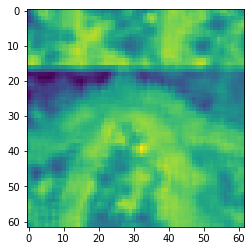

[[0.59859534 0.49710225 0.40050677 ... 0.79714965 0.72670157 0.74347019]
 [0.64401827 0.52817893 0.42774242 ... 0.73053874 0.75696202 0.73539668]
 [0.71698249 0.59035133 0.49334186 ... 0.64144154 0.6804075  0.66266124]
 ...
 [0.78296776 0.71805212 0.72519195 ... 0.6748617  0.68831976 0.73425589]
 [0.75662227 0.66538176 0.6431009  ... 0.64157308 0.64282336 0.68738919]
 [0.69585741 0.59265273 0.582591   ... 0.66089091 0.63997531 0.67626582]]


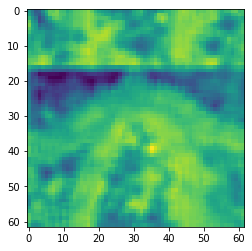

[[0.74347019 0.69166182 0.62187767 ... 0.72716765 0.73158334 0.78353323]
 [0.73539668 0.70979816 0.66423865 ... 0.64934996 0.6487705  0.71464832]
 [0.66266124 0.68548664 0.68226308 ... 0.57150414 0.56350973 0.61706649]
 ...
 [0.73425589 0.77635327 0.79693329 ... 0.6888449  0.67945568 0.68194647]
 [0.68738919 0.73853731 0.77024452 ... 0.68740097 0.67308265 0.67132205]
 [0.67626582 0.71567146 0.71755286 ... 0.72283559 0.71240303 0.70440999]]


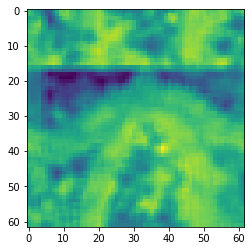

[[0.78353323 0.79714965 0.72670157 ... 0.80560867 0.74783108 0.68925933]
 [0.71464832 0.73053874 0.75696202 ... 0.82393045 0.74049954 0.67810152]
 [0.61706649 0.64144154 0.6804075  ... 0.82797962 0.74449691 0.66035657]
 ...
 [0.68194647 0.6748617  0.68831976 ... 0.72327679 0.71576071 0.6897861 ]
 [0.67132205 0.64157308 0.64282336 ... 0.73930043 0.72920541 0.69781528]
 [0.70440999 0.66089091 0.63997531 ... 0.75172536 0.74866762 0.71150096]]


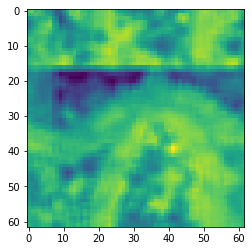

[[0.68925933 0.72716765 0.73158334 ... 0.78633769 0.8136349  0.82898462]
 [0.67810152 0.64934996 0.6487705  ... 0.81209851 0.81281487 0.83721659]
 [0.66035657 0.57150414 0.56350973 ... 0.80544074 0.81493436 0.83839877]
 ...
 [0.6897861  0.6888449  0.67945568 ... 0.78824807 0.76609196 0.7411437 ]
 [0.69781528 0.68740097 0.67308265 ... 0.77949417 0.75471557 0.75637582]
 [0.71150096 0.72283559 0.71240303 ... 0.78766487 0.76337097 0.77481289]]


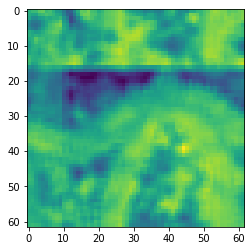

[[0.77481289 0.75172536 0.74866762 ... 0.82416865 0.81095788 0.79573596]
 [0.7807587  0.7554079  0.74554908 ... 0.82100272 0.80278134 0.80612997]
 [0.7982846  0.77078733 0.74327697 ... 0.82338317 0.79183568 0.79354731]
 ...
 [0.68893789 0.66429966 0.65000674 ... 0.82183958 0.81556973 0.78538886]
 [0.70756897 0.67199282 0.64662818 ... 0.82145439 0.80883224 0.79472786]
 [0.71932034 0.70631295 0.68557784 ... 0.82356493 0.81099906 0.79844917]]


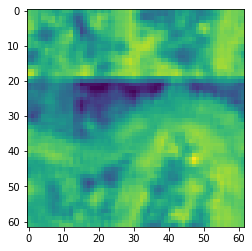

[[0.79573596 0.78766487 0.76337097 ... 0.81881344 0.84221032 0.82115792]
 [0.80612997 0.80642722 0.78418812 ... 0.83198151 0.8425294  0.82045812]
 [0.79354731 0.78361281 0.79860032 ... 0.84862553 0.84279878 0.82237208]
 ...
 [0.78538886 0.77879673 0.71534323 ... 0.85731101 0.85929891 0.83854066]
 [0.79472786 0.7870042  0.73970245 ... 0.84509377 0.84598911 0.8283504 ]
 [0.79844917 0.7657754  0.73993017 ... 0.84839028 0.83986937 0.82657639]]


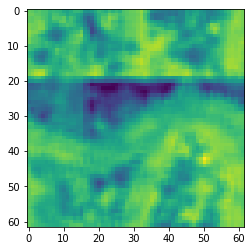

[[0.82115792 0.82416865 0.81095788 ... 0.68703987 0.72299316 0.7842334 ]
 [0.82045812 0.82100272 0.80278134 ... 0.65801451 0.7150628  0.78663552]
 [0.82237208 0.82338317 0.79183568 ... 0.68704686 0.73522397 0.80039541]
 ...
 [0.83854066 0.82183958 0.81556973 ... 0.84612206 0.86813007 0.84525071]
 [0.8283504  0.82145439 0.80883224 ... 0.82541767 0.85256178 0.83217642]
 [0.82657639 0.82356493 0.81099906 ... 0.81996396 0.84562501 0.82916901]]


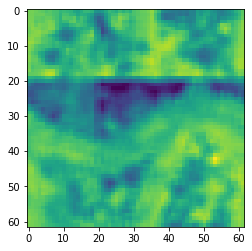

[[0.7842334  0.81881344 0.84221032 ... 0.54806335 0.58686906 0.62709482]
 [0.78663552 0.83198151 0.8425294  ... 0.5445562  0.57326831 0.60614976]
 [0.80039541 0.84862553 0.84279878 ... 0.58734818 0.62607852 0.64736106]
 ...
 [0.84525071 0.85731101 0.85929891 ... 0.66976084 0.68620007 0.81542847]
 [0.83217642 0.84509377 0.84598911 ... 0.64343964 0.67027577 0.80121749]
 [0.82916901 0.84839028 0.83986937 ... 0.62376875 0.70371234 0.8032116 ]]


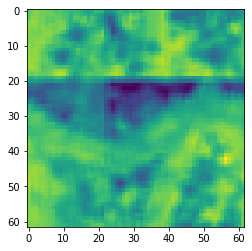

[[0.62709482 0.68703987 0.72299316 ... 0.57480949 0.53535221 0.51619693]
 [0.60614976 0.65801451 0.7150628  ... 0.60217449 0.53499268 0.52215238]
 [0.64736106 0.68704686 0.73522397 ... 0.60974227 0.5321785  0.58104041]
 ...
 [0.81542847 0.84612206 0.86813007 ... 0.66283553 0.64316558 0.59522504]
 [0.80121749 0.82541767 0.85256178 ... 0.60346958 0.61517257 0.58759673]
 [0.8032116  0.81996396 0.84562501 ... 0.50423976 0.5333196  0.55246052]]


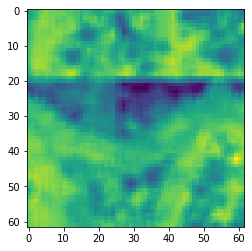

[[0.56298714 0.59774206 0.64006528 ... 0.69241049 0.70593    0.65174044]
 [0.56948241 0.59391701 0.62523171 ... 0.72312462 0.72105353 0.65321132]
 [0.6337083  0.64058783 0.68282885 ... 0.7498036  0.68969581 0.63488298]
 ...
 [0.64917869 0.73047071 0.74840006 ... 0.95472791 0.91764182 0.82997711]
 [0.64085891 0.70176366 0.73103232 ... 0.90841679 0.8232575  0.75448142]
 [0.60253781 0.68030971 0.76749972 ... 0.82497509 0.72026919 0.63277345]]


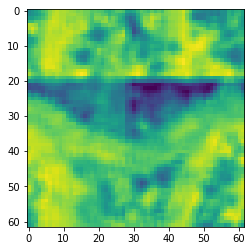

[[0.59757389 0.57480949 0.53535221 ... 0.52933034 0.62887861 0.59900667]
 [0.59892252 0.60217449 0.53499268 ... 0.53294104 0.63928976 0.60368416]
 [0.58211746 0.60974227 0.5321785  ... 0.54459996 0.64863965 0.65964105]
 ...
 [0.76099719 0.66283553 0.64316558 ... 0.79810663 0.82791746 0.85510227]
 [0.691776   0.60346958 0.61517257 ... 0.73097105 0.73298209 0.7776531 ]
 [0.58018326 0.50423976 0.5333196  ... 0.57384751 0.6143263  0.70883566]]


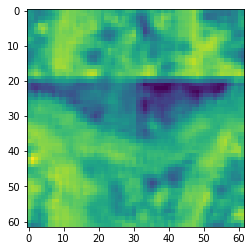

[[0.59900667 0.63486382 0.64725972 ... 0.5063481  0.48754725 0.53477642]
 [0.60368416 0.66302529 0.66112632 ... 0.49479232 0.47251167 0.52691034]
 [0.65964105 0.68748696 0.63237476 ... 0.59093063 0.53708351 0.53112049]
 ...
 [0.85510227 0.87537988 0.84137604 ... 0.5811912  0.66902401 0.73106898]
 [0.7776531  0.83291771 0.75483606 ... 0.61134093 0.68180494 0.73663345]
 [0.70883566 0.7564109  0.66040717 ... 0.618513   0.60715407 0.62925665]]


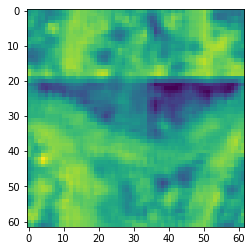

[[0.53477642 0.52933034 0.62887861 ... 0.49783229 0.50502219 0.48764402]
 [0.52691034 0.53294104 0.63928976 ... 0.47147864 0.49901946 0.47679787]
 [0.53112049 0.54459996 0.64863965 ... 0.48155262 0.52485407 0.55738288]
 ...
 [0.73106898 0.79810663 0.82791746 ... 0.65482418 0.63415035 0.60374607]
 [0.73663345 0.73097105 0.73298209 ... 0.57880569 0.5783819  0.5446029 ]
 [0.62925665 0.57384751 0.6143263  ... 0.47933579 0.47680439 0.49368566]]


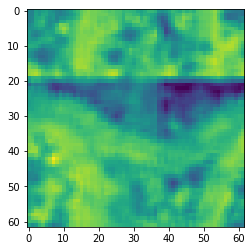

[[0.48764402 0.5063481  0.48754725 ... 0.56694482 0.53145188 0.50999109]
 [0.47679787 0.49479232 0.47251167 ... 0.49498733 0.45997051 0.46907132]
 [0.55738288 0.59093063 0.53708351 ... 0.5176223  0.46026356 0.47097191]
 ...
 [0.60374607 0.5811912  0.66902401 ... 0.71378243 0.61589488 0.64954629]
 [0.5446029  0.61134093 0.68180494 ... 0.70559926 0.62529615 0.62230331]
 [0.49368566 0.618513   0.60715407 ... 0.65890827 0.57736581 0.54071856]]


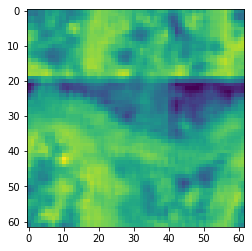

[[0.50999109 0.49783229 0.50502219 ... 0.85747121 0.78175907 0.71618371]
 [0.46907132 0.47147864 0.49901946 ... 0.84458609 0.75220816 0.66579403]
 [0.47097191 0.48155262 0.52485407 ... 0.85745117 0.75925422 0.66897941]
 ...
 [0.64954629 0.65482418 0.63415035 ... 0.81550673 0.82481727 0.7683424 ]
 [0.62230331 0.57880569 0.5783819  ... 0.82567637 0.79702979 0.76209507]
 [0.54071856 0.47933579 0.47680439 ... 0.82702091 0.78572504 0.74504245]]


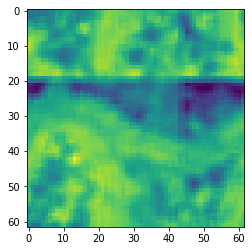

[[0.71618371 0.56694482 0.53145188 ... 0.80039909 0.80333508 0.82122224]
 [0.66579403 0.49498733 0.45997051 ... 0.79249525 0.79486208 0.80958668]
 [0.66897941 0.5176223  0.46026356 ... 0.79646989 0.79844107 0.8201514 ]
 ...
 [0.7683424  0.71378243 0.61589488 ... 0.72668296 0.75853617 0.7769481 ]
 [0.76209507 0.70559926 0.62529615 ... 0.75546049 0.79301281 0.80074926]
 [0.74504245 0.65890827 0.57736581 ... 0.79940988 0.81368271 0.81048107]]


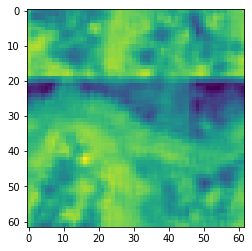

[[0.82122224 0.85747121 0.78175907 ... 0.68919832 0.76136476 0.78077638]
 [0.80958668 0.84458609 0.75220816 ... 0.73518405 0.76079703 0.77565163]
 [0.8201514  0.85745117 0.75925422 ... 0.72016882 0.74029701 0.78576843]
 ...
 [0.7769481  0.81550673 0.82481727 ... 0.61816142 0.68632892 0.70054274]
 [0.80074926 0.82567637 0.79702979 ... 0.67151991 0.71582513 0.7222994 ]
 [0.81048107 0.82702091 0.78572504 ... 0.69645728 0.73447831 0.76861925]]


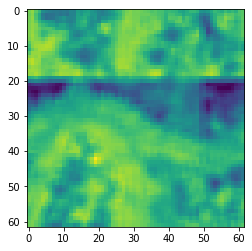

[[0.78077638 0.80039909 0.80333508 ... 0.7284872  0.6925671  0.72146707]
 [0.77565163 0.79249525 0.79486208 ... 0.79585797 0.76926435 0.77361161]
 [0.78576843 0.79646989 0.79844107 ... 0.84348054 0.80514827 0.78405869]
 ...
 [0.70054274 0.72668296 0.75853617 ... 0.67049182 0.62800215 0.63464104]
 [0.7222994  0.75546049 0.79301281 ... 0.68382535 0.65497281 0.70607339]
 [0.76861925 0.79940988 0.81368271 ... 0.7037562  0.65883843 0.72464636]]


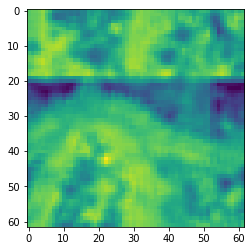

[[0.72146707 0.68919832 0.76136476 ... 0.7197425  0.70102996 0.67827029]
 [0.77361161 0.73518405 0.76079703 ... 0.69732569 0.73018442 0.73360711]
 [0.78405869 0.72016882 0.74029701 ... 0.69725995 0.77146594 0.76905892]
 ...
 [0.63464104 0.61816142 0.68632892 ... 0.69615061 0.67559679 0.70540325]
 [0.70607339 0.67151991 0.71582513 ... 0.70623006 0.66161464 0.68850857]
 [0.72464636 0.69645728 0.73447831 ... 0.73445942 0.68745561 0.6896065 ]]


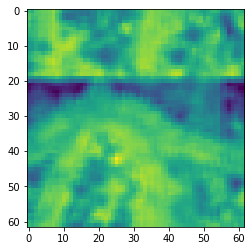

[[0.67827029 0.7284872  0.6925671  ... 0.582591   0.61095869 0.66360843]
 [0.73360711 0.79585797 0.76926435 ... 0.49594226 0.52495199 0.6261704 ]
 [0.76905892 0.84348054 0.80514827 ... 0.42186889 0.4628628  0.60056578]
 ...
 [0.70540325 0.67049182 0.62800215 ... 0.77643611 0.77983917 0.72214678]
 [0.68850857 0.68382535 0.65497281 ... 0.74430163 0.74560367 0.70145033]
 [0.6896065  0.7037562  0.65883843 ... 0.71881256 0.71437068 0.69813446]]


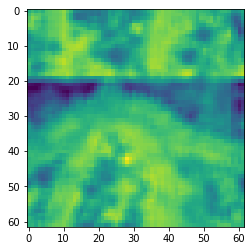

[[0.66360843 0.7197425  0.70102996 ... 0.71755286 0.69585741 0.59265273]
 [0.6261704  0.69732569 0.73018442 ... 0.65394241 0.62649568 0.51753621]
 [0.60056578 0.69725995 0.77146594 ... 0.64608027 0.59443936 0.47385205]
 ...
 [0.72214678 0.69615061 0.67559679 ... 0.68195772 0.65156906 0.73034446]
 [0.70145033 0.70623006 0.66161464 ... 0.71747092 0.70132879 0.71038978]
 [0.69813446 0.73445942 0.68745561 ... 0.78034364 0.76937453 0.70981715]]


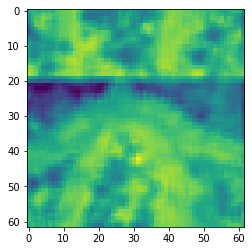

[[0.59265273 0.582591   0.61095869 ... 0.63997531 0.67626582 0.71567146]
 [0.51753621 0.49594226 0.52495199 ... 0.65304792 0.68658541 0.67981657]
 [0.47385205 0.42186889 0.4628628  ... 0.69922439 0.74950705 0.70920166]
 ...
 [0.73034446 0.77643611 0.77983917 ... 0.68720543 0.69420705 0.65199985]
 [0.71038978 0.74430163 0.74560367 ... 0.72897369 0.75208278 0.71101311]
 [0.70981715 0.71881256 0.71437068 ... 0.70630969 0.76538232 0.77030479]]


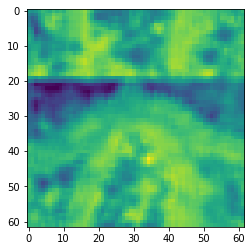

[[0.71567146 0.71755286 0.69585741 ... 0.71240303 0.70440999 0.66089091]
 [0.67981657 0.65394241 0.62649568 ... 0.74378932 0.71492028 0.70496742]
 [0.70920166 0.64608027 0.59443936 ... 0.76787895 0.76084152 0.78589875]
 ...
 [0.65199985 0.68195772 0.65156906 ... 0.68291849 0.68231215 0.66891278]
 [0.71101311 0.71747092 0.70132879 ... 0.66693813 0.69700214 0.72860727]
 [0.77030479 0.78034364 0.76937453 ... 0.66785472 0.68397282 0.70484188]]


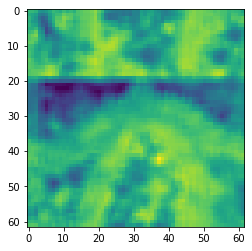

[[0.66089091 0.63997531 0.67626582 ... 0.74866762 0.71150096 0.72283559]
 [0.70496742 0.65304792 0.68658541 ... 0.74554908 0.7015685  0.74857563]
 [0.78589875 0.69922439 0.74950705 ... 0.74327697 0.69839432 0.7743254 ]
 ...
 [0.66891278 0.68720543 0.69420705 ... 0.65000674 0.68032703 0.65936709]
 [0.72860727 0.72897369 0.75208278 ... 0.64662818 0.66464115 0.65608557]
 [0.70484188 0.70630969 0.76538232 ... 0.68557784 0.67673579 0.67105983]]


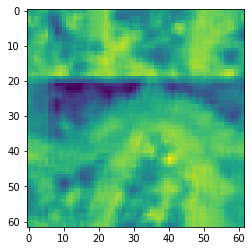

[[0.72283559 0.71240303 0.70440999 ... 0.76337097 0.77481289 0.75172536]
 [0.74857563 0.74378932 0.71492028 ... 0.78418812 0.7807587  0.7554079 ]
 [0.7743254  0.76787895 0.76084152 ... 0.79860032 0.7982846  0.77078733]
 ...
 [0.65936709 0.68291849 0.68231215 ... 0.71534323 0.68893789 0.66429966]
 [0.65608557 0.66693813 0.69700214 ... 0.73970245 0.70756897 0.67199282]
 [0.67105983 0.66785472 0.68397282 ... 0.73993017 0.71932034 0.70631295]]


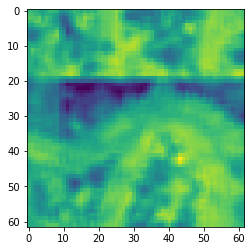

[[0.75172536 0.74866762 0.71150096 ... 0.81095788 0.79573596 0.78766487]
 [0.7554079  0.74554908 0.7015685  ... 0.80278134 0.80612997 0.80642722]
 [0.77078733 0.74327697 0.69839432 ... 0.79183568 0.79354731 0.78361281]
 ...
 [0.66429966 0.65000674 0.68032703 ... 0.81556973 0.78538886 0.77879673]
 [0.67199282 0.64662818 0.66464115 ... 0.80883224 0.79472786 0.7870042 ]
 [0.70631295 0.68557784 0.67673579 ... 0.81099906 0.79844917 0.7657754 ]]


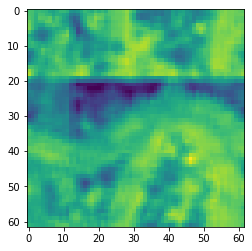

[[0.7657754  0.73993017 0.71932034 ... 0.83986937 0.82657639 0.82356493]
 [0.78824807 0.76609196 0.7411437  ... 0.83797997 0.81934063 0.8182335 ]
 [0.77949417 0.75471557 0.75637582 ... 0.8438985  0.82469115 0.8272976 ]
 ...
 [0.72750593 0.67810163 0.654938   ... 0.83828417 0.78930886 0.79781427]
 [0.75747033 0.69160534 0.64641161 ... 0.84666088 0.8131744  0.80955786]
 [0.75742757 0.69127311 0.66140443 ... 0.85425648 0.8238736  0.81009646]]


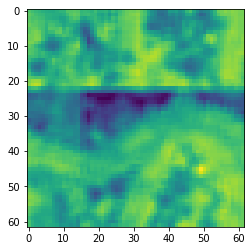

[[0.82356493 0.81099906 0.79844917 ... 0.84562501 0.82916901 0.84839028]
 [0.8182335  0.80562971 0.81064868 ... 0.82175196 0.82062842 0.83958021]
 [0.8272976  0.82189364 0.81099543 ... 0.75023062 0.79764076 0.82603274]
 ...
 [0.79781427 0.78402014 0.76902832 ... 0.86072097 0.84460103 0.83490682]
 [0.80955786 0.79582437 0.78218034 ... 0.85362121 0.84265631 0.85360328]
 [0.81009646 0.80870617 0.77928895 ... 0.85509796 0.83942359 0.8572732 ]]


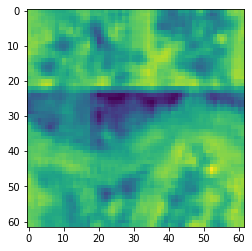

[[0.84839028 0.83986937 0.82657639 ... 0.70371234 0.8032116  0.81996396]
 [0.83958021 0.83797997 0.81934063 ... 0.69322472 0.77165396 0.81417155]
 [0.82603274 0.8438985  0.82469115 ... 0.65156338 0.68537015 0.73032237]
 ...
 [0.83490682 0.83828417 0.78930886 ... 0.78288456 0.83250633 0.87468076]
 [0.85360328 0.84666088 0.8131744  ... 0.74220597 0.80681499 0.83135329]
 [0.8572732  0.85425648 0.8238736  ... 0.70084251 0.7970278  0.8240968 ]]


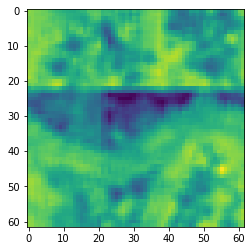

[[0.81996396 0.84562501 0.82916901 ... 0.5333196  0.55246052 0.62376875]
 [0.81417155 0.82175196 0.82062842 ... 0.45582047 0.52557443 0.60447668]
 [0.73032237 0.75023062 0.79764076 ... 0.49611655 0.52276619 0.58040614]
 ...
 [0.87468076 0.86072097 0.84460103 ... 0.6878926  0.67284062 0.71414685]
 [0.83135329 0.85362121 0.84265631 ... 0.62972819 0.62424934 0.68798228]
 [0.8240968  0.85509796 0.83942359 ... 0.64518977 0.58807222 0.64958074]]


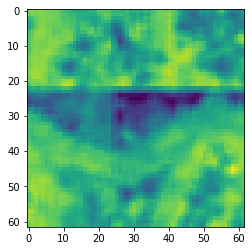

[[0.62376875 0.70371234 0.8032116  ... 0.66040717 0.58018326 0.50423976]
 [0.60447668 0.69322472 0.77165396 ... 0.60713772 0.5079505  0.43232543]
 [0.58040614 0.65156338 0.68537015 ... 0.56931944 0.53155401 0.50311349]
 ...
 [0.71414685 0.78288456 0.83250633 ... 0.8252519  0.81825507 0.75900961]
 [0.68798228 0.74220597 0.80681499 ... 0.84153545 0.77293075 0.69410444]
 [0.64958074 0.70084251 0.7970278  ... 0.86460063 0.76909148 0.69843177]]


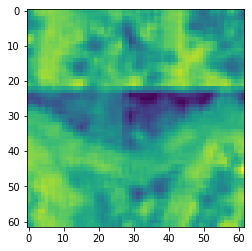

[[0.50423976 0.5333196  0.55246052 ... 0.6143263  0.70883566 0.7564109 ]
 [0.43232543 0.45582047 0.52557443 ... 0.57412294 0.65953013 0.67327303]
 [0.50311349 0.49611655 0.52276619 ... 0.56608009 0.59042627 0.59273404]
 ...
 [0.75900961 0.6878926  0.67284062 ... 0.76372271 0.74935669 0.78175444]
 [0.69410444 0.62972819 0.62424934 ... 0.84136253 0.83843826 0.82627788]
 [0.69843177 0.64518977 0.58807222 ... 0.8862234  0.87992221 0.85854368]]


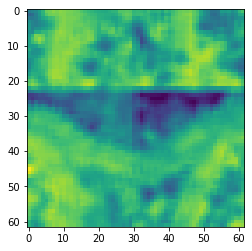

[[0.7564109  0.66040717 0.58018326 ... 0.60715407 0.62925665 0.57384751]
 [0.67327303 0.60713772 0.5079505  ... 0.53856857 0.57820503 0.54046617]
 [0.59273404 0.56931944 0.53155401 ... 0.50901808 0.54560921 0.51436671]
 ...
 [0.78175444 0.8252519  0.81825507 ... 0.62585574 0.6716739  0.71257937]
 [0.82627788 0.84153545 0.77293075 ... 0.59144888 0.70223985 0.76445417]
 [0.85854368 0.86460063 0.76909148 ... 0.6239746  0.77231925 0.85744176]]


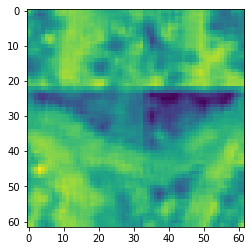

[[0.57384751 0.6143263  0.70883566 ... 0.47680439 0.49368566 0.618513  ]
 [0.54046617 0.57412294 0.65953013 ... 0.45043545 0.48380028 0.56381114]
 [0.51436671 0.56608009 0.59042627 ... 0.47976153 0.47339102 0.5089059 ]
 ...
 [0.71257937 0.76372271 0.74935669 ... 0.6604921  0.66551182 0.63641189]
 [0.76445417 0.84136253 0.83843826 ... 0.62089214 0.6249169  0.59282361]
 [0.85744176 0.8862234  0.87992221 ... 0.66016945 0.63394729 0.55937583]]


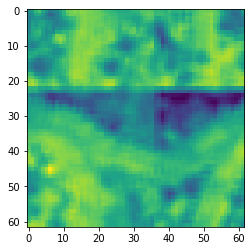

[[0.618513   0.60715407 0.62925665 ... 0.57736581 0.54071856 0.47933579]
 [0.56381114 0.53856857 0.57820503 ... 0.585739   0.53786319 0.46580741]
 [0.5089059  0.50901808 0.54560921 ... 0.55304961 0.5247524  0.48987301]
 ...
 [0.63641189 0.62585574 0.6716739  ... 0.71435401 0.60790436 0.63056799]
 [0.59282361 0.59144888 0.70223985 ... 0.66009135 0.56194967 0.6385704 ]
 [0.55937583 0.6239746  0.77231925 ... 0.62875049 0.61908852 0.70159186]]


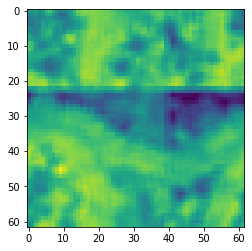

[[0.47933579 0.47680439 0.49368566 ... 0.78572504 0.74504245 0.65890827]
 [0.46580741 0.45043545 0.48380028 ... 0.79097558 0.75639191 0.66021841]
 [0.48987301 0.47976153 0.47339102 ... 0.78110761 0.73431595 0.61153363]
 ...
 [0.63056799 0.6604921  0.66551182 ... 0.81620442 0.84026718 0.75842862]
 [0.6385704  0.62089214 0.6249169  ... 0.83290456 0.81599852 0.71464932]
 [0.70159186 0.66016945 0.63394729 ... 0.83451343 0.78089455 0.71143459]]


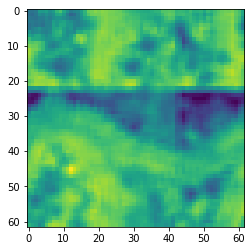

[[0.65890827 0.57736581 0.54071856 ... 0.81368271 0.81048107 0.82702091]
 [0.66021841 0.585739   0.53786319 ... 0.82501744 0.83659847 0.8518644 ]
 [0.61153363 0.55304961 0.5247524  ... 0.81487961 0.81588629 0.84069107]
 ...
 [0.75842862 0.71435401 0.60790436 ... 0.76061658 0.76295059 0.78917507]
 [0.71464932 0.66009135 0.56194967 ... 0.73478923 0.74533034 0.79978781]
 [0.71143459 0.62875049 0.61908852 ... 0.74200322 0.75963052 0.80004025]]


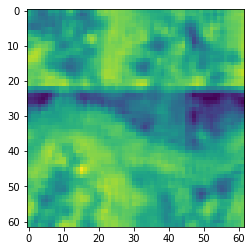

[[0.82702091 0.78572504 0.74504245 ... 0.73447831 0.76861925 0.79940988]
 [0.8518644  0.79097558 0.75639191 ... 0.74316857 0.77848055 0.80655413]
 [0.84069107 0.78110761 0.73431595 ... 0.77148198 0.78815035 0.81354665]
 ...
 [0.78917507 0.81620442 0.84026718 ... 0.70476073 0.77216011 0.75380714]
 [0.79978781 0.83290456 0.81599852 ... 0.68073084 0.73953247 0.7231248 ]
 [0.80004025 0.83451343 0.78089455 ... 0.70689084 0.72676427 0.72059803]]


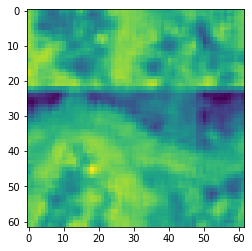

[[0.79940988 0.81368271 0.81048107 ... 0.65883843 0.72464636 0.69645728]
 [0.80655413 0.82501744 0.83659847 ... 0.60975436 0.6759813  0.66205942]
 [0.81354665 0.81487961 0.81588629 ... 0.65640959 0.73527961 0.70634156]
 ...
 [0.75380714 0.76061658 0.76295059 ... 0.62460997 0.59178074 0.65019276]
 [0.7231248  0.73478923 0.74533034 ... 0.55029775 0.5449791  0.59108741]
 [0.72059803 0.74200322 0.75963052 ... 0.61649449 0.6576431  0.652863  ]]


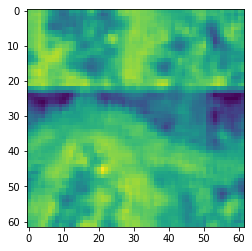

[[0.69645728 0.73447831 0.76861925 ... 0.68745561 0.6896065  0.7037562 ]
 [0.66205942 0.74316857 0.77848055 ... 0.65868128 0.63739379 0.67639178]
 [0.70634156 0.77148198 0.78815035 ... 0.68294252 0.65765283 0.6916776 ]
 ...
 [0.65019276 0.70476073 0.77216011 ... 0.70022203 0.72182365 0.67109264]
 [0.59108741 0.68073084 0.73953247 ... 0.64200686 0.68890212 0.62120454]
 [0.652863   0.70689084 0.72676427 ... 0.6337558  0.65683486 0.61780147]]


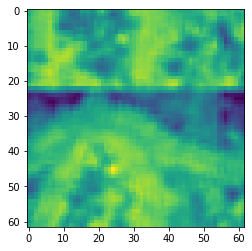

[[0.7037562  0.65883843 0.72464636 ... 0.71437068 0.69813446 0.73445942]
 [0.67639178 0.60975436 0.6759813  ... 0.73357608 0.71099617 0.71434207]
 [0.6916776  0.65640959 0.73527961 ... 0.67959394 0.69543787 0.71872668]
 ...
 [0.67109264 0.62460997 0.59178074 ... 0.64716347 0.63447926 0.66173582]
 [0.62120454 0.55029775 0.5449791  ... 0.72650309 0.68547429 0.63967621]
 [0.61780147 0.61649449 0.6576431  ... 0.76384961 0.69796674 0.65241076]]


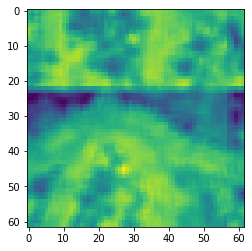

[[0.73445942 0.68745561 0.6896065  ... 0.76937453 0.70981715 0.71881256]
 [0.71434207 0.65868128 0.63739379 ... 0.78296776 0.71805212 0.72519195]
 [0.71872668 0.68294252 0.65765283 ... 0.75662227 0.66538176 0.6431009 ]
 ...
 [0.66173582 0.70022203 0.72182365 ... 0.59440486 0.65654754 0.64028476]
 [0.63967621 0.64200686 0.68890212 ... 0.55844526 0.67388621 0.69565861]
 [0.65241076 0.6337558  0.65683486 ... 0.57265497 0.72281934 0.76185309]]


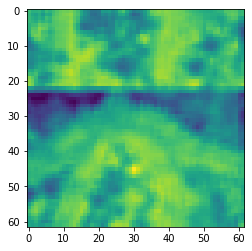

[[0.71881256 0.71437068 0.69813446 ... 0.76538232 0.77030479 0.78034364]
 [0.72519195 0.73357608 0.71099617 ... 0.73425589 0.77635327 0.79693329]
 [0.6431009  0.67959394 0.69543787 ... 0.68738919 0.73853731 0.77024452]
 ...
 [0.64028476 0.64716347 0.63447926 ... 0.60946048 0.64039626 0.64738121]
 [0.69565861 0.72650309 0.68547429 ... 0.60641851 0.60428909 0.62397991]
 [0.76185309 0.76384961 0.69796674 ... 0.60893923 0.58063629 0.60987522]]


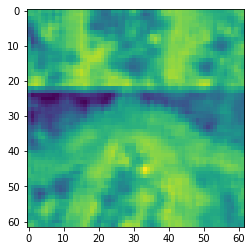

[[0.78034364 0.76937453 0.70981715 ... 0.68397282 0.70484188 0.70630969]
 [0.79693329 0.78296776 0.71805212 ... 0.68194647 0.6748617  0.68831976]
 [0.77024452 0.75662227 0.66538176 ... 0.67132205 0.64157308 0.64282336]
 ...
 [0.64738121 0.59440486 0.65654754 ... 0.59524745 0.54142762 0.57367354]
 [0.62397991 0.55844526 0.67388621 ... 0.61688215 0.56576417 0.57822723]
 [0.60987522 0.57265497 0.72281934 ... 0.64689846 0.59179295 0.6090978 ]]


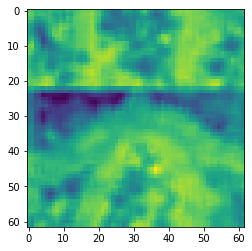

[[0.70630969 0.76538232 0.77030479 ... 0.67673579 0.67105983 0.66785472]
 [0.68831976 0.73425589 0.77635327 ... 0.6897861  0.6888449  0.67945568]
 [0.64282336 0.68738919 0.73853731 ... 0.69781528 0.68740097 0.67308265]
 ...
 [0.57367354 0.60946048 0.64039626 ... 0.67824604 0.67743559 0.63975547]
 [0.57822723 0.60641851 0.60428909 ... 0.67727203 0.69282139 0.65354807]
 [0.6090978  0.60893923 0.58063629 ... 0.68573094 0.67611378 0.66741483]]


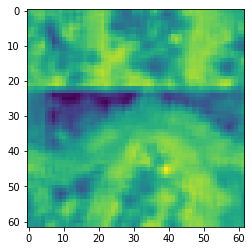

[[0.66785472 0.68397282 0.70484188 ... 0.71932034 0.70631295 0.68557784]
 [0.67945568 0.68194647 0.6748617  ... 0.7411437  0.72327679 0.71576071]
 [0.67308265 0.67132205 0.64157308 ... 0.75637582 0.73930043 0.72920541]
 ...
 [0.63975547 0.59524745 0.54142762 ... 0.654938   0.65666756 0.67061352]
 [0.65354807 0.61688215 0.56576417 ... 0.64641161 0.64222701 0.65949857]
 [0.66741483 0.64689846 0.59179295 ... 0.66140443 0.6496378  0.65554102]]


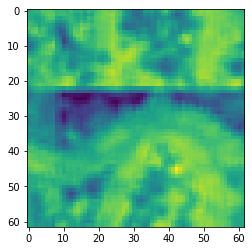

[[0.68557784 0.67673579 0.67105983 ... 0.79844917 0.7657754  0.73993017]
 [0.71576071 0.6897861  0.6888449  ... 0.81064868 0.78824807 0.76609196]
 [0.72920541 0.69781528 0.68740097 ... 0.81099543 0.77949417 0.75471557]
 ...
 [0.67061352 0.67824604 0.67743559 ... 0.76902832 0.72750593 0.67810163]
 [0.65949857 0.67727203 0.69282139 ... 0.78218034 0.75747033 0.69160534]
 [0.65554102 0.68573094 0.67611378 ... 0.77928895 0.75742757 0.69127311]]


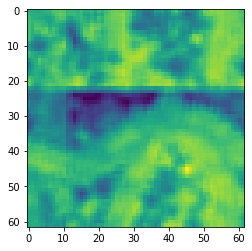

[[0.73993017 0.71932034 0.70631295 ... 0.82657639 0.82356493 0.81099906]
 [0.76609196 0.7411437  0.72327679 ... 0.81934063 0.8182335  0.80562971]
 [0.75471557 0.75637582 0.73930043 ... 0.82469115 0.8272976  0.82189364]
 ...
 [0.67810163 0.654938   0.65666756 ... 0.78930886 0.79781427 0.78402014]
 [0.69160534 0.64641161 0.64222701 ... 0.8131744  0.80955786 0.79582437]
 [0.69127311 0.66140443 0.6496378  ... 0.8238736  0.81009646 0.80870617]]


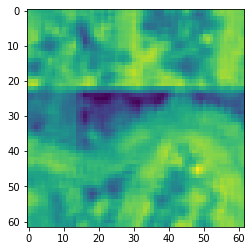

[[0.80870617 0.77928895 0.75742757 ... 0.83942359 0.8572732  0.85425648]
 [0.81556973 0.78538886 0.77879673 ... 0.84525071 0.85731101 0.85929891]
 [0.80883224 0.79472786 0.7870042  ... 0.83217642 0.84509377 0.84598911]
 ...
 [0.81462333 0.78981686 0.79055994 ... 0.82629481 0.77788209 0.77833849]
 [0.78770179 0.77940954 0.78019617 ... 0.83350391 0.79120757 0.78586541]
 [0.7856431  0.78339386 0.76074885 ... 0.82860679 0.8076388  0.80432898]]


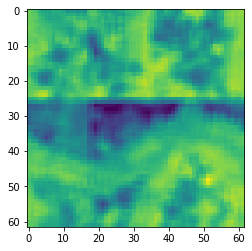

[[0.85425648 0.8238736  0.81009646 ... 0.7970278  0.8240968  0.85509796]
 [0.85929891 0.83854066 0.82183958 ... 0.81542847 0.84612206 0.86813007]
 [0.84598911 0.8283504  0.82145439 ... 0.80121749 0.82541767 0.85256178]
 ...
 [0.77833849 0.77326803 0.798109   ... 0.76606261 0.81749899 0.84363664]
 [0.78586541 0.77425193 0.79077368 ... 0.81959134 0.87771305 0.8886942 ]
 [0.80432898 0.77159942 0.79762215 ... 0.82917027 0.86498766 0.85230082]]


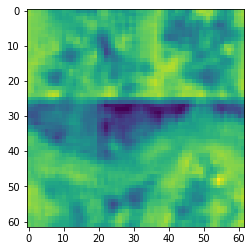

[[0.85509796 0.83942359 0.8572732  ... 0.58807222 0.64958074 0.70084251]
 [0.86813007 0.84525071 0.85731101 ... 0.59522504 0.66976084 0.68620007]
 [0.85256178 0.83217642 0.84509377 ... 0.58759673 0.64343964 0.67027577]
 ...
 [0.84363664 0.82629481 0.77788209 ... 0.72290669 0.70252822 0.71194894]
 [0.8886942  0.83350391 0.79120757 ... 0.69711932 0.71343711 0.76440541]
 [0.85230082 0.82860679 0.8076388  ... 0.70296079 0.74114202 0.80348045]]


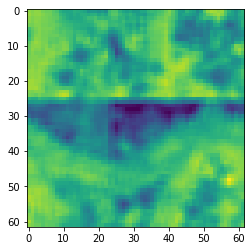

[[0.70084251 0.7970278  0.8240968  ... 0.76909148 0.69843177 0.64518977]
 [0.68620007 0.81542847 0.84612206 ... 0.76099719 0.66283553 0.64316558]
 [0.67027577 0.80121749 0.82541767 ... 0.691776   0.60346958 0.61517257]
 ...
 [0.71194894 0.76606261 0.81749899 ... 0.81216651 0.8044246  0.75849846]
 [0.76440541 0.81959134 0.87771305 ... 0.8274387  0.78504969 0.71505928]
 [0.80348045 0.82917027 0.86498766 ... 0.83098056 0.78289376 0.72535678]]


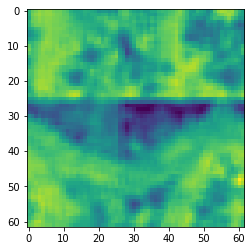

[[0.68859857 0.62763811 0.69328497 ... 0.93912396 0.91630707 0.92277153]
 [0.68643819 0.63527218 0.71482279 ... 0.91263413 0.93427602 0.89798438]
 [0.65656179 0.62713063 0.68673069 ... 0.82997412 0.88895697 0.80562193]
 ...
 [0.80953074 0.77154434 0.74979478 ... 0.70244407 0.75460287 0.83409444]
 [0.76316894 0.74402197 0.76143763 ... 0.65570888 0.7295345  0.83269357]
 [0.77415927 0.75025646 0.79100654 ... 0.69685834 0.78191261 0.85955628]]


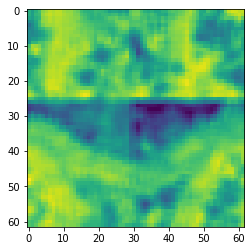

[[0.86460063 0.76909148 0.69843177 ... 0.77231925 0.85744176 0.8862234 ]
 [0.84137604 0.76099719 0.66283553 ... 0.73106898 0.79810663 0.82791746]
 [0.75483606 0.691776   0.60346958 ... 0.73663345 0.73097105 0.73298209]
 ...
 [0.78151367 0.81216651 0.8044246  ... 0.63444786 0.65843809 0.6450006 ]
 [0.78020112 0.8274387  0.78504969 ... 0.63122304 0.65562843 0.62357032]
 [0.80537042 0.83098056 0.78289376 ... 0.64700464 0.67650217 0.66300251]]


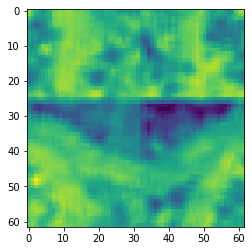

[[0.8862234  0.87992221 0.85854368 ... 0.63394729 0.55937583 0.6239746 ]
 [0.82791746 0.85510227 0.87537988 ... 0.60374607 0.5811912  0.66902401]
 [0.73298209 0.7776531  0.83291771 ... 0.5446029  0.61134093 0.68180494]
 ...
 [0.6450006  0.65816246 0.70703321 ... 0.59992731 0.63073077 0.65056943]
 [0.62357032 0.61437343 0.68354513 ... 0.71042323 0.69968484 0.6837534 ]
 [0.66300251 0.65292885 0.73262136 ... 0.7028798  0.67658206 0.66435357]]


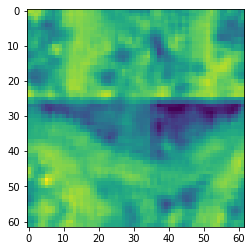

[[0.6239746  0.77231925 0.85744176 ... 0.61908852 0.70159186 0.66016945]
 [0.66902401 0.73106898 0.79810663 ... 0.64954629 0.65482418 0.63415035]
 [0.68180494 0.73663345 0.73097105 ... 0.62230331 0.57880569 0.5783819 ]
 ...
 [0.65056943 0.63444786 0.65843809 ... 0.76632552 0.65759719 0.60828382]
 [0.6837534  0.63122304 0.65562843 ... 0.77079007 0.67292319 0.67832083]
 [0.66435357 0.64700464 0.67650217 ... 0.70111537 0.63601187 0.6694395 ]]


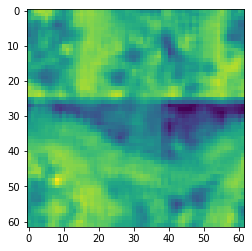

[[0.66016945 0.63394729 0.55937583 ... 0.78089455 0.71143459 0.62875049]
 [0.63415035 0.60374607 0.5811912  ... 0.7683424  0.71378243 0.61589488]
 [0.5783819  0.5446029  0.61134093 ... 0.76209507 0.70559926 0.62529615]
 ...
 [0.60828382 0.59992731 0.63073077 ... 0.8261141  0.87339008 0.85266623]
 [0.67832083 0.71042323 0.69968484 ... 0.83574567 0.87891085 0.82280271]
 [0.6694395  0.7028798  0.67658206 ... 0.84703213 0.84325292 0.77605833]]


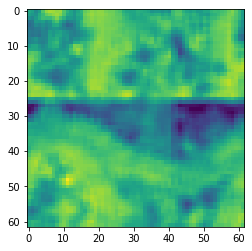

[[0.62875049 0.61908852 0.70159186 ... 0.75963052 0.80004025 0.83451343]
 [0.61589488 0.64954629 0.65482418 ... 0.7769481  0.81550673 0.82481727]
 [0.62529615 0.62230331 0.57880569 ... 0.80074926 0.82567637 0.79702979]
 ...
 [0.85266623 0.76632552 0.65759719 ... 0.8230409  0.80780573 0.8176553 ]
 [0.82280271 0.77079007 0.67292319 ... 0.82216534 0.7984824  0.82796332]
 [0.77605833 0.70111537 0.63601187 ... 0.79319131 0.78536583 0.82287045]]


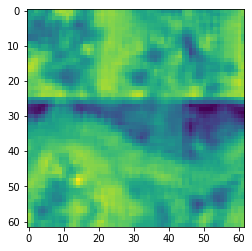

[[0.83451343 0.78089455 0.71143459 ... 0.72676427 0.72059803 0.74200322]
 [0.82481727 0.7683424  0.71378243 ... 0.70054274 0.72668296 0.75853617]
 [0.79702979 0.76209507 0.70559926 ... 0.7222994  0.75546049 0.79301281]
 ...
 [0.8176553  0.8261141  0.87339008 ... 0.71379642 0.78427879 0.80540524]
 [0.82796332 0.83574567 0.87891085 ... 0.74237379 0.79249293 0.80178065]
 [0.82287045 0.84703213 0.84325292 ... 0.76857675 0.76724863 0.77168362]]


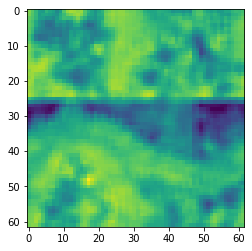

[[0.74200322 0.75963052 0.80004025 ... 0.6576431  0.652863   0.70689084]
 [0.75853617 0.7769481  0.81550673 ... 0.63464104 0.61816142 0.68632892]
 [0.79301281 0.80074926 0.82567637 ... 0.70607339 0.67151991 0.71582513]
 ...
 [0.80540524 0.8230409  0.80780573 ... 0.68773509 0.67920886 0.68472263]
 [0.80178065 0.82216534 0.7984824  ... 0.63868058 0.64808495 0.65797686]
 [0.77168362 0.79319131 0.78536583 ... 0.58157339 0.63019811 0.66339743]]


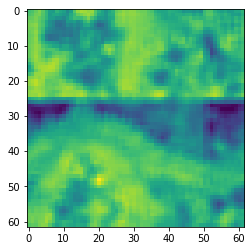

[[0.70689084 0.72676427 0.72059803 ... 0.65683486 0.61780147 0.61649449]
 [0.68632892 0.70054274 0.72668296 ... 0.70540325 0.67049182 0.62800215]
 [0.71582513 0.7222994  0.75546049 ... 0.68850857 0.68382535 0.65497281]
 ...
 [0.68472263 0.71379642 0.78427879 ... 0.82500966 0.78916308 0.75828599]
 [0.65797686 0.74237379 0.79249293 ... 0.83574383 0.78109446 0.72926126]
 [0.66339743 0.76857675 0.76724863 ... 0.78723403 0.71564469 0.65387473]]


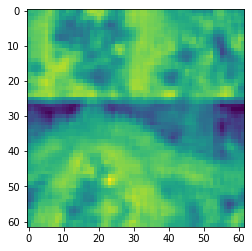

[[0.61649449 0.6576431  0.652863   ... 0.69796674 0.65241076 0.6337558 ]
 [0.62800215 0.63464104 0.61816142 ... 0.72214678 0.69615061 0.67559679]
 [0.65497281 0.70607339 0.67151991 ... 0.70145033 0.70623006 0.66161464]
 ...
 [0.75828599 0.68773509 0.67920886 ... 0.67021466 0.69248016 0.78564546]
 [0.72926126 0.63868058 0.64808495 ... 0.70905508 0.74203809 0.80532556]
 [0.65387473 0.58157339 0.63019811 ... 0.65541801 0.70374521 0.76999655]]


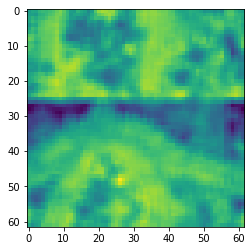

[[0.6337558  0.65683486 0.61780147 ... 0.72281934 0.76185309 0.76384961]
 [0.67559679 0.70540325 0.67049182 ... 0.73034446 0.77643611 0.77983917]
 [0.66161464 0.68850857 0.68382535 ... 0.71038978 0.74430163 0.74560367]
 ...
 [0.78564546 0.82500966 0.78916308 ... 0.71964705 0.71696229 0.64321797]
 [0.80532556 0.83574383 0.78109446 ... 0.71759877 0.68171364 0.64849112]
 [0.76999655 0.78723403 0.71564469 ... 0.65509004 0.6231713  0.62393373]]


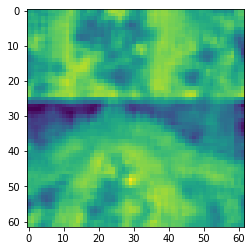

[[0.76384961 0.69796674 0.65241076 ... 0.58063629 0.60987522 0.57265497]
 [0.77983917 0.72214678 0.69615061 ... 0.65199985 0.68195772 0.65156906]
 [0.74560367 0.70145033 0.70623006 ... 0.71101311 0.71747092 0.70132879]
 ...
 [0.64321797 0.67021466 0.69248016 ... 0.66845775 0.71453156 0.74113171]
 [0.64849112 0.70905508 0.74203809 ... 0.68434191 0.73621828 0.74366715]
 [0.62393373 0.65541801 0.70374521 ... 0.69862173 0.70634335 0.66519794]]


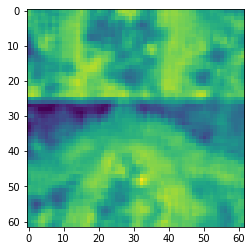

[[0.57265497 0.72281934 0.76185309 ... 0.59179295 0.6090978  0.60893923]
 [0.65156906 0.73034446 0.77643611 ... 0.66891278 0.68720543 0.69420705]
 [0.70132879 0.71038978 0.74430163 ... 0.72860727 0.72897369 0.75208278]
 ...
 [0.74113171 0.71964705 0.71696229 ... 0.55156518 0.52981793 0.61707338]
 [0.74366715 0.71759877 0.68171364 ... 0.5535656  0.55807264 0.60286824]
 [0.66519794 0.65509004 0.6231713  ... 0.54694423 0.59593241 0.62673172]]


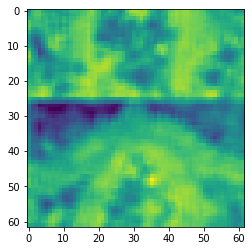

[[0.60893923 0.58063629 0.60987522 ... 0.67611378 0.66741483 0.64689846]
 [0.69420705 0.65199985 0.68195772 ... 0.65936709 0.68291849 0.68231215]
 [0.75208278 0.71101311 0.71747092 ... 0.65608557 0.66693813 0.69700214]
 ...
 [0.61707338 0.66845775 0.71453156 ... 0.68197324 0.62894556 0.58527613]
 [0.60286824 0.68434191 0.73621828 ... 0.66489333 0.63239606 0.59887798]
 [0.62673172 0.69862173 0.70634335 ... 0.65240281 0.63158182 0.58868272]]


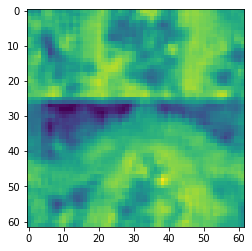

[[0.64689846 0.59179295 0.6090978  ... 0.6496378  0.65554102 0.68573094]
 [0.68231215 0.66891278 0.68720543 ... 0.66429966 0.65000674 0.68032703]
 [0.69700214 0.72860727 0.72897369 ... 0.67199282 0.64662818 0.66464115]
 ...
 [0.58527613 0.55156518 0.52981793 ... 0.71350243 0.68573083 0.67748808]
 [0.59887798 0.5535656  0.55807264 ... 0.69214289 0.66690295 0.66288265]
 [0.58868272 0.54694423 0.59593241 ... 0.66426532 0.65968344 0.66312411]]


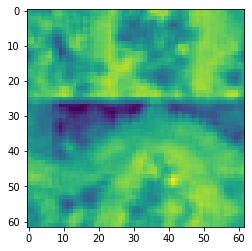

[[0.68573094 0.67611378 0.66741483 ... 0.75742757 0.69127311 0.66140443]
 [0.68032703 0.65936709 0.68291849 ... 0.77879673 0.71534323 0.68893789]
 [0.66464115 0.65608557 0.66693813 ... 0.7870042  0.73970245 0.70756897]
 ...
 [0.67748808 0.68197324 0.62894556 ... 0.79055994 0.75722035 0.73595932]
 [0.66288265 0.66489333 0.63239606 ... 0.78019617 0.75064337 0.72140854]
 [0.66312411 0.65240281 0.63158182 ... 0.76074885 0.7150658  0.67426467]]


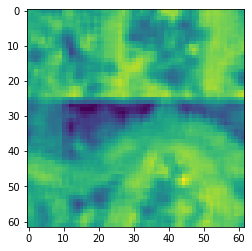

[[0.66140443 0.6496378  0.65554102 ... 0.81009646 0.80870617 0.77928895]
 [0.68893789 0.66429966 0.65000674 ... 0.82183958 0.81556973 0.78538886]
 [0.70756897 0.67199282 0.64662818 ... 0.82145439 0.80883224 0.79472786]
 ...
 [0.73595932 0.71350243 0.68573083 ... 0.798109   0.81462333 0.78981686]
 [0.72140854 0.69214289 0.66690295 ... 0.79077368 0.78770179 0.77940954]
 [0.67426467 0.66426532 0.65968344 ... 0.79762215 0.7856431  0.78339386]]


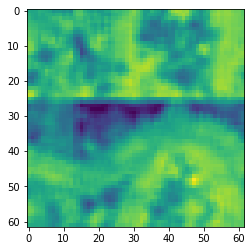

[[0.77928895 0.75742757 0.69127311 ... 0.8572732  0.85425648 0.8238736 ]
 [0.78538886 0.77879673 0.71534323 ... 0.85731101 0.85929891 0.83854066]
 [0.79472786 0.7870042  0.73970245 ... 0.84509377 0.84598911 0.8283504 ]
 ...
 [0.78981686 0.79055994 0.75722035 ... 0.77788209 0.77833849 0.77326803]
 [0.77940954 0.78019617 0.75064337 ... 0.79120757 0.78586541 0.77425193]
 [0.78339386 0.76074885 0.7150658  ... 0.8076388  0.80432898 0.77159942]]


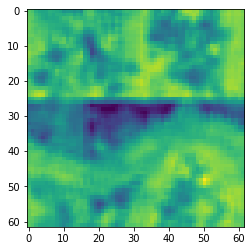

[[0.77159942 0.79762215 0.7856431  ... 0.86498766 0.85230082 0.82860679]
 [0.78930886 0.79781427 0.78402014 ... 0.87468076 0.86072097 0.84460103]
 [0.8131744  0.80955786 0.79582437 ... 0.83135329 0.85362121 0.84265631]
 ...
 [0.84410597 0.855325   0.83657869 ... 0.77891833 0.82617632 0.86591666]
 [0.82494065 0.84613974 0.83268499 ... 0.76538906 0.7991354  0.85723833]
 [0.7997157  0.8219161  0.82184536 ... 0.8174972  0.83131069 0.83878638]]


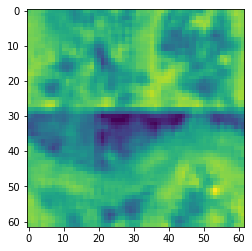

[[0.82860679 0.8076388  0.80432898 ... 0.74114202 0.80348045 0.82917027]
 [0.84460103 0.83490682 0.83828417 ... 0.71414685 0.78288456 0.83250633]
 [0.84265631 0.85360328 0.84666088 ... 0.68798228 0.74220597 0.80681499]
 ...
 [0.86591666 0.82900076 0.85430434 ... 0.76933845 0.70398362 0.72236315]
 [0.85723833 0.80805402 0.83777018 ... 0.76897399 0.70972369 0.68458079]
 [0.83878638 0.78034901 0.79650876 ... 0.72626137 0.6934251  0.72894671]]


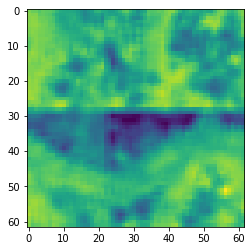

[[0.82917027 0.86498766 0.85230082 ... 0.78289376 0.72535678 0.70296079]
 [0.83250633 0.87468076 0.86072097 ... 0.75900961 0.6878926  0.67284062]
 [0.80681499 0.83135329 0.85362121 ... 0.69410444 0.62972819 0.62424934]
 ...
 [0.72236315 0.77891833 0.82617632 ... 0.87908283 0.86080953 0.8406337 ]
 [0.68458079 0.76538906 0.7991354  ... 0.87731061 0.86920239 0.83679101]
 [0.72894671 0.8174972  0.83131069 ... 0.83265317 0.80636374 0.77321643]]


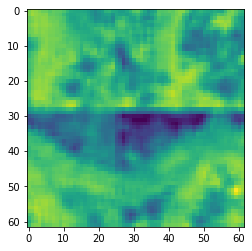

[[0.76668005 0.80832217 0.87631122 ... 0.79902917 0.87837251 0.90630405]
 [0.73382965 0.77888005 0.85384843 ... 0.85261588 0.90005612 0.89242507]
 [0.68083387 0.75034382 0.80948256 ... 0.9011751  0.91781568 0.84299237]
 ...
 [0.91683219 0.83907445 0.76779558 ... 0.84079158 0.89648391 0.93287961]
 [0.91264118 0.83867695 0.77405596 ... 0.86490571 0.90025745 0.92678884]
 [0.84330395 0.79209269 0.75628    ... 0.81835099 0.87901523 0.9127434 ]]


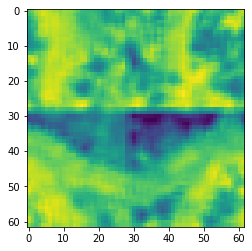

[[0.83098056 0.78289376 0.72535678 ... 0.67650217 0.66300251 0.65292885]
 [0.81825507 0.75900961 0.6878926  ... 0.71257937 0.76372271 0.74935669]
 [0.77293075 0.69410444 0.62972819 ... 0.76445417 0.84136253 0.83843826]
 ...
 [0.85534741 0.87908283 0.86080953 ... 0.66785535 0.69951649 0.7250185 ]
 [0.84976285 0.87731061 0.86920239 ... 0.70374837 0.73491998 0.77541439]
 [0.83688473 0.83265317 0.80636374 ... 0.68156612 0.69155905 0.72482554]]


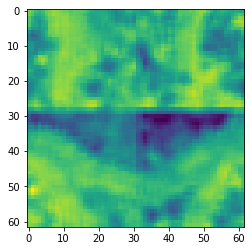

[[0.65292885 0.73262136 0.80537042 ... 0.67658206 0.66435357 0.64700464]
 [0.74935669 0.78175444 0.8252519  ... 0.63641189 0.62585574 0.6716739 ]
 [0.83843826 0.82627788 0.84153545 ... 0.59282361 0.59144888 0.70223985]
 ...
 [0.7250185  0.77091287 0.82197658 ... 0.56230809 0.57432053 0.64789241]
 [0.77541439 0.79302286 0.8254365  ... 0.52555734 0.58951195 0.66275638]
 [0.72482554 0.75033733 0.80595972 ... 0.59975386 0.634049   0.6528417 ]]


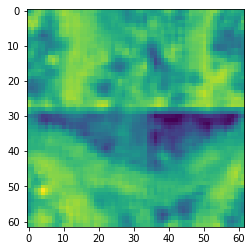

[[0.64700464 0.67650217 0.66300251 ... 0.63601187 0.6694395  0.7028798 ]
 [0.6716739  0.71257937 0.76372271 ... 0.63056799 0.6604921  0.66551182]
 [0.70223985 0.76445417 0.84136253 ... 0.6385704  0.62089214 0.6249169 ]
 ...
 [0.64789241 0.66785535 0.69951649 ... 0.59959361 0.55686374 0.51546174]
 [0.66275638 0.70374837 0.73491998 ... 0.6070066  0.51100156 0.47990652]
 [0.6528417  0.68156612 0.69155905 ... 0.64090184 0.55550627 0.54473212]]


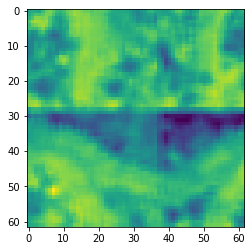

[[0.7028798  0.67658206 0.66435357 ... 0.84325292 0.77605833 0.70111537]
 [0.66551182 0.63641189 0.62585574 ... 0.75842862 0.71435401 0.60790436]
 [0.6249169  0.59282361 0.59144888 ... 0.71464932 0.66009135 0.56194967]
 ...
 [0.51546174 0.56230809 0.57432053 ... 0.8075729  0.74800542 0.70785087]
 [0.47990652 0.52555734 0.58951195 ... 0.8152019  0.79189985 0.72688313]
 [0.54473212 0.59975386 0.634049   ... 0.85269116 0.86107055 0.76388291]]


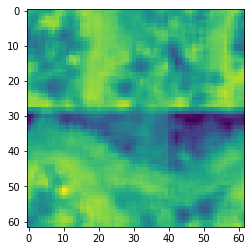

[[0.70111537 0.63601187 0.6694395  ... 0.78536583 0.82287045 0.84703213]
 [0.60790436 0.63056799 0.6604921  ... 0.78917507 0.81620442 0.84026718]
 [0.56194967 0.6385704  0.62089214 ... 0.79978781 0.83290456 0.81599852]
 ...
 [0.70785087 0.59959361 0.55686374 ... 0.78666587 0.78413926 0.80040499]
 [0.72688313 0.6070066  0.51100156 ... 0.80093086 0.79412699 0.8014438 ]
 [0.76388291 0.64090184 0.55550627 ... 0.81158404 0.81165699 0.82373518]]


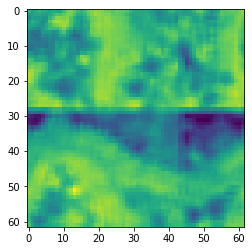

[[0.84703213 0.84325292 0.77605833 ... 0.76724863 0.77168362 0.79319131]
 [0.84026718 0.75842862 0.71435401 ... 0.75380714 0.76061658 0.76295059]
 [0.81599852 0.71464932 0.66009135 ... 0.7231248  0.73478923 0.74533034]
 ...
 [0.80040499 0.8075729  0.74800542 ... 0.68265342 0.76689352 0.76087197]
 [0.8014438  0.8152019  0.79189985 ... 0.72935746 0.78513579 0.770522  ]
 [0.82373518 0.85269116 0.86107055 ... 0.76668299 0.81082802 0.80720812]]


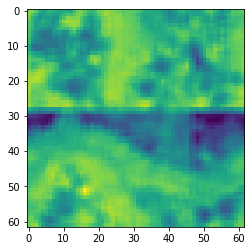

[[0.79319131 0.78536583 0.82287045 ... 0.63019811 0.66339743 0.76857675]
 [0.76295059 0.78917507 0.81620442 ... 0.65019276 0.70476073 0.77216011]
 [0.74533034 0.79978781 0.83290456 ... 0.59108741 0.68073084 0.73953247]
 ...
 [0.76087197 0.78666587 0.78413926 ... 0.54306998 0.53332628 0.59474629]
 [0.770522   0.80093086 0.79412699 ... 0.66737255 0.68216036 0.69109466]
 [0.80720812 0.81158404 0.81165699 ... 0.66543556 0.66626595 0.68181362]]


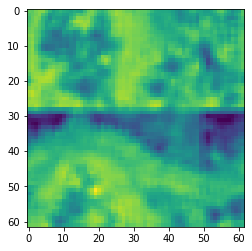

[[0.76857675 0.76724863 0.77168362 ... 0.71564469 0.65387473 0.58157339]
 [0.77216011 0.75380714 0.76061658 ... 0.67109264 0.62460997 0.59178074]
 [0.73953247 0.7231248  0.73478923 ... 0.62120454 0.55029775 0.5449791 ]
 ...
 [0.59474629 0.68265342 0.76689352 ... 0.66051451 0.66662815 0.59644451]
 [0.69109466 0.72935746 0.78513579 ... 0.74032651 0.75949904 0.69373182]
 [0.68181362 0.76668299 0.81082802 ... 0.78481176 0.7795354  0.70876987]]


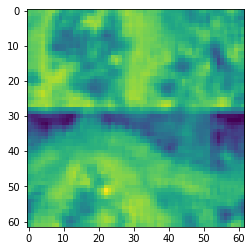

[[0.58157339 0.63019811 0.66339743 ... 0.70374521 0.76999655 0.78723403]
 [0.59178074 0.65019276 0.70476073 ... 0.66173582 0.70022203 0.72182365]
 [0.5449791  0.59108741 0.68073084 ... 0.63967621 0.64200686 0.68890212]
 ...
 [0.59644451 0.54306998 0.53332628 ... 0.40172929 0.47470184 0.59256864]
 [0.69373182 0.66737255 0.68216036 ... 0.49880578 0.58788672 0.70272144]
 [0.70876987 0.66543556 0.66626595 ... 0.63005963 0.72333937 0.80407659]]


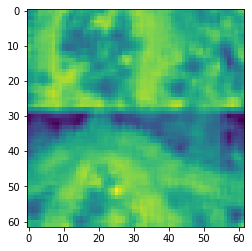

[[0.78723403 0.71564469 0.65387473 ... 0.6231713  0.62393373 0.65541801]
 [0.72182365 0.67109264 0.62460997 ... 0.64028476 0.64716347 0.63447926]
 [0.68890212 0.62120454 0.55029775 ... 0.69565861 0.72650309 0.68547429]
 ...
 [0.59256864 0.66051451 0.66662815 ... 0.69348895 0.57770614 0.46802014]
 [0.70272144 0.74032651 0.75949904 ... 0.68091313 0.60240411 0.52909194]
 [0.80407659 0.78481176 0.7795354  ... 0.69693487 0.63994407 0.62114111]]


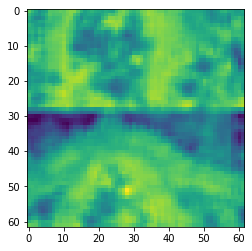

[[0.65541801 0.70374521 0.76999655 ... 0.70634335 0.66519794 0.65509004]
 [0.63447926 0.66173582 0.70022203 ... 0.64738121 0.59440486 0.65654754]
 [0.68547429 0.63967621 0.64200686 ... 0.62397991 0.55844526 0.67388621]
 ...
 [0.46802014 0.40172929 0.47470184 ... 0.74899195 0.73642161 0.75426175]
 [0.52909194 0.49880578 0.58788672 ... 0.73063067 0.71400805 0.73035525]
 [0.62114111 0.63005963 0.72333937 ... 0.71408663 0.71986205 0.72319511]]


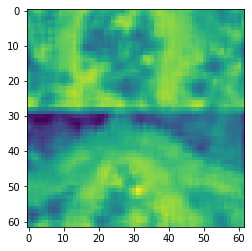

[[0.65509004 0.6231713  0.62393373 ... 0.59593241 0.62673172 0.69862173]
 [0.65654754 0.64028476 0.64716347 ... 0.57367354 0.60946048 0.64039626]
 [0.67388621 0.69565861 0.72650309 ... 0.57822723 0.60641851 0.60428909]
 ...
 [0.75426175 0.69348895 0.57770614 ... 0.60813582 0.66056647 0.74118356]
 [0.73035525 0.68091313 0.60240411 ... 0.58089852 0.64911887 0.73483788]
 [0.72319511 0.69693487 0.63994407 ... 0.5528882  0.64424705 0.69264231]]


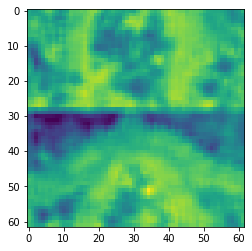

[[0.69862173 0.70634335 0.66519794 ... 0.63158182 0.58868272 0.54694423]
 [0.64039626 0.64738121 0.59440486 ... 0.63975547 0.59524745 0.54142762]
 [0.60428909 0.62397991 0.55844526 ... 0.65354807 0.61688215 0.56576417]
 ...
 [0.74118356 0.74899195 0.73642161 ... 0.61321507 0.56435542 0.54550907]
 [0.73483788 0.73063067 0.71400805 ... 0.62351536 0.55213513 0.52020592]
 [0.69264231 0.71408663 0.71986205 ... 0.63276458 0.57822207 0.55808815]]


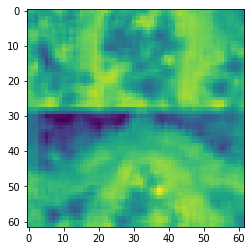

[[0.54694423 0.59593241 0.62673172 ... 0.65968344 0.66312411 0.65240281]
 [0.54142762 0.57367354 0.60946048 ... 0.67061352 0.67824604 0.67743559]
 [0.56576417 0.57822723 0.60641851 ... 0.65949857 0.67727203 0.69282139]
 ...
 [0.54550907 0.60813582 0.66056647 ... 0.74279858 0.71930172 0.69544902]
 [0.52020592 0.58089852 0.64911887 ... 0.74883954 0.73026131 0.71350974]
 [0.55808815 0.5528882  0.64424705 ... 0.72762652 0.71106349 0.70222439]]


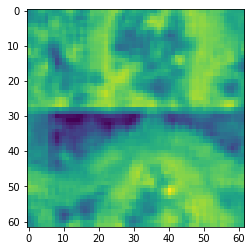

[[0.65240281 0.63158182 0.58868272 ... 0.7150658  0.67426467 0.66426532]
 [0.67743559 0.63975547 0.59524745 ... 0.67810163 0.654938   0.65666756]
 [0.69282139 0.65354807 0.61688215 ... 0.69160534 0.64641161 0.64222701]
 ...
 [0.69544902 0.61321507 0.56435542 ... 0.83341003 0.8100781  0.78754901]
 [0.71350974 0.62351536 0.55213513 ... 0.82144729 0.81337236 0.80372159]
 [0.70222439 0.63276458 0.57822207 ... 0.82294702 0.79072719 0.77068651]]


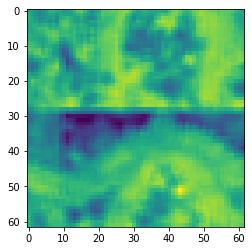

[[0.66426532 0.65968344 0.66312411 ... 0.7856431  0.78339386 0.76074885]
 [0.65666756 0.67061352 0.67824604 ... 0.78402014 0.76902832 0.72750593]
 [0.64222701 0.65949857 0.67727203 ... 0.79582437 0.78218034 0.75747033]
 ...
 [0.78754901 0.74279858 0.71930172 ... 0.83657869 0.81640601 0.84652797]
 [0.80372159 0.74883954 0.73026131 ... 0.83268499 0.79797047 0.82448846]
 [0.77068651 0.72762652 0.71106349 ... 0.82184536 0.7966334  0.84012586]]


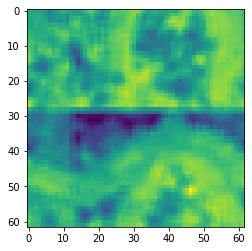

[[0.76074885 0.7150658  0.67426467 ... 0.80432898 0.77159942 0.79762215]
 [0.72750593 0.67810163 0.654938   ... 0.83828417 0.78930886 0.79781427]
 [0.75747033 0.69160534 0.64641161 ... 0.84666088 0.8131744  0.80955786]
 ...
 [0.84652797 0.83341003 0.8100781  ... 0.85430434 0.84410597 0.855325  ]
 [0.82448846 0.82144729 0.81337236 ... 0.83777018 0.82494065 0.84613974]
 [0.84012586 0.82294702 0.79072719 ... 0.79650876 0.7997157  0.8219161 ]]


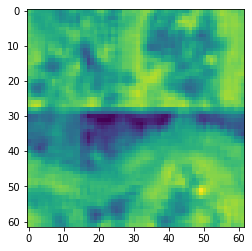

[[0.79762215 0.7856431  0.78339386 ... 0.85230082 0.82860679 0.8076388 ]
 [0.79781427 0.78402014 0.76902832 ... 0.86072097 0.84460103 0.83490682]
 [0.80955786 0.79582437 0.78218034 ... 0.85362121 0.84265631 0.85360328]
 ...
 [0.855325   0.83657869 0.81640601 ... 0.82617632 0.86591666 0.82900076]
 [0.84613974 0.83268499 0.79797047 ... 0.7991354  0.85723833 0.80805402]
 [0.8219161  0.82184536 0.7966334  ... 0.83131069 0.83878638 0.78034901]]


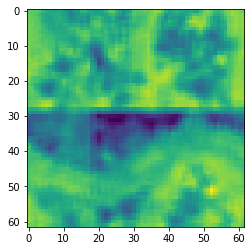

[[0.78034901 0.79650876 0.7997157  ... 0.6934251  0.72894671 0.8174972 ]
 [0.77788209 0.77833849 0.77326803 ... 0.71194894 0.76606261 0.81749899]
 [0.79120757 0.78586541 0.77425193 ... 0.76440541 0.81959134 0.87771305]
 ...
 [0.86444664 0.86653262 0.841363   ... 0.8041296  0.86534145 0.86711693]
 [0.8525175  0.86498177 0.8377939  ... 0.75156863 0.82511879 0.834668  ]
 [0.85573712 0.87179573 0.84661181 ... 0.71021659 0.76222487 0.77474131]]


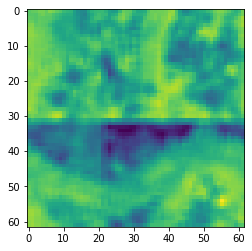

[[0.8174972  0.83131069 0.83878638 ... 0.80636374 0.77321643 0.72626137]
 [0.81749899 0.84363664 0.82629481 ... 0.75849846 0.72290669 0.70252822]
 [0.87771305 0.8886942  0.83350391 ... 0.71505928 0.69711932 0.71343711]
 ...
 [0.86711693 0.89482389 0.87517434 ... 0.7315886  0.73522649 0.77171244]
 [0.834668   0.88426116 0.87641527 ... 0.78197875 0.76751722 0.76279476]
 [0.77474131 0.85297037 0.89296557 ... 0.80077424 0.78436804 0.76218232]]


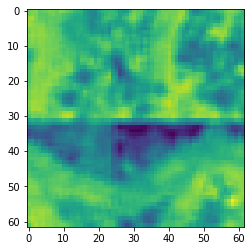

[[0.72626137 0.6934251  0.72894671 ... 0.80595972 0.83688473 0.83265317]
 [0.70252822 0.71194894 0.76606261 ... 0.78151367 0.81216651 0.8044246 ]
 [0.71343711 0.76440541 0.81959134 ... 0.78020112 0.8274387  0.78504969]
 ...
 [0.77171244 0.8041296  0.86534145 ... 0.70711751 0.75084548 0.73413624]
 [0.76279476 0.75156863 0.82511879 ... 0.7477342  0.80944131 0.80466726]
 [0.76218232 0.71021659 0.76222487 ... 0.79508186 0.84437336 0.84318807]]


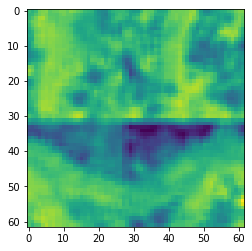

[[0.83265317 0.80636374 0.77321643 ... 0.69155905 0.72482554 0.75033733]
 [0.8044246  0.75849846 0.72290669 ... 0.6450006  0.65816246 0.70703321]
 [0.78504969 0.71505928 0.69711932 ... 0.62357032 0.61437343 0.68354513]
 ...
 [0.73413624 0.7315886  0.73522649 ... 0.54176647 0.60060696 0.67243013]
 [0.80466726 0.78197875 0.76751722 ... 0.52545084 0.58931541 0.68299696]
 [0.84318807 0.80077424 0.78436804 ... 0.61688073 0.66674191 0.73934256]]


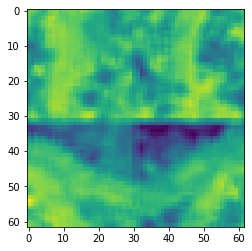

[[0.75033733 0.80595972 0.83688473 ... 0.634049   0.6528417  0.68156612]
 [0.70703321 0.78151367 0.81216651 ... 0.65056943 0.63444786 0.65843809]
 [0.68354513 0.78020112 0.8274387  ... 0.6837534  0.63122304 0.65562843]
 ...
 [0.67243013 0.70711751 0.75084548 ... 0.59742394 0.53931754 0.54816659]
 [0.68299696 0.7477342  0.80944131 ... 0.58297325 0.53772971 0.53212675]
 [0.73934256 0.79508186 0.84437336 ... 0.58323274 0.59584648 0.58359437]]


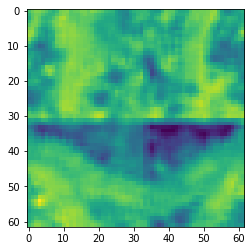

[[0.68156612 0.69155905 0.72482554 ... 0.55550627 0.54473212 0.59975386]
 [0.65843809 0.6450006  0.65816246 ... 0.60828382 0.59992731 0.63073077]
 [0.65562843 0.62357032 0.61437343 ... 0.67832083 0.71042323 0.69968484]
 ...
 [0.54816659 0.54176647 0.60060696 ... 0.75593535 0.69999782 0.6339375 ]
 [0.53212675 0.52545084 0.58931541 ... 0.70534677 0.63333106 0.62607294]
 [0.58359437 0.61688073 0.66674191 ... 0.67555572 0.61395174 0.62578558]]


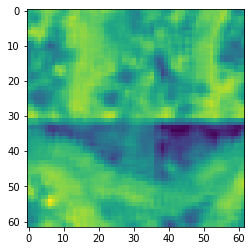

[[0.59975386 0.634049   0.6528417  ... 0.86107055 0.76388291 0.64090184]
 [0.63073077 0.65056943 0.63444786 ... 0.85266623 0.76632552 0.65759719]
 [0.69968484 0.6837534  0.63122304 ... 0.82280271 0.77079007 0.67292319]
 ...
 [0.6339375  0.59742394 0.53931754 ... 0.7507384  0.78468554 0.78573918]
 [0.62607294 0.58297325 0.53772971 ... 0.77139236 0.76992371 0.7172556 ]
 [0.62578558 0.58323274 0.59584648 ... 0.74399228 0.72159892 0.6630033 ]]


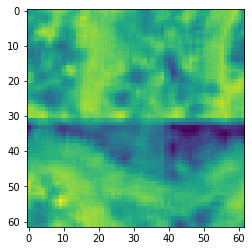

[[0.64090184 0.55550627 0.54473212 ... 0.81165699 0.82373518 0.85269116]
 [0.65759719 0.60828382 0.59992731 ... 0.8176553  0.8261141  0.87339008]
 [0.67292319 0.67832083 0.71042323 ... 0.82796332 0.83574567 0.87891085]
 ...
 [0.78573918 0.75593535 0.69999782 ... 0.68354003 0.72691626 0.73298341]
 [0.7172556  0.70534677 0.63333106 ... 0.73303569 0.76232721 0.75946632]
 [0.6630033  0.67555572 0.61395174 ... 0.73998624 0.76303716 0.7706497 ]]


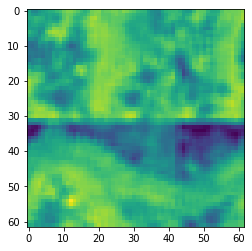

[[0.85269116 0.86107055 0.76388291 ... 0.81082802 0.80720812 0.81158404]
 [0.87339008 0.85266623 0.76632552 ... 0.80540524 0.8230409  0.80780573]
 [0.87891085 0.82280271 0.77079007 ... 0.80178065 0.82216534 0.7984824 ]
 ...
 [0.73298341 0.7507384  0.78468554 ... 0.65319654 0.68625261 0.70591998]
 [0.75946632 0.77139236 0.76992371 ... 0.68476965 0.7250955  0.72921756]
 [0.7706497  0.74399228 0.72159892 ... 0.73523701 0.73973179 0.7403353 ]]


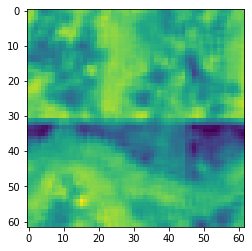

[[0.81158404 0.81165699 0.82373518 ... 0.66626595 0.68181362 0.76668299]
 [0.80780573 0.8176553  0.8261141  ... 0.68472263 0.71379642 0.78427879]
 [0.7984824  0.82796332 0.83574567 ... 0.65797686 0.74237379 0.79249293]
 ...
 [0.70591998 0.68354003 0.72691626 ... 0.44197328 0.48491251 0.59235727]
 [0.72921756 0.73303569 0.76232721 ... 0.42505301 0.48890167 0.59907662]
 [0.7403353  0.73998624 0.76303716 ... 0.50562574 0.59256574 0.67179712]]


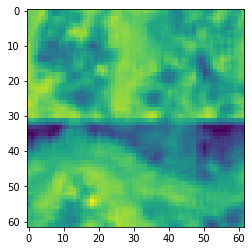

[[0.76668299 0.81082802 0.80720812 ... 0.7795354  0.70876987 0.66543556]
 [0.78427879 0.80540524 0.8230409  ... 0.75828599 0.68773509 0.67920886]
 [0.79249293 0.80178065 0.82216534 ... 0.72926126 0.63868058 0.64808495]
 ...
 [0.59235727 0.65319654 0.68625261 ... 0.49968176 0.42494722 0.40791075]
 [0.59907662 0.68476965 0.7250955  ... 0.52122653 0.43950846 0.39601012]
 [0.67179712 0.73523701 0.73973179 ... 0.58170603 0.51723112 0.47742446]]


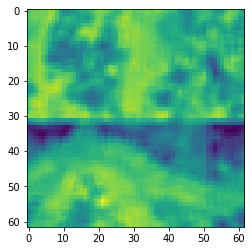

[[0.66543556 0.66626595 0.68181362 ... 0.72333937 0.80407659 0.78481176]
 [0.67920886 0.68472263 0.71379642 ... 0.78564546 0.82500966 0.78916308]
 [0.64808495 0.65797686 0.74237379 ... 0.80532556 0.83574383 0.78109446]
 ...
 [0.40791075 0.44197328 0.48491251 ... 0.58066632 0.61326099 0.55575745]
 [0.39601012 0.42505301 0.48890167 ... 0.46811781 0.54591719 0.53602582]
 [0.47742446 0.50562574 0.59256574 ... 0.39862834 0.4941123  0.5663997 ]]


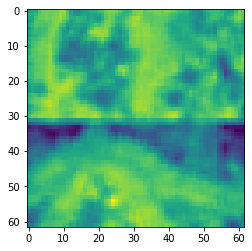

[[0.78481176 0.7795354  0.70876987 ... 0.63994407 0.62114111 0.63005963]
 [0.78916308 0.75828599 0.68773509 ... 0.64321797 0.67021466 0.69248016]
 [0.78109446 0.72926126 0.63868058 ... 0.64849112 0.70905508 0.74203809]
 ...
 [0.55575745 0.49968176 0.42494722 ... 0.58061026 0.55739514 0.56276433]
 [0.53602582 0.52122653 0.43950846 ... 0.54161684 0.47334274 0.43879468]
 [0.5663997  0.58170603 0.51723112 ... 0.53025124 0.43934282 0.35693508]]


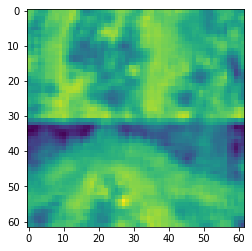

[[0.63005963 0.72333937 0.80407659 ... 0.71986205 0.72319511 0.69693487]
 [0.69248016 0.78564546 0.82500966 ... 0.74113171 0.71964705 0.71696229]
 [0.74203809 0.80532556 0.83574383 ... 0.74366715 0.71759877 0.68171364]
 ...
 [0.56276433 0.58066632 0.61326099 ... 0.69444519 0.68234975 0.64663465]
 [0.43879468 0.46811781 0.54591719 ... 0.74591496 0.73306183 0.66105516]
 [0.35693508 0.39862834 0.4941123  ... 0.74553377 0.74140803 0.65966971]]


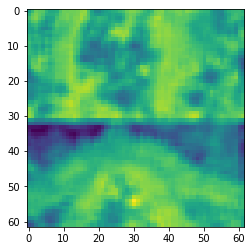

[[0.69693487 0.63994407 0.62114111 ... 0.64424705 0.69264231 0.71408663]
 [0.71696229 0.64321797 0.67021466 ... 0.61707338 0.66845775 0.71453156]
 [0.68171364 0.64849112 0.70905508 ... 0.60286824 0.68434191 0.73621828]
 ...
 [0.64663465 0.58061026 0.55739514 ... 0.72901124 0.71730762 0.7227252 ]
 [0.66105516 0.54161684 0.47334274 ... 0.69487934 0.70023686 0.75665877]
 [0.65966971 0.53025124 0.43934282 ... 0.69896033 0.72779755 0.76069079]]


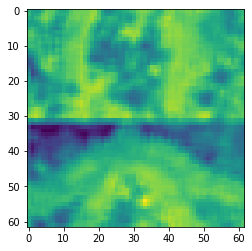

[[0.71408663 0.71986205 0.72319511 ... 0.57822207 0.55808815 0.5528882 ]
 [0.71453156 0.74113171 0.71964705 ... 0.58527613 0.55156518 0.52981793]
 [0.73621828 0.74366715 0.71759877 ... 0.59887798 0.5535656  0.55807264]
 ...
 [0.7227252  0.69444519 0.68234975 ... 0.68596245 0.68908814 0.74082572]
 [0.75665877 0.74591496 0.73306183 ... 0.65650326 0.64714522 0.67754656]
 [0.76069079 0.74553377 0.74140803 ... 0.60576068 0.59862522 0.64670797]]


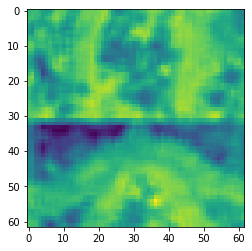

[[0.5528882  0.64424705 0.69264231 ... 0.71106349 0.70222439 0.63276458]
 [0.52981793 0.61707338 0.66845775 ... 0.67748808 0.68197324 0.62894556]
 [0.55807264 0.60286824 0.68434191 ... 0.66288265 0.66489333 0.63239606]
 ...
 [0.74082572 0.72901124 0.71730762 ... 0.7064337  0.67110216 0.66635898]
 [0.67754656 0.69487934 0.70023686 ... 0.69567502 0.67179544 0.65290918]
 [0.64670797 0.69896033 0.72779755 ... 0.70089884 0.68989718 0.63282606]]


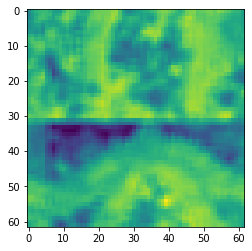

[[0.63276458 0.57822207 0.55808815 ... 0.79072719 0.77068651 0.72762652]
 [0.62894556 0.58527613 0.55156518 ... 0.73595932 0.71350243 0.68573083]
 [0.63239606 0.59887798 0.5535656  ... 0.72140854 0.69214289 0.66690295]
 ...
 [0.66635898 0.68596245 0.68908814 ... 0.65332845 0.68725518 0.68420012]
 [0.65290918 0.65650326 0.64714522 ... 0.73827866 0.7185751  0.69582711]
 [0.63282606 0.60576068 0.59862522 ... 0.7792596  0.7423111  0.70962766]]


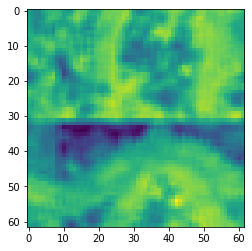

[[0.72762652 0.71106349 0.70222439 ... 0.7966334  0.84012586 0.82294702]
 [0.68573083 0.67748808 0.68197324 ... 0.78981686 0.79055994 0.75722035]
 [0.66690295 0.66288265 0.66489333 ... 0.77940954 0.78019617 0.75064337]
 ...
 [0.68420012 0.7064337  0.67110216 ... 0.79081775 0.73609106 0.68407285]
 [0.69582711 0.69567502 0.67179544 ... 0.81145409 0.79380623 0.76265686]
 [0.70962766 0.70089884 0.68989718 ... 0.81015699 0.82670067 0.80538794]]


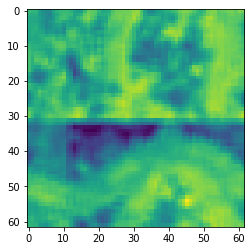

[[0.82294702 0.79072719 0.77068651 ... 0.7997157  0.8219161  0.82184536]
 [0.75722035 0.73595932 0.71350243 ... 0.77326803 0.798109   0.81462333]
 [0.75064337 0.72140854 0.69214289 ... 0.77425193 0.79077368 0.78770179]
 ...
 [0.68407285 0.65332845 0.68725518 ... 0.841363   0.83854392 0.81225376]
 [0.76265686 0.73827866 0.7185751  ... 0.8377939  0.83916836 0.82552154]
 [0.80538794 0.7792596  0.7423111  ... 0.84661181 0.84530488 0.8264123 ]]


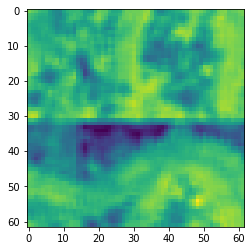

[[0.82184536 0.7966334  0.84012586 ... 0.83878638 0.78034901 0.79650876]
 [0.81462333 0.78981686 0.79055994 ... 0.82629481 0.77788209 0.77833849]
 [0.78770179 0.77940954 0.78019617 ... 0.83350391 0.79120757 0.78586541]
 ...
 [0.81225376 0.79081775 0.73609106 ... 0.87517434 0.86444664 0.86653262]
 [0.82552154 0.81145409 0.79380623 ... 0.87641527 0.8525175  0.86498177]
 [0.8264123  0.81015699 0.82670067 ... 0.89296557 0.85573712 0.87179573]]


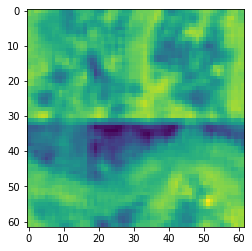

[[0.79650876 0.7997157  0.8219161  ... 0.72894671 0.8174972  0.83131069]
 [0.77833849 0.77326803 0.798109   ... 0.76606261 0.81749899 0.84363664]
 [0.78586541 0.77425193 0.79077368 ... 0.81959134 0.87771305 0.8886942 ]
 ...
 [0.86653262 0.841363   0.83854392 ... 0.86534145 0.86711693 0.89482389]
 [0.86498177 0.8377939  0.83916836 ... 0.82511879 0.834668   0.88426116]
 [0.87179573 0.84661181 0.84530488 ... 0.76222487 0.77474131 0.85297037]]


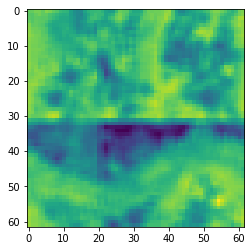

[[0.85297037 0.89296557 0.85573712 ... 0.78436804 0.76218232 0.71021659]
 [0.82617632 0.86591666 0.82900076 ... 0.8406337  0.76933845 0.70398362]
 [0.7991354  0.85723833 0.80805402 ... 0.83679101 0.76897399 0.70972369]
 ...
 [0.83651595 0.84497223 0.84661607 ... 0.7837547  0.77891007 0.77029517]
 [0.87287215 0.85840862 0.87320606 ... 0.75141795 0.77275846 0.76850497]
 [0.87290844 0.85208555 0.8719279  ... 0.76491677 0.79522034 0.7981953 ]]


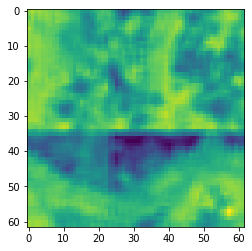

[[0.71021659 0.76222487 0.77474131 ... 0.84437336 0.84318807 0.80077424]
 [0.70398362 0.72236315 0.77891833 ... 0.85534741 0.87908283 0.86080953]
 [0.70972369 0.68458079 0.76538906 ... 0.84976285 0.87731061 0.86920239]
 ...
 [0.77029517 0.79821671 0.82245891 ... 0.78009525 0.83074505 0.79746568]
 [0.76850497 0.82833047 0.82886691 ... 0.69408603 0.70767279 0.72202335]
 [0.7981953  0.84804764 0.83469082 ... 0.70426856 0.70744127 0.73255951]]


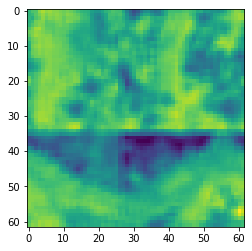

[[0.85465086 0.83714084 0.81346245 ... 0.71160075 0.78908602 0.8485755 ]
 [0.91872537 0.89719209 0.82110006 ... 0.77379823 0.8227804  0.87727971]
 [0.9276829  0.89309087 0.82071107 ... 0.82758479 0.84637797 0.88097242]
 ...
 [0.85111971 0.83648624 0.83131566 ... 0.66363264 0.71386323 0.77781582]
 [0.77060156 0.80197385 0.82475016 ... 0.63591196 0.67949067 0.7307141 ]
 [0.7818466  0.81638088 0.8487233  ... 0.66085432 0.71497564 0.73935752]]


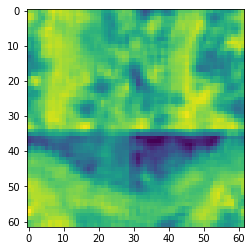

[[0.79508186 0.84437336 0.84318807 ... 0.59584648 0.58359437 0.61688073]
 [0.82197658 0.85534741 0.87908283 ... 0.64789241 0.66785535 0.69951649]
 [0.8254365  0.84976285 0.87731061 ... 0.66275638 0.70374837 0.73491998]
 ...
 [0.72878283 0.78009525 0.83074505 ... 0.58046131 0.56390107 0.61502242]
 [0.68465037 0.69408603 0.70767279 ... 0.60059113 0.57283237 0.58941796]
 [0.69274891 0.70426856 0.70744127 ... 0.55515111 0.55267983 0.5823273 ]]


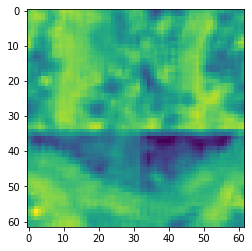

[[0.61688073 0.66674191 0.73934256 ... 0.61395174 0.62578558 0.58323274]
 [0.69951649 0.7250185  0.77091287 ... 0.51546174 0.56230809 0.57432053]
 [0.73491998 0.77541439 0.79302286 ... 0.47990652 0.52555734 0.58951195]
 ...
 [0.61502242 0.62179768 0.66886176 ... 0.80912696 0.7233764  0.65887766]
 [0.58941796 0.59582449 0.63665602 ... 0.73504841 0.64878591 0.62902503]
 [0.5823273  0.6191945  0.66990405 ... 0.68860192 0.62538424 0.5967556 ]]


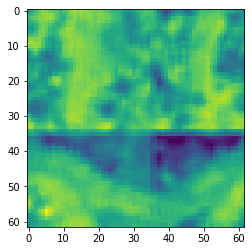

[[0.58323274 0.59584648 0.58359437 ... 0.72159892 0.6630033  0.67555572]
 [0.57432053 0.64789241 0.66785535 ... 0.70785087 0.59959361 0.55686374]
 [0.58951195 0.66275638 0.70374837 ... 0.72688313 0.6070066  0.51100156]
 ...
 [0.65887766 0.58046131 0.56390107 ... 0.83663286 0.80961229 0.81599742]
 [0.62902503 0.60059113 0.57283237 ... 0.79872065 0.78424718 0.75420763]
 [0.5967556  0.55515111 0.55267983 ... 0.79094024 0.77788172 0.71703624]]


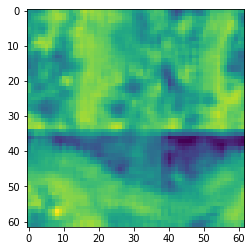

[[0.67555572 0.61395174 0.62578558 ... 0.76303716 0.7706497  0.74399228]
 [0.55686374 0.51546174 0.56230809 ... 0.80040499 0.8075729  0.74800542]
 [0.51100156 0.47990652 0.52555734 ... 0.8014438  0.8152019  0.79189985]
 ...
 [0.81599742 0.80912696 0.7233764  ... 0.79654631 0.81641606 0.83948149]
 [0.75420763 0.73504841 0.64878591 ... 0.77054946 0.78070164 0.79484904]
 [0.71703624 0.68860192 0.62538424 ... 0.74280931 0.7593442  0.76240773]]


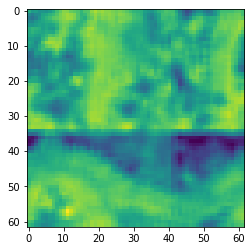

[[0.74399228 0.72159892 0.6630033  ... 0.73973179 0.7403353  0.73998624]
 [0.74800542 0.70785087 0.59959361 ... 0.76087197 0.78666587 0.78413926]
 [0.79189985 0.72688313 0.6070066  ... 0.770522   0.80093086 0.79412699]
 ...
 [0.83948149 0.83663286 0.80961229 ... 0.65493337 0.70945994 0.75083112]
 [0.79484904 0.79872065 0.78424718 ... 0.64762866 0.72075923 0.73029329]
 [0.76240773 0.79094024 0.77788172 ... 0.67937495 0.72781154 0.70387396]]


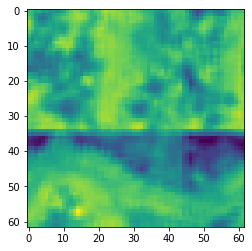

[[0.73998624 0.76303716 0.7706497  ... 0.59256574 0.67179712 0.73523701]
 [0.78413926 0.80040499 0.8075729  ... 0.59474629 0.68265342 0.76689352]
 [0.79412699 0.8014438  0.8152019  ... 0.69109466 0.72935746 0.78513579]
 ...
 [0.75083112 0.79654631 0.81641606 ... 0.59947475 0.60149489 0.64340767]
 [0.73029329 0.77054946 0.78070164 ... 0.49242196 0.53510192 0.59814867]
 [0.70387396 0.74280931 0.7593442  ... 0.49121722 0.58639057 0.64629664]]


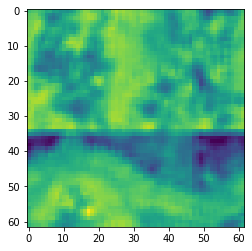

[[0.73523701 0.73973179 0.7403353  ... 0.51723112 0.47742446 0.50562574]
 [0.76689352 0.76087197 0.78666587 ... 0.59644451 0.54306998 0.53332628]
 [0.78513579 0.770522   0.80093086 ... 0.69373182 0.66737255 0.68216036]
 ...
 [0.64340767 0.65493337 0.70945994 ... 0.6380896  0.61799623 0.57939384]
 [0.59814867 0.64762866 0.72075923 ... 0.52328338 0.51110632 0.47994418]
 [0.64629664 0.67937495 0.72781154 ... 0.46153288 0.45287938 0.45040358]]


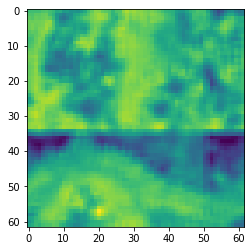

[[0.50562574 0.59256574 0.67179712 ... 0.4941123  0.5663997  0.58170603]
 [0.53332628 0.59474629 0.68265342 ... 0.59256864 0.66051451 0.66662815]
 [0.68216036 0.69109466 0.72935746 ... 0.70272144 0.74032651 0.75949904]
 ...
 [0.57939384 0.59947475 0.60149489 ... 0.69627189 0.69909039 0.67743265]
 [0.47994418 0.49242196 0.53510192 ... 0.70088412 0.67756365 0.61398987]
 [0.45040358 0.49121722 0.58639057 ... 0.68495924 0.6266471  0.54911699]]


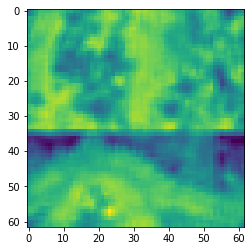

[[0.58170603 0.51723112 0.47742446 ... 0.43934282 0.35693508 0.39862834]
 [0.66662815 0.59644451 0.54306998 ... 0.46802014 0.40172929 0.47470184]
 [0.75949904 0.69373182 0.66737255 ... 0.52909194 0.49880578 0.58788672]
 ...
 [0.67743265 0.6380896  0.61799623 ... 0.70515754 0.69727157 0.70531058]
 [0.61398987 0.52328338 0.51110632 ... 0.70178108 0.70312609 0.72269033]
 [0.54911699 0.46153288 0.45287938 ... 0.66586172 0.67280412 0.70274117]]


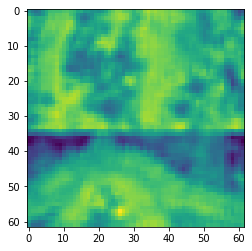

[[0.39862834 0.4941123  0.5663997  ... 0.74140803 0.65966971 0.53025124]
 [0.47470184 0.59256864 0.66051451 ... 0.75426175 0.69348895 0.57770614]
 [0.58788672 0.70272144 0.74032651 ... 0.73035525 0.68091313 0.60240411]
 ...
 [0.70531058 0.69627189 0.69909039 ... 0.72233333 0.72334826 0.7138791 ]
 [0.72269033 0.70088412 0.67756365 ... 0.69462027 0.68811917 0.71073247]
 [0.70274117 0.68495924 0.6266471  ... 0.69361953 0.68102946 0.68005476]]


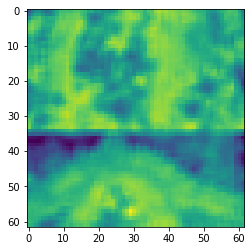

[[0.53025124 0.43934282 0.35693508 ... 0.72779755 0.76069079 0.74553377]
 [0.57770614 0.46802014 0.40172929 ... 0.74118356 0.74899195 0.73642161]
 [0.60240411 0.52909194 0.49880578 ... 0.73483788 0.73063067 0.71400805]
 ...
 [0.7138791  0.70515754 0.69727157 ... 0.74199491 0.72853512 0.74944551]
 [0.71073247 0.70178108 0.70312609 ... 0.69707935 0.68653319 0.66832379]
 [0.68005476 0.66586172 0.67280412 ... 0.71253998 0.70368868 0.67489015]]


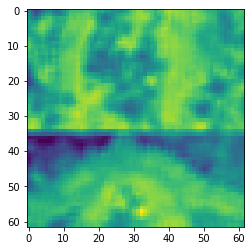

[[0.74553377 0.74140803 0.65966971 ... 0.59862522 0.64670797 0.69896033]
 [0.73642161 0.75426175 0.69348895 ... 0.54550907 0.60813582 0.66056647]
 [0.71400805 0.73035525 0.68091313 ... 0.52020592 0.58089852 0.64911887]
 ...
 [0.74944551 0.72233333 0.72334826 ... 0.69325875 0.71114675 0.70593281]
 [0.66832379 0.69462027 0.68811917 ... 0.67535739 0.69441963 0.67462077]
 [0.67489015 0.69361953 0.68102946 ... 0.6734692  0.72057421 0.70437459]]


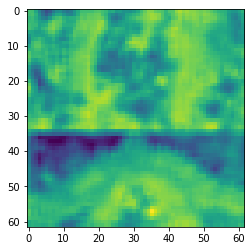

[[0.69896033 0.72779755 0.76069079 ... 0.68989718 0.63282606 0.60576068]
 [0.66056647 0.74118356 0.74899195 ... 0.69544902 0.61321507 0.56435542]
 [0.64911887 0.73483788 0.73063067 ... 0.71350974 0.62351536 0.55213513]
 ...
 [0.70593281 0.74199491 0.72853512 ... 0.63678156 0.67092019 0.6801337 ]
 [0.67462077 0.69707935 0.68653319 ... 0.63688401 0.66678277 0.68265663]
 [0.70437459 0.71253998 0.70368868 ... 0.65084486 0.66637081 0.67523311]]


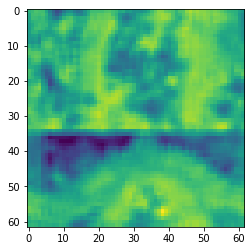

[[0.60576068 0.59862522 0.64670797 ... 0.7423111  0.70962766 0.70089884]
 [0.56435542 0.54550907 0.60813582 ... 0.78754901 0.74279858 0.71930172]
 [0.55213513 0.52020592 0.58089852 ... 0.80372159 0.74883954 0.73026131]
 ...
 [0.6801337  0.69325875 0.71114675 ... 0.64155362 0.6431385  0.63694029]
 [0.68265663 0.67535739 0.69441963 ... 0.63685177 0.6473365  0.65318261]
 [0.67523311 0.6734692  0.72057421 ... 0.65712685 0.64899917 0.67740503]]


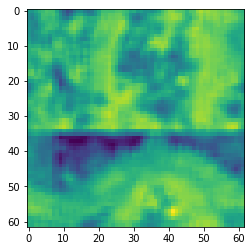

[[0.70089884 0.68989718 0.63282606 ... 0.82670067 0.80538794 0.7792596 ]
 [0.71930172 0.69544902 0.61321507 ... 0.84652797 0.83341003 0.8100781 ]
 [0.73026131 0.71350974 0.62351536 ... 0.82448846 0.82144729 0.81337236]
 ...
 [0.63694029 0.63678156 0.67092019 ... 0.65508583 0.63624301 0.63248616]
 [0.65318261 0.63688401 0.66678277 ... 0.64177913 0.60945038 0.60288991]
 [0.67740503 0.65084486 0.66637081 ... 0.67942228 0.64722622 0.61768766]]


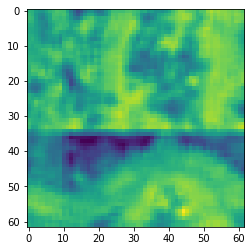

[[0.7792596  0.7423111  0.70962766 ... 0.84530488 0.8264123  0.81015699]
 [0.8100781  0.78754901 0.74279858 ... 0.855325   0.83657869 0.81640601]
 [0.81337236 0.80372159 0.74883954 ... 0.84613974 0.83268499 0.79797047]
 ...
 [0.63248616 0.64155362 0.6431385  ... 0.81775838 0.7623301  0.72181476]
 [0.60288991 0.63685177 0.6473365  ... 0.84794209 0.78694635 0.74295883]
 [0.61768766 0.65712685 0.64899917 ... 0.84828794 0.79536776 0.76347999]]


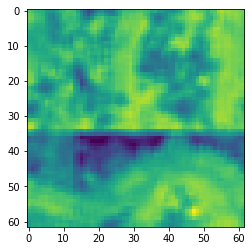

[[0.81015699 0.82670067 0.80538794 ... 0.85573712 0.87179573 0.84661181]
 [0.81640601 0.84652797 0.83341003 ... 0.82900076 0.85430434 0.84410597]
 [0.79797047 0.82448846 0.82144729 ... 0.80805402 0.83777018 0.82494065]
 ...
 [0.72181476 0.65508583 0.63624301 ... 0.84661607 0.84718907 0.83649118]
 [0.74295883 0.64177913 0.60945038 ... 0.87320606 0.87298633 0.85240674]
 [0.76347999 0.67942228 0.64722622 ... 0.8719279  0.8769696  0.84883306]]


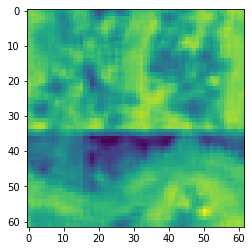

[[0.84661181 0.84530488 0.8264123  ... 0.77474131 0.85297037 0.89296557]
 [0.84410597 0.855325   0.83657869 ... 0.77891833 0.82617632 0.86591666]
 [0.82494065 0.84613974 0.83268499 ... 0.76538906 0.7991354  0.85723833]
 ...
 [0.83649118 0.81775838 0.7623301  ... 0.82245891 0.83651595 0.84497223]
 [0.85240674 0.84794209 0.78694635 ... 0.82886691 0.87287215 0.85840862]
 [0.84883306 0.84828794 0.79536776 ... 0.83469082 0.87290844 0.85208555]]


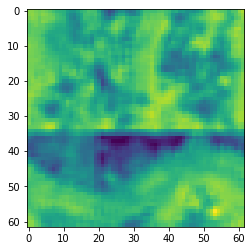

[[0.89296557 0.85573712 0.87179573 ... 0.76218232 0.71021659 0.76222487]
 [0.86591666 0.82900076 0.85430434 ... 0.76933845 0.70398362 0.72236315]
 [0.85723833 0.80805402 0.83777018 ... 0.76897399 0.70972369 0.68458079]
 ...
 [0.84497223 0.84661607 0.84718907 ... 0.77891007 0.77029517 0.79821671]
 [0.85840862 0.87320606 0.87298633 ... 0.77275846 0.76850497 0.82833047]
 [0.85208555 0.8719279  0.8769696  ... 0.79522034 0.7981953  0.84804764]]


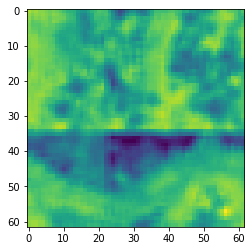

[[0.84804764 0.83469082 0.87290844 ... 0.70744127 0.73255951 0.76491677]
 [0.86534145 0.86711693 0.89482389 ... 0.73413624 0.7315886  0.73522649]
 [0.82511879 0.834668   0.88426116 ... 0.80466726 0.78197875 0.76751722]
 ...
 [0.82771413 0.79251639 0.79671981 ... 0.90090455 0.88490121 0.86969913]
 [0.82074302 0.8137353  0.8051843  ... 1.         0.93696066 0.87522531]
 [0.81108668 0.84016846 0.8131471  ... 0.95548866 0.893382   0.8370352 ]]


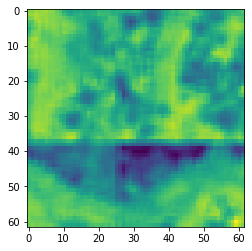

[[0.83425197 0.86730238 0.870547   ... 0.7306269  0.75554252 0.76810636]
 [0.80187044 0.84166362 0.87701921 ... 0.73338196 0.77121355 0.8189052 ]
 [0.83708814 0.83193761 0.8196939  ... 0.74490661 0.8155119  0.8828124 ]
 ...
 [0.94853223 0.92575608 0.91395851 ... 0.76782684 0.81340943 0.85089594]
 [0.95455933 0.91253449 0.89586506 ... 0.79307286 0.89047127 0.96303024]
 [0.91290751 0.86537388 0.86095458 ... 0.76382949 0.85330707 0.9364856 ]]


KeyboardInterrupt: ignored

In [ ]:
im_ind = 0
n_max_feature_maps = 5
feature_map_side = 62
# f_i, axes = plt.subplots(1,n_max_feature_maps,figsize=(10,1))
neuron_matrix = N_vgg_3D_block1[:,im_ind,:]
for f_i in range(n_max_feature_maps):
  neuron_matrix_fi =  neuron_matrix[(f_i * feature_map_side ** 2): ((f_i+1) * feature_map_side ** 2)]
  N_frames = 484
  feature_map_side = 62
  for t in range(N_frames):
    neuron_matrix_fi_t = neuron_matrix_fi[:, t].reshape((feature_map_side, feature_map_side))
    print(neuron_matrix_fi_t)
    vmin = neuron_matrix_fi_t.min()
    vmax = neuron_matrix_fi_t.max()
    plt.imshow(neuron_matrix_fi_t, vmin = vmin, vmax = vmax)
    # plt.set(xticks = [], yticks = [])
    plt.show()

In [ ]:
## pick the central neurons (15,15)

Rank-30 models:  min obj, 0.36;  max obj, 0.36;  time to fit, 325.3s


[0.3562246897342688]
[0.3562246897342688]
[30]


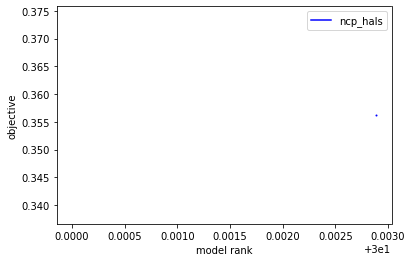

In [ ]:
ensembles = get_tensor_factors(N_vgg_3D_block1, ranks = [30])

In [ ]:
rep = 0
ranks = [30]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]

In [ ]:
tensor_factors_best_rank[0].shape

(13520, 30)

In [ ]:
tensor_factors_best_rank[2].shape

(507, 30)

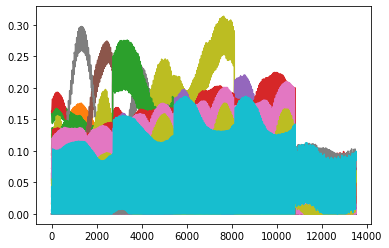

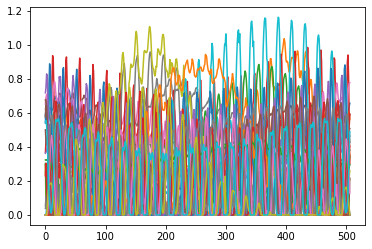

(13520, 30)


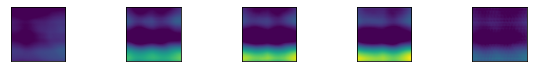

(13520, 30)


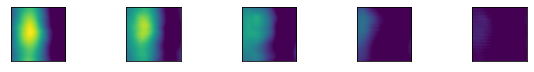

(13520, 30)


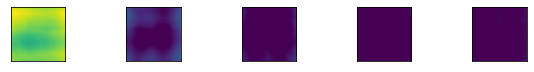

(13520, 30)


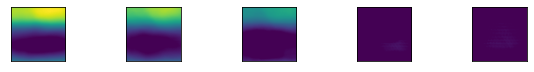

(13520, 30)


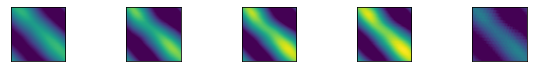

(13520, 30)


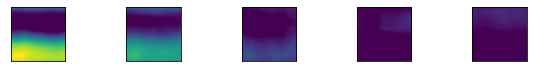

(13520, 30)


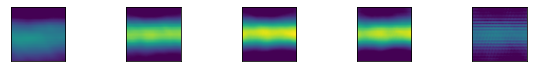

(13520, 30)


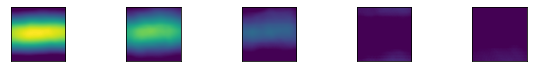

(13520, 30)


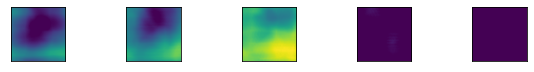

(13520, 30)


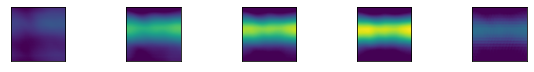

(13520, 30)


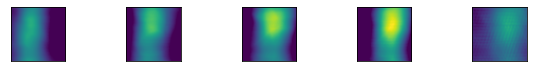

(13520, 30)


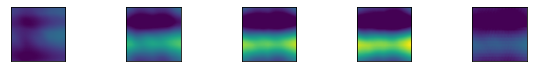

(13520, 30)


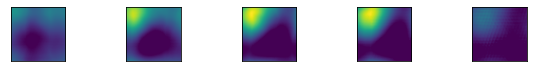

(13520, 30)


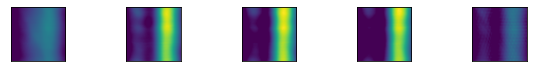

(13520, 30)


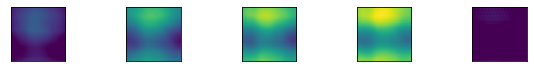

(13520, 30)


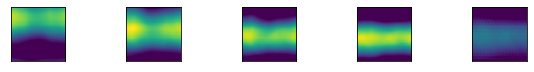

(13520, 30)


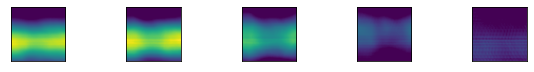

(13520, 30)


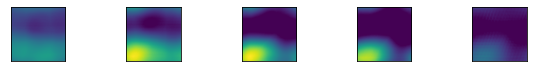

(13520, 30)


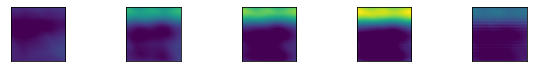

(13520, 30)


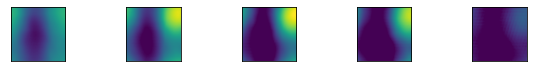

(13520, 30)


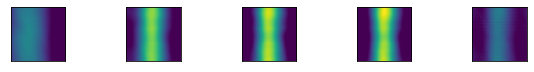

(13520, 30)


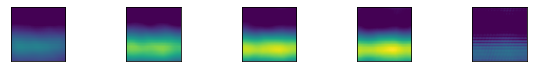

(13520, 30)


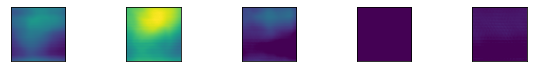

(13520, 30)


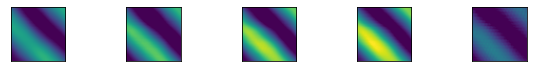

(13520, 30)


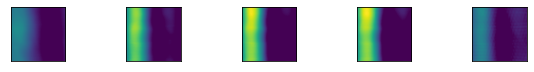

(13520, 30)


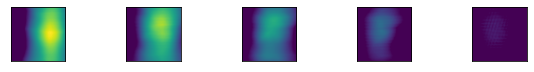

(13520, 30)


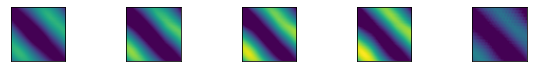

(13520, 30)


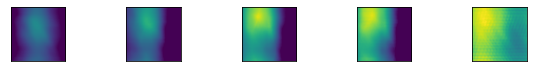

(13520, 30)


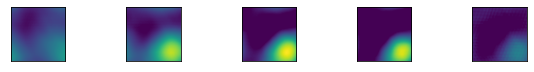

(13520, 30)


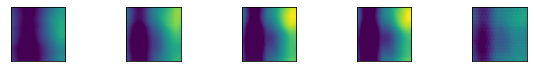

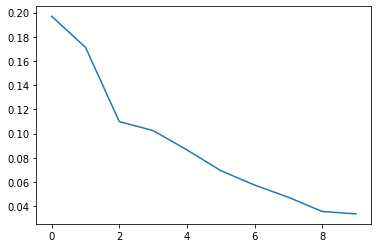

(13520, 10)
(13520,)
0 2704
(13520,)
1 2704
(13520,)
2 2704
(13520,)
3 2704
(13520,)
4 2704


0 0
1 2704
2 0
3 0
4 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



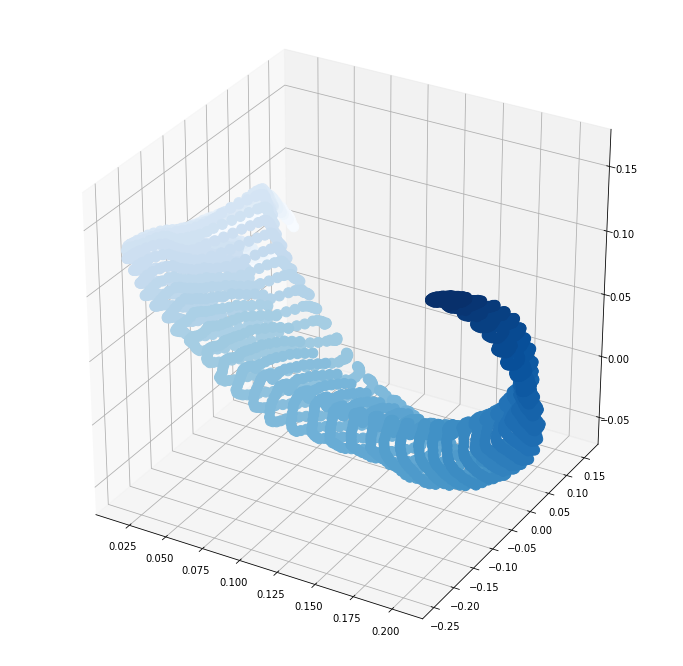

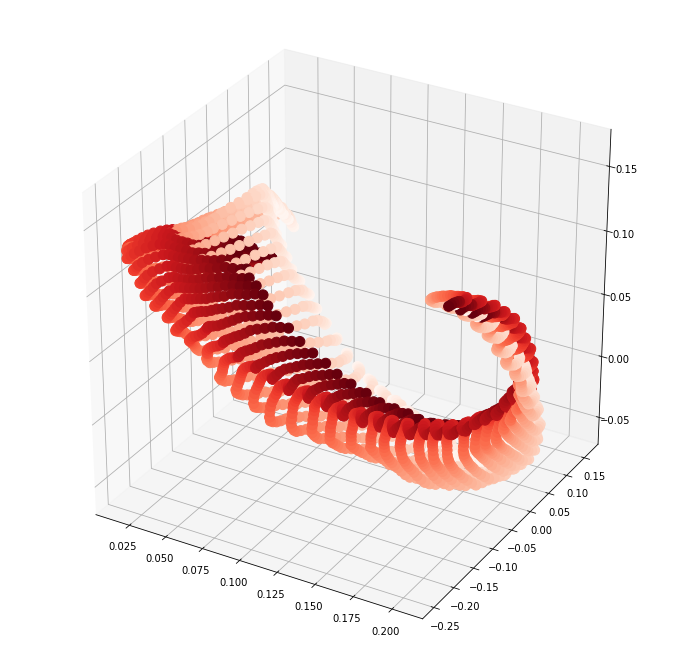

In [ ]:
get_tensor_factors_plot(tensor_factors_best_rank, best_rank=30, n_max_feature_maps=5)
neuron_output_highest_with_shifts_PCA = get_embeddings(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 10)
get_spatial_order_plot(1, neuron_output_highest_with_shifts_PCA, neuron_labels)

Fitting rank-30 models:   0%|          | 0/1 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/tensortools/optimize/ncp_hals.py:185: NumbaPerformanceWarning: '@' is faster on contiguous arrays, called on (array(float64, 2d, C), array(float64, 1d, A))
  Cp = factors[:, idx] @ grams[idx][:, p]
/usr/local/lib/python3.7/dist-packages/numba/core/typing/npydecl.py:930: NumbaPerformanceWarning: '@' is faster on contiguous arrays, called on (array(float64, 2d, C), array(float64, 1d, A))
  warnings.warn(NumbaPerformanceWarning(msg))
                                                                     

Rank-30 models:  min obj, 0.58;  max obj, 0.58;  time to fit, 23.5s


[0.5810685734825345]
[0.5810685734825345]
[30]


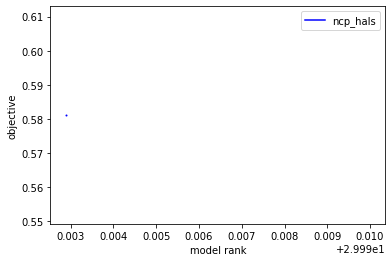

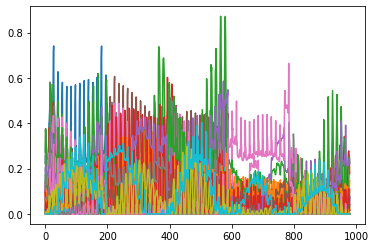

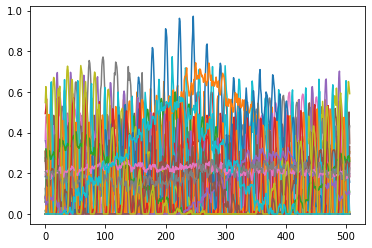

(980, 30)


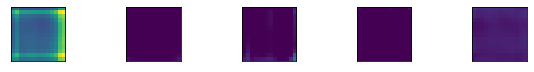

(980, 30)


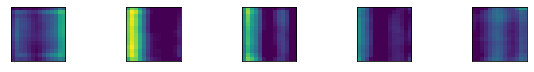

(980, 30)


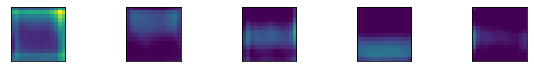

(980, 30)


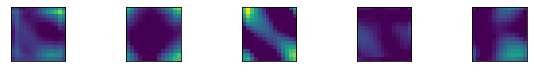

(980, 30)


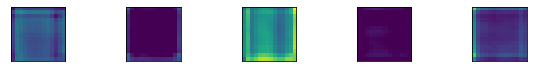

(980, 30)


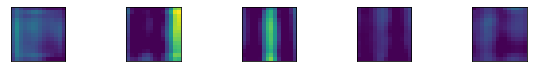

(980, 30)


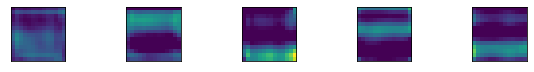

(980, 30)


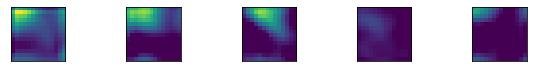

(980, 30)


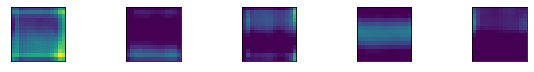

(980, 30)


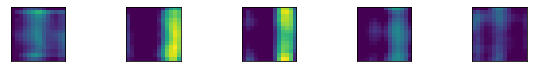

(980, 30)


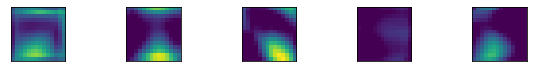

(980, 30)


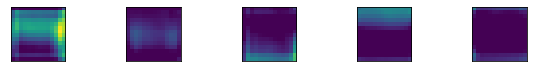

(980, 30)


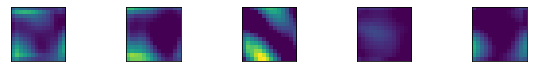

(980, 30)


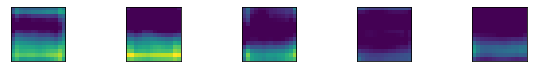

(980, 30)


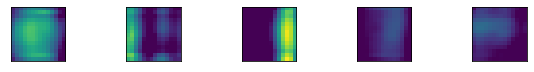

(980, 30)


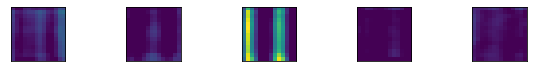

(980, 30)


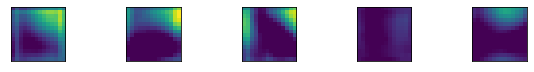

(980, 30)


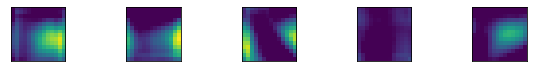

(980, 30)


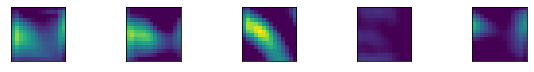

(980, 30)


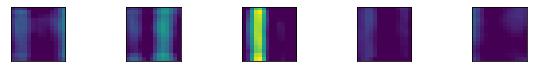

(980, 30)


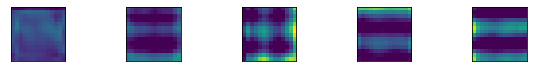

(980, 30)


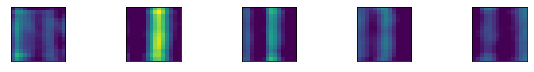

(980, 30)


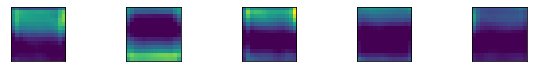

(980, 30)


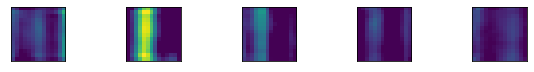

(980, 30)


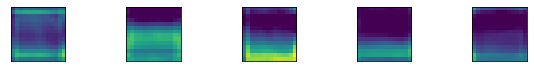

(980, 30)


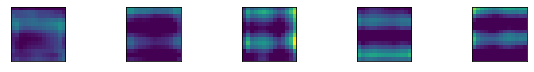

(980, 30)


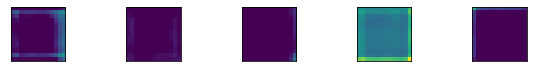

(980, 30)


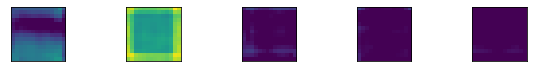

(980, 30)


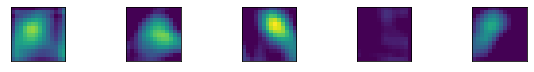

(980, 30)


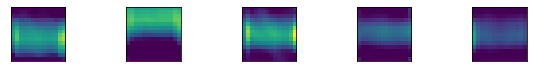

NameError: ignored

In [ ]:
ensembles = get_tensor_factors(N_vgg_3D_block3, ranks = [30])
rep = 0
ranks = [30]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles['ncp_hals'].results[rank][rep].factors)
tensor_factors_best_rank = tensor_factors[0]
get_tensor_factors_plot(tensor_factors_best_rank, best_rank=30, n_max_feature_maps=5)

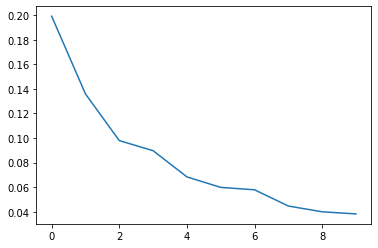

(980, 10)
(980,)
0 196
(980,)
1 196
(980,)
2 196
(980,)
3 196
(980,)
4 196


0 0
1 196
2 0
3 0
4 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



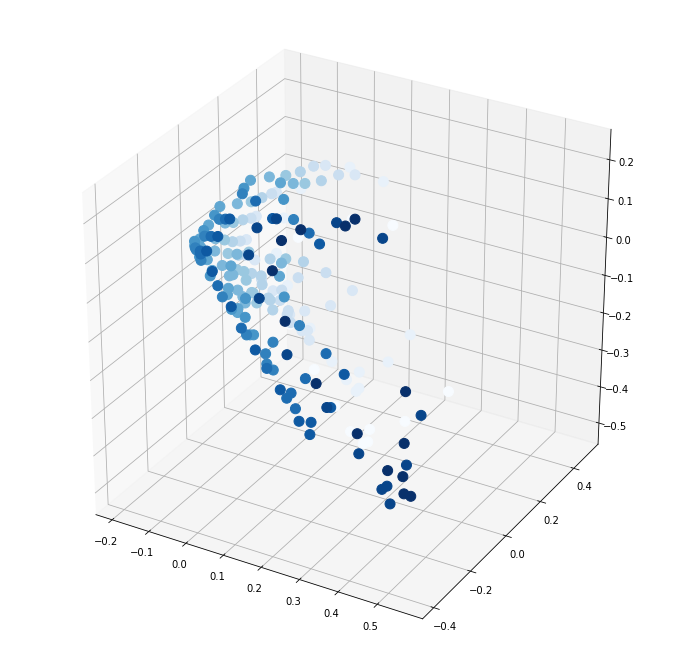

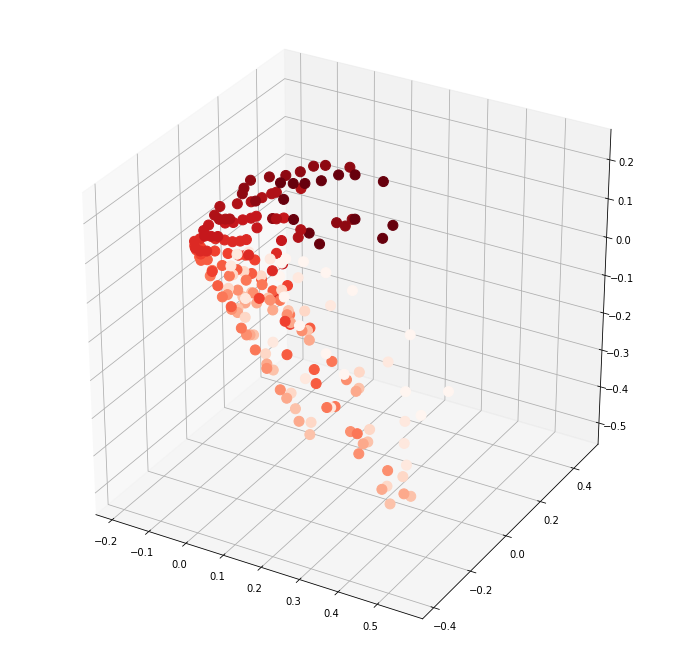

In [ ]:
neuron_labels = []
n_max_feature_maps = 5
for i in range(n_max_feature_maps):
  neuron_labels += [i] * 196
neuron_labels = np.array(neuron_labels) 

neuron_output_highest_with_shifts_PCA = get_embeddings(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 10)
get_spatial_order_plot(1, neuron_output_highest_with_shifts_PCA, neuron_labels)

In [ ]:
neuron_output_highest_with_shifts.shape

(20, 507, 13520)

In [ ]:
fm_avg_all_layers_with_shifts.shape

(20, 64)

## 2D:

In [ ]:
N_vgg_2D_block1.shape

(13520, 20)

Rank-1 models:  min obj, 0.22;  max obj, 0.22;  time to fit, 0.0s


Rank-2 models:  min obj, 0.11;  max obj, 0.11;  time to fit, 0.1s


Rank-3 models:  min obj, 0.06;  max obj, 0.06;  time to fit, 0.6s


Rank-4 models:  min obj, 0.04;  max obj, 0.04;  time to fit, 1.2s


Rank-5 models:  min obj, 0.01;  max obj, 0.01;  time to fit, 0.7s


[0.01184516641359672]
[0.22415877206814108, 0.1088783277172034, 0.06486306250607807, 0.03883110829526808, 0.01184516641359672]
[1, 2, 3, 4, 5]


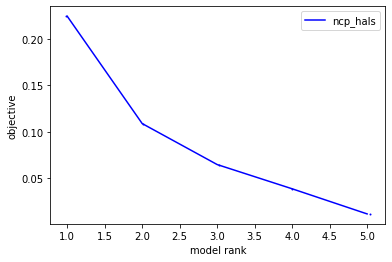

In [ ]:
ensembles_2D = get_tensor_factors(N_vgg_2D_block1, dim =2, ranks=[1,2,3,4,5])

In [ ]:
rep = 0
ranks=[1,2,3,4,5]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_2D['ncp_hals'].results[rank][rep].factors)
best_rank = 3
best_rank_ind = 2
tensor_factors_best_rank = tensor_factors[best_rank_ind]

neuron_labels = []
n_max_feature_maps = 5
for i in range(n_max_feature_maps):
  neuron_labels += [i] * 2704
neuron_labels = np.array(neuron_labels)

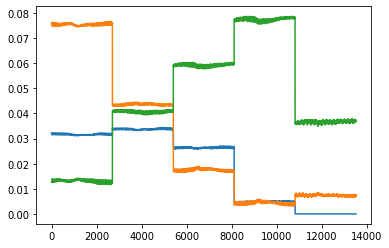

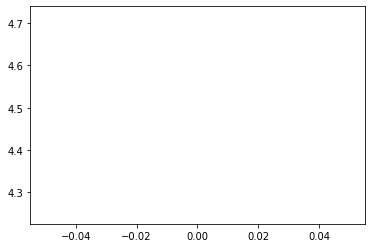

(13520, 3)


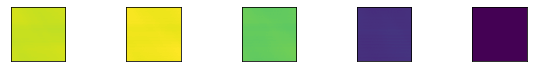

(13520, 3)


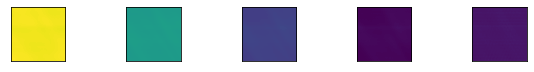

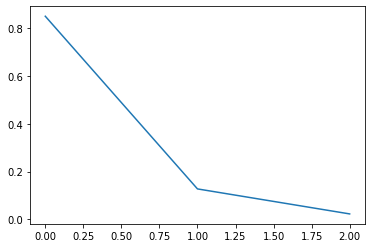

(13520, 3)
(13520,)
0 2704
(13520,)
1 2704
(13520,)
2 2704
(13520,)
3 2704
(13520,)
4 2704


0 0
1 2704
2 0
3 0
4 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



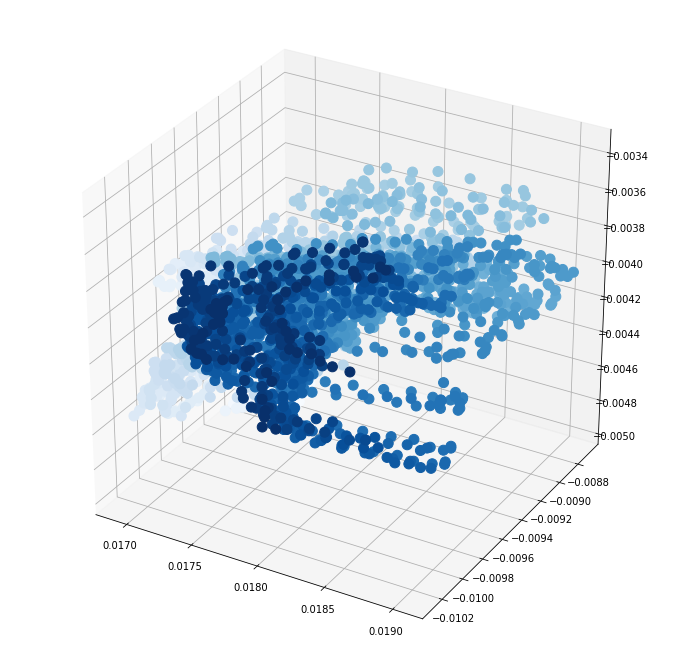

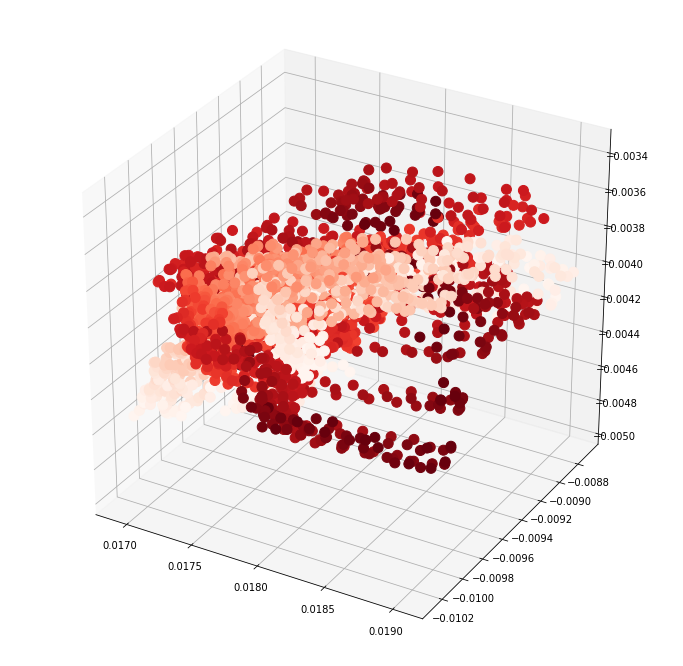

In [ ]:
get_tensor_factors_plot(tensor_factors_best_rank, best_rank=2, n_max_feature_maps=5)
neuron_output_highest_with_shifts_PCA = get_embeddings(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 3)
get_spatial_order_plot(1, neuron_output_highest_with_shifts_PCA, neuron_labels)

Rank-1 models:  min obj, 0.24;  max obj, 0.24;  time to fit, 0.0s


Rank-2 models:  min obj, 0.15;  max obj, 0.15;  time to fit, 0.0s


Rank-3 models:  min obj, 0.12;  max obj, 0.12;  time to fit, 0.1s


Rank-4 models:  min obj, 0.09;  max obj, 0.09;  time to fit, 0.1s


Rank-5 models:  min obj, 0.07;  max obj, 0.07;  time to fit, 0.1s


[0.06886966164188059]
[0.23887574383114515, 0.15354233936081443, 0.11527888158319224, 0.08573692685225308, 0.06886966164188059]
[1, 2, 3, 4, 5]


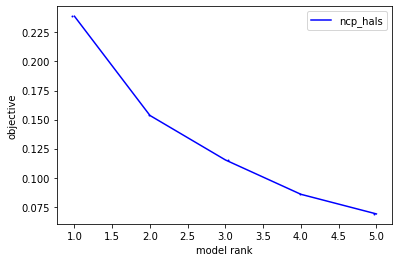

In [ ]:
ensembles_2D = get_tensor_factors(N_vgg_2D_block3, dim =2, ranks=[1,2,3,4,5])

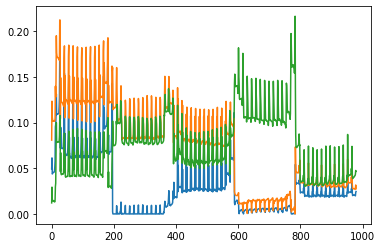

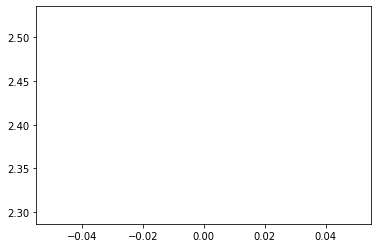

(980, 3)


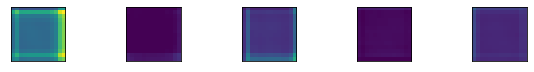

(980, 3)


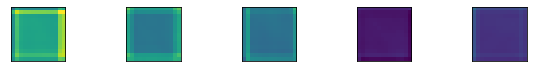

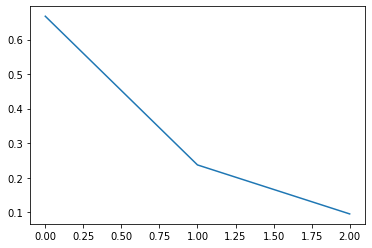

(980, 3)
(980,)
0 196
(980,)
1 196
(980,)
2 196
(980,)
3 196
(980,)
4 196


0 0
1 196
2 0
3 0
4 0


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: DeprecationWarning:

`np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



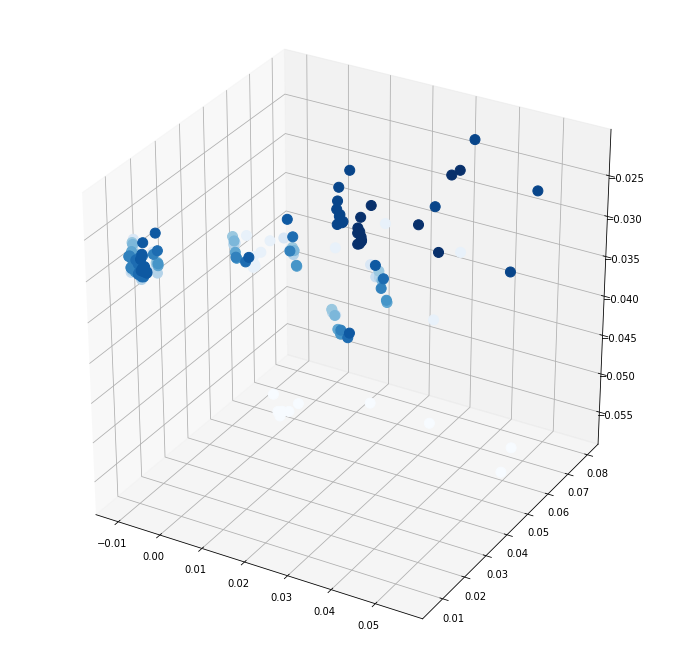

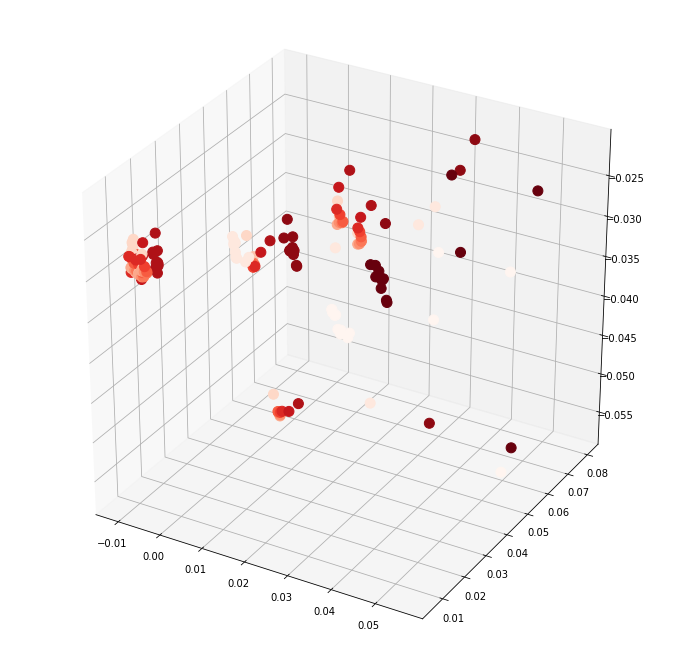

In [ ]:
rep = 0
ranks=[1,2,3,4,5]
tensor_factors = []
for rank in ranks:
  tensor_factors.append(ensembles_2D['ncp_hals'].results[rank][rep].factors)
best_rank = 3
best_rank_ind = 2
tensor_factors_best_rank = tensor_factors[best_rank_ind]
get_tensor_factors_plot(tensor_factors_best_rank, best_rank=2, n_max_feature_maps=5)
neuron_output_highest_with_shifts_PCA = get_embeddings(tensor_factors_best_rank, neuron_labels, n_dim_PCA = 3)
get_spatial_order_plot(1, neuron_output_highest_with_shifts_PCA, neuron_labels)